In [2]:
import numpy as np
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
from warnings import filterwarnings
filterwarnings('ignore')

In [3]:
print('Numpy Version',np.__version__)
print('Pandas Version',pd.__version__)
print('Seaborn Version',sns.__version__)
print('Matplotlib Version',matplotlib.__version__)

Numpy Version 1.24.4
Pandas Version 1.4.4
Seaborn Version 0.13.0
Matplotlib Version 3.5.2


## Reading dataset - Preliminary info

In [4]:
inscost=pd.read_csv('Data.csv')

In [5]:
pd.options.display.max_columns = None

In [6]:
inscost.head()

,applicant_id,years_of_insurance_with_us,regular_checkup_lasy_year,adventure_sports,Occupation,visited_doctor_last_1_year,cholesterol_level,daily_avg_steps,age,heart_decs_history,other_major_decs_history,Gender,avg_glucose_level,bmi,smoking_status,Year_last_admitted,Location,weight,covered_by_any_other_company,Alcohol,exercise,weight_change_in_last_one_year,fat_percentage,insurance_cost
0,5000,3,1,1,Salried,2,125 to 150,4866,28,1,0,Male,97,31.2,Unknown,NaN,Chennai,67,N,Rare,Moderate,1,25,20978
1,5001,0,0,0,Student,4,150 to 175,6411,50,0,0,Male,212,34.2,formerly smoked,NaN,Jaipur,58,N,Rare,Moderate,3,27,6170
2,5002,1,0,0,Business,4,200 to 225,4509,68,0,0,Female,166,40.4,formerly smoked,NaN,Jaipur,73,N,Daily,Extreme,0,32,28382
3,5003,7,4,0,Business,2,175 to 200,6214,51,0,0,Female,109,22.9,Unknown,NaN,Chennai,71,Y,Rare,No,3,37,27148
4,5004,3,1,0,Student,2,150 to 175,4938,44,0,1,Male,118,26.5,never smoked,2004.0,Bangalore,74,N,No,Extreme,0,34,29616


In [7]:
inscost.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25000 entries, 0 to 24999
Data columns (total 24 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   applicant_id                    25000 non-null  int64  
 1   years_of_insurance_with_us      25000 non-null  int64  
 2   regular_checkup_lasy_year       25000 non-null  int64  
 3   adventure_sports                25000 non-null  int64  
 4   Occupation                      25000 non-null  object 
 5   visited_doctor_last_1_year      25000 non-null  int64  
 6   cholesterol_level               25000 non-null  object 
 7   daily_avg_steps                 25000 non-null  int64  
 8   age                             25000 non-null  int64  
 9   heart_decs_history              25000 non-null  int64  
 10  other_major_decs_history        25000 non-null  int64  
 11  Gender                          25000 non-null  object 
 12  avg_glucose_level               

In [8]:
inscost.rename(columns={'regular_checkup_lasy_year':'regular_checkup_last_year'},inplace=True)

In [9]:
inscost.describe().round(2).T

,count,mean,std,min,25%,50%,75%,max
applicant_id,25000.0,17499.50,7217.02,5000.0,11249.75,17499.5,23749.25,29999.0
years_of_insurance_with_us,25000.0,4.09,2.61,0.0,2.00,4.0,6.00,8.0
regular_checkup_last_year,25000.0,0.77,1.20,0.0,0.00,0.0,1.00,5.0
adventure_sports,25000.0,0.08,0.27,0.0,0.00,0.0,0.00,1.0
visited_doctor_last_1_year,25000.0,3.10,1.14,0.0,2.00,3.0,4.00,12.0
daily_avg_steps,25000.0,5215.89,1053.18,2034.0,4543.00,5089.0,5730.00,11255.0
age,25000.0,44.92,16.11,16.0,31.00,45.0,59.00,74.0
heart_decs_history,25000.0,0.05,0.23,0.0,0.00,0.0,0.00,1.0
other_major_decs_history,25000.0,0.10,0.30,0.0,0.00,0.0,0.00,1.0
avg_glucose_level,25000.0,167.53,62.73,57.0,113.00,168.0,222.00,277.0


In [11]:
inscost_df=pd.DataFrame(inscost.copy())

In [12]:
inscost_df[['years_of_insurance_with_us',
 'regular_checkup_last_year',
 'adventure_sports',
  'visited_doctor_last_1_year',
  'heart_decs_history',
 'other_major_decs_history',
  'covered_by_any_other_company',
  'weight_change_in_last_one_year']]=inscost_df[['years_of_insurance_with_us',
 'regular_checkup_last_year',
 'adventure_sports',
  'visited_doctor_last_1_year',
  'heart_decs_history',
 'other_major_decs_history',
  'covered_by_any_other_company',
  'weight_change_in_last_one_year']].astype('object')

In [13]:
inscost_df.describe(include='object').T

,count,unique,top,freq
years_of_insurance_with_us,25000,9,3,2990
regular_checkup_last_year,25000,6,0,15215
adventure_sports,25000,2,0,22957
Occupation,25000,3,Student,10169
visited_doctor_last_1_year,25000,12,2,8669
cholesterol_level,25000,5,150 to 175,8763
heart_decs_history,25000,2,0,23634
other_major_decs_history,25000,2,0,22546
Gender,25000,2,Male,16422
smoking_status,25000,4,never smoked,9249


In [10]:
inscost.shape

(25000, 24)

In [11]:
inscost.skew()

applicant_id                      0.000000
years_of_insurance_with_us       -0.075217
regular_checkup_last_year         1.610907
adventure_sports                  3.054017
visited_doctor_last_1_year        0.978456
daily_avg_steps                   0.908867
age                               0.013860
heart_decs_history                3.919343
other_major_decs_history          2.701327
avg_glucose_level                -0.006389
bmi                               1.056428
Year_last_admitted                0.013532
weight                            0.109077
weight_change_in_last_one_year    0.068026
fat_percentage                   -0.363262
insurance_cost                    0.331650
dtype: float64

In [12]:
inscost.duplicated().value_counts()

False    25000
dtype: int64

## Missing Value Treatment

### Identification and significance evaluation

In [13]:
## Missing Value Check
inscost.isna().sum()

applicant_id                          0
years_of_insurance_with_us            0
regular_checkup_last_year             0
adventure_sports                      0
Occupation                            0
visited_doctor_last_1_year            0
cholesterol_level                     0
daily_avg_steps                       0
age                                   0
heart_decs_history                    0
other_major_decs_history              0
Gender                                0
avg_glucose_level                     0
bmi                                 990
smoking_status                        0
Year_last_admitted                11881
Location                              0
weight                                0
covered_by_any_other_company          0
Alcohol                               0
exercise                              0
weight_change_in_last_one_year        0
fat_percentage                        0
insurance_cost                        0
dtype: int64

In [14]:
# Identifying fields with missing values
inscost_null=inscost.isna().sum()
inscost_null[inscost_null.values > 0].sort_values(ascending=False)

Year_last_admitted    11881
bmi                     990
dtype: int64

In [15]:
#Determining the percentage of missing values
(11881/25000)*100

47.524

In [16]:
(990/25000)*100

3.9600000000000004

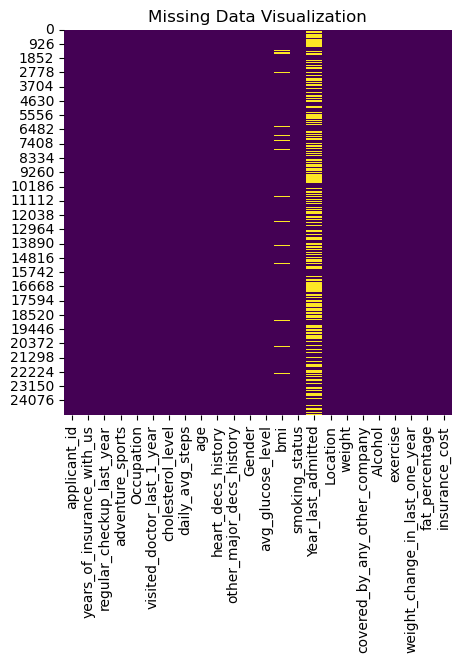

In [17]:
plt.figure(figsize=(5,5))
sns.heatmap(inscost.isnull(), cbar=False, cmap='viridis')
plt.title('Missing Data Visualization')
plt.show()

Observations:
- bmi and Year_last_admitted field have missing values
- Year_last_has about 47.5% missing values
- bmi has 3.96% missing values

In [18]:
# Data description before handling missing values
inscost.describe().round(2).T

,count,mean,std,min,25%,50%,75%,max
applicant_id,25000.0,17499.50,7217.02,5000.0,11249.75,17499.5,23749.25,29999.0
years_of_insurance_with_us,25000.0,4.09,2.61,0.0,2.00,4.0,6.00,8.0
regular_checkup_last_year,25000.0,0.77,1.20,0.0,0.00,0.0,1.00,5.0
adventure_sports,25000.0,0.08,0.27,0.0,0.00,0.0,0.00,1.0
visited_doctor_last_1_year,25000.0,3.10,1.14,0.0,2.00,3.0,4.00,12.0
daily_avg_steps,25000.0,5215.89,1053.18,2034.0,4543.00,5089.0,5730.00,11255.0
age,25000.0,44.92,16.11,16.0,31.00,45.0,59.00,74.0
heart_decs_history,25000.0,0.05,0.23,0.0,0.00,0.0,0.00,1.0
other_major_decs_history,25000.0,0.10,0.30,0.0,0.00,0.0,0.00,1.0
avg_glucose_level,25000.0,167.53,62.73,57.0,113.00,168.0,222.00,277.0


In [19]:
inscost.describe(include='object').T

,count,unique,top,freq
Occupation,25000,3,Student,10169
cholesterol_level,25000,5,150 to 175,8763
Gender,25000,2,Male,16422
smoking_status,25000,4,never smoked,9249
Location,25000,15,Bangalore,1742
covered_by_any_other_company,25000,2,N,17418
Alcohol,25000,3,Rare,13752
exercise,25000,3,Moderate,14638


In [20]:
inscost.shape

(25000, 24)

In [21]:
inscost.insurance_cost.nunique()

54

In [22]:
# Analyzing target variable
inscost.insurance_cost.describe()

count    25000.000000
mean     27147.407680
std      14323.691832
min       2468.000000
25%      16042.000000
50%      27148.000000
75%      37020.000000
max      67870.000000
Name: insurance_cost, dtype: float64

<AxesSubplot:xlabel='insurance_cost'>

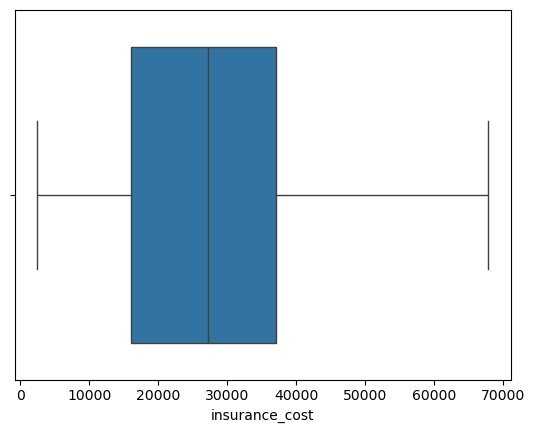

In [23]:
sns.boxplot(x=inscost.insurance_cost)

<AxesSubplot:ylabel='Density'>

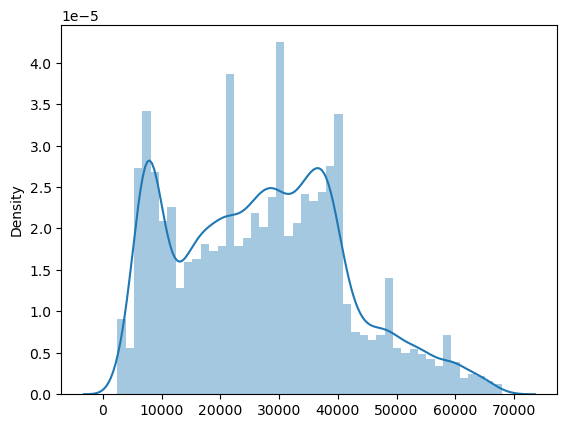

In [24]:
sns.distplot(x=inscost.insurance_cost)

Observations:
- The target variable here is insurance_cost
- It has 54 unique values, ranging from 2468 to 67870 with a median value of 27140

Text(0.5, 1.0, 'Boxplot of insurance cost where Year_last_admitted is not null')

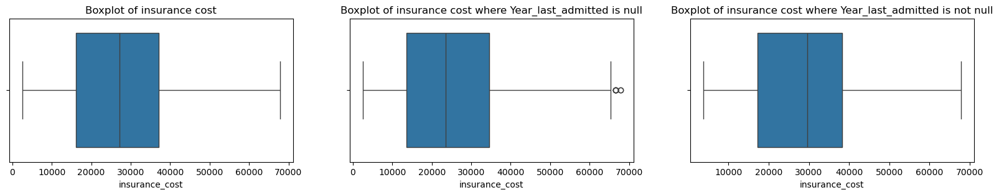

In [25]:
#Comparing target variable with and without 
fig,axes=plt.subplots(ncols=3,figsize=(20,3))
sns.boxplot(x=inscost['insurance_cost'],ax=axes[0])
axes[0].set_title('Boxplot of insurance cost')
sns.boxplot(x=inscost[inscost['Year_last_admitted'].isnull()==True].insurance_cost,ax=axes[1])
axes[1].set_title('Boxplot of insurance cost where Year_last_admitted is null')
sns.boxplot(x=inscost[inscost['Year_last_admitted'].isnull()==False].insurance_cost,ax=axes[2])
axes[2].set_title('Boxplot of insurance cost where Year_last_admitted is not null')

In [26]:
inscost[inscost['Year_last_admitted'].isnull()==True].insurance_cost.describe().round(2).T

count    11881.00
mean     24677.20
std      13622.31
min       2468.00
25%      13574.00
50%      23446.00
75%      34552.00
max      67870.00
Name: insurance_cost, dtype: float64

In [27]:
inscost[inscost['Year_last_admitted'].isnull()==False].insurance_cost.describe().round(2).T

count    13119.00
mean     29384.51
std      14574.06
min       3702.00
25%      17276.00
50%      29616.00
75%      38254.00
max      67870.00
Name: insurance_cost, dtype: float64

In [28]:
inscost['insurance_cost'].describe().round(2).T

count    25000.00
mean     27147.41
std      14323.69
min       2468.00
25%      16042.00
50%      27148.00
75%      37020.00
max      67870.00
Name: insurance_cost, dtype: float64

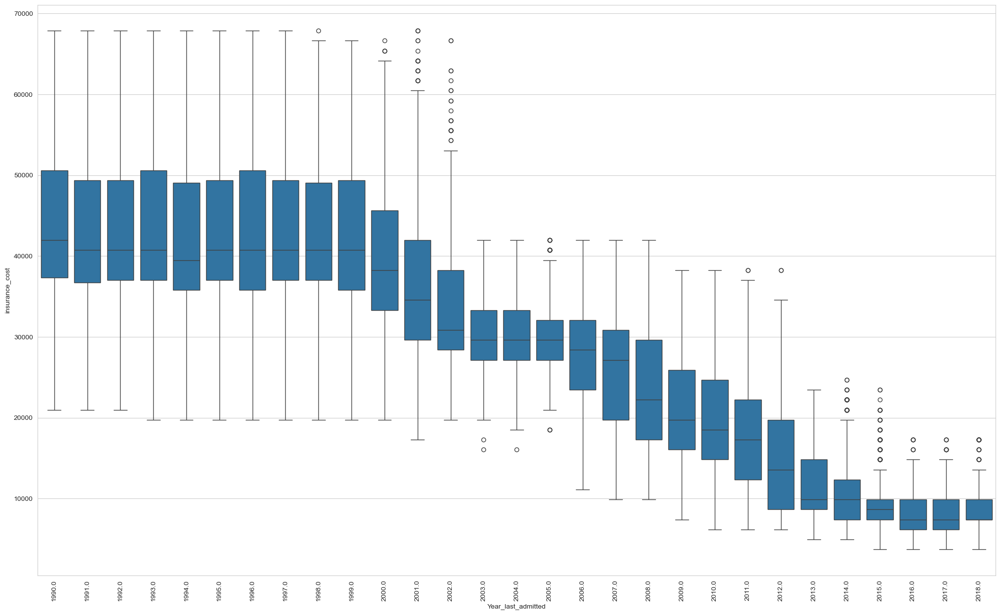

In [29]:
plt.figure(figsize=(25,15))
sns.set_style('whitegrid')
sns.boxplot(x=inscost['Year_last_admitted'],y=inscost['insurance_cost'])
plt.xticks(rotation=90);

<AxesSubplot:xlabel='Year_last_admitted', ylabel='insurance_cost'>

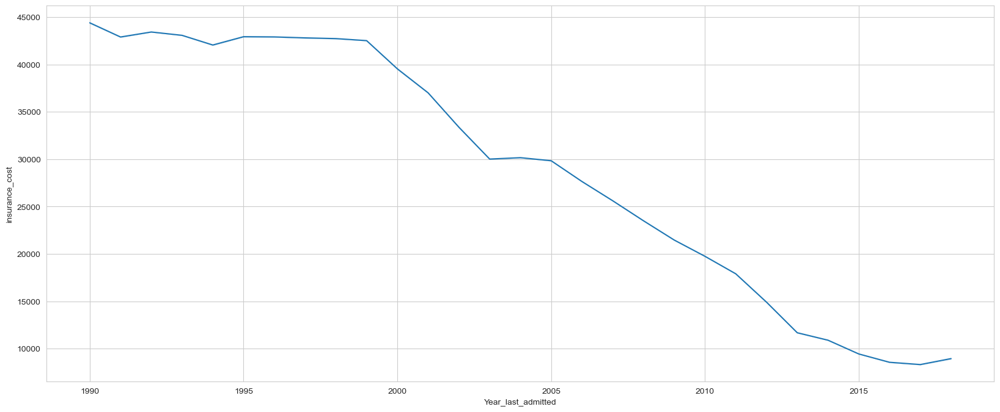

In [30]:
plt.figure(figsize=(20,8))
sns.lineplot(x=inscost['Year_last_admitted'],y=inscost['insurance_cost'],ci=False)

In [31]:
#test to determine the significance of Year_last_admitted field
from scipy.stats import ttest_ind

target_column = 'insurance_cost'

missing_rows = inscost[inscost['Year_last_admitted'].isnull()][target_column]
non_missing_rows = inscost[inscost['Year_last_admitted'].notnull()][target_column]

# t-test to compare the means of the target variable
t_stat, p_value = ttest_ind(missing_rows, non_missing_rows, nan_policy='omit')

# Output the results
print(f'T-statistic: {t_stat}\nP-value: {p_value}')


T-statistic: -26.305462082418646
P-value: 1.85496086049429e-150


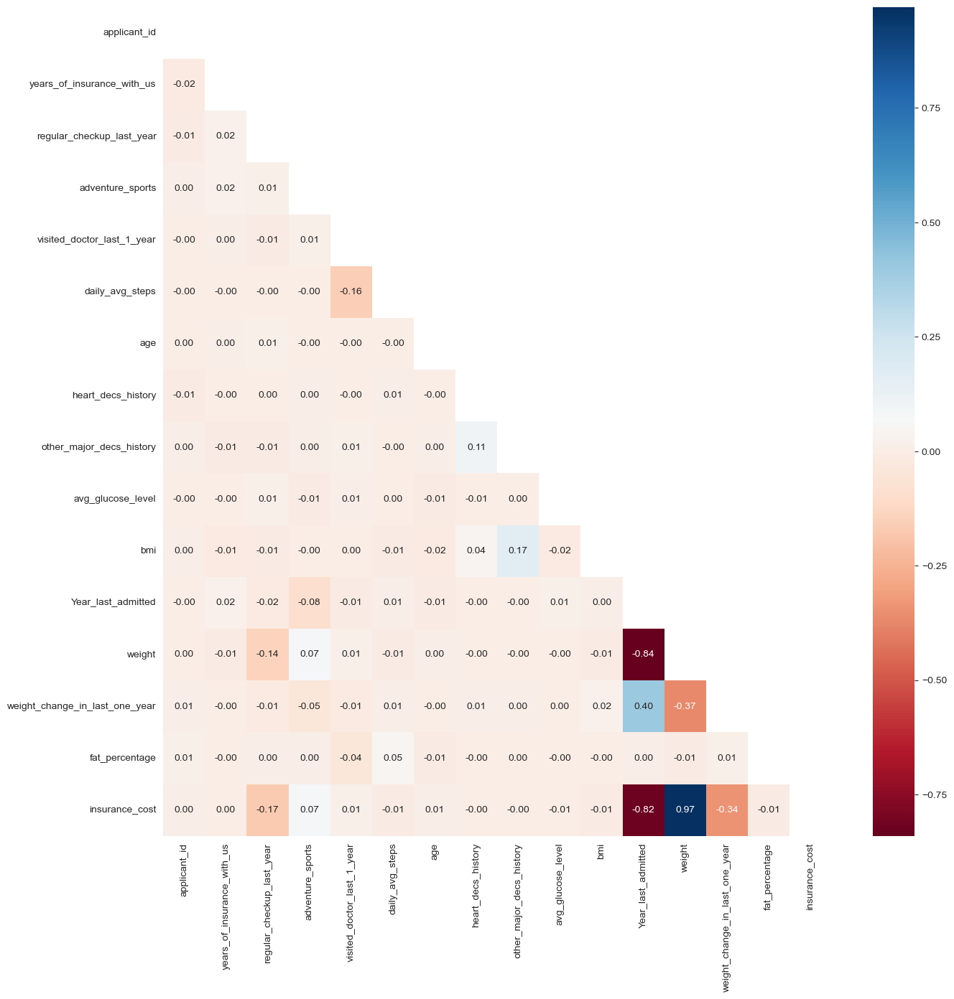

In [32]:
#Examining the correlation of Year_last_admitted with the other predictors and target variable
corr=inscost.corr()
plt.figure(figsize=(15,15))
mask=np.triu(np.ones_like(corr))
sns.heatmap(data=corr, annot=True, fmt='.2f',cmap='RdBu',mask=mask)
plt.show()

Observations:
- The field 'Year_last_admitted' has about 47.5% missing values
- This is a very high percentage, and in a business scenario, efforts have to be made to obtain the actual data
- However, in this case, a decision has to be made whether to drop this variable or impute missing values
- The field in general has a high correlation with the target variable and a couple of predictor variable
- A t-test was done to ascertain the significance, and resulted in a p-value<0.05, which indicated that the variable is significant
- Hence, instead of making the data entirely synthetic, a better option would be to drop the column entirely
- Also, the bmi field has very few missing values. Hence, dropping rows with null values in this field will not result in much data loss

### Missing Value Treatment

In [33]:
inscost_i=pd.DataFrame(inscost.copy(),columns=inscost.columns)

In [34]:
inscost.shape

(25000, 24)

In [35]:
inscost_i.drop('applicant_id',axis=1,inplace=True)

In [36]:
inscost_i.drop('Year_last_admitted',axis=1,inplace=True)

In [37]:
inscost_i[inscost_i['bmi'].isnull()==True].count()

years_of_insurance_with_us        990
regular_checkup_last_year         990
adventure_sports                  990
Occupation                        990
visited_doctor_last_1_year        990
cholesterol_level                 990
daily_avg_steps                   990
age                               990
heart_decs_history                990
other_major_decs_history          990
Gender                            990
avg_glucose_level                 990
bmi                                 0
smoking_status                    990
Location                          990
weight                            990
covered_by_any_other_company      990
Alcohol                           990
exercise                          990
weight_change_in_last_one_year    990
fat_percentage                    990
insurance_cost                    990
dtype: int64

In [38]:
inscost_i.dropna(inplace=True)

In [39]:
inscost_i.shape

(24010, 22)

In [40]:
(((25000*23)-(24010*22))/(25000*23))*100

8.135652173913044

Observations:
- The year_last_admitted columns was dropped, and the 990 rows that has null values in bmi were dropped
- After the missing value treatment, the shape of the dataset is (24010,22)
- The overall data loss due to missing value treatment is 8.13%

## Bad Value Correction

In [41]:
inscost_i['Occupation']=np.where(inscost_i['Occupation']=='Salried','Salaried',inscost_i['Occupation'])

In [42]:
inscost_i['Occupation'].value_counts()

Student     9748
Business    9649
Salaried    4613
Name: Occupation, dtype: int64

In [43]:
inscost_i.shape

(24010, 22)

Observations:
- 'regular_checkup_lasy_year' was renamed as 'regular_checkup_last_year'
- One of the values in the 'Occupation' field was 'Salried'. It was changed to 'Salaried'

## Feature Engineering

In [44]:
inscost_i.head()

,years_of_insurance_with_us,regular_checkup_last_year,adventure_sports,Occupation,visited_doctor_last_1_year,cholesterol_level,daily_avg_steps,age,heart_decs_history,other_major_decs_history,Gender,avg_glucose_level,bmi,smoking_status,Location,weight,covered_by_any_other_company,Alcohol,exercise,weight_change_in_last_one_year,fat_percentage,insurance_cost
0,3,1,1,Salaried,2,125 to 150,4866,28,1,0,Male,97,31.2,Unknown,Chennai,67,N,Rare,Moderate,1,25,20978
1,0,0,0,Student,4,150 to 175,6411,50,0,0,Male,212,34.2,formerly smoked,Jaipur,58,N,Rare,Moderate,3,27,6170
2,1,0,0,Business,4,200 to 225,4509,68,0,0,Female,166,40.4,formerly smoked,Jaipur,73,N,Daily,Extreme,0,32,28382
3,7,4,0,Business,2,175 to 200,6214,51,0,0,Female,109,22.9,Unknown,Chennai,71,Y,Rare,No,3,37,27148
4,3,1,0,Student,2,150 to 175,4938,44,0,1,Male,118,26.5,never smoked,Bangalore,74,N,No,Extreme,0,34,29616


In [45]:
num_cols=[ 'daily_avg_steps', 'age',  'avg_glucose_level', 'weight','bmi',
       'fat_percentage', 'insurance_cost']
cat_cols=['years_of_insurance_with_us', 'regular_checkup_last_year',
       'adventure_sports', 'Occupation', 'visited_doctor_last_1_year',
       'cholesterol_level',  'heart_decs_history',
       'other_major_decs_history', 'Gender', 
       'smoking_status', 'Location', 
       'covered_by_any_other_company', 'Alcohol', 'exercise',
       'weight_change_in_last_one_year', 'fat_percentage']

In [46]:
len(num_cols)+len(cat_cols)

23

In [47]:
for i in inscost_i[cat_cols]:
    print('\n',i,'\n', inscost_i[i].value_counts().sort_index())


 years_of_insurance_with_us 
 0    2801
1    2760
2    1741
3    2871
4    2707
5    2827
6    2693
7    2771
8    2839
Name: years_of_insurance_with_us, dtype: int64

 regular_checkup_last_year 
 0    14621
1     4454
2     2104
3     1745
4      750
5      336
Name: regular_checkup_last_year, dtype: int64

 adventure_sports 
 0    22043
1     1967
Name: adventure_sports, dtype: int64

 Occupation 
 Business    9649
Salaried    4613
Student     9748
Name: Occupation, dtype: int64

 visited_doctor_last_1_year 
 0        1
1      412
2     8322
3     6823
4     6426
5     1220
6      531
7      183
8       72
9       13
10       6
12       1
Name: visited_doctor_last_1_year, dtype: int64

 cholesterol_level 
 125 to 150    8001
150 to 175    8396
175 to 200    2778
200 to 225    2862
225 to 250    1973
Name: cholesterol_level, dtype: int64

 heart_decs_history 
 0    22804
1     1206
Name: heart_decs_history, dtype: int64

 other_major_decs_history 
 0    21788
1     2222
Name: other_m

### Value transformation- Category aggregation

In [48]:
inscost_ieda=pd.DataFrame(inscost_i.copy(),columns=inscost_i.columns)

In [49]:
inscost_ieda

,years_of_insurance_with_us,regular_checkup_last_year,adventure_sports,Occupation,visited_doctor_last_1_year,cholesterol_level,daily_avg_steps,age,heart_decs_history,other_major_decs_history,Gender,avg_glucose_level,bmi,smoking_status,Location,weight,covered_by_any_other_company,Alcohol,exercise,weight_change_in_last_one_year,fat_percentage,insurance_cost
0,3,1,1,Salaried,2,125 to 150,4866,28,1,0,Male,97,31.2,Unknown,Chennai,67,N,Rare,Moderate,1,25,20978
1,0,0,0,Student,4,150 to 175,6411,50,0,0,Male,212,34.2,formerly smoked,Jaipur,58,N,Rare,Moderate,3,27,6170
2,1,0,0,Business,4,200 to 225,4509,68,0,0,Female,166,40.4,formerly smoked,Jaipur,73,N,Daily,Extreme,0,32,28382
3,7,4,0,Business,2,175 to 200,6214,51,0,0,Female,109,22.9,Unknown,Chennai,71,Y,Rare,No,3,37,27148
4,3,1,0,Student,2,150 to 175,4938,44,0,1,Male,118,26.5,never smoked,Bangalore,74,N,No,Extreme,0,34,29616
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24994,7,0,0,Business,3,150 to 175,5494,43,0,0,Female,73,27.4,Unknown,Mumbai,61,N,Rare,Moderate,5,36,13574
24995,3,0,0,Salaried,4,225 to 250,5614,22,0,0,Male,145,36.1,smokes,Kanpur,79,Y,Rare,Moderate,4,40,39488
24996,6,0,0,Business,4,200 to 225,4719,58,0,0,Male,134,31.3,never smoked,Kanpur,66,N,Rare,Moderate,2,28,14808
24998,1,0,0,Salaried,2,225 to 250,10777,27,0,0,Male,66,26.6,Unknown,Surat,74,N,Rare,Moderate,0,40,30850


In [50]:
inscost_ieda['visited_doctor_last_1_year']=np.where(inscost_ieda['visited_doctor_last_1_year']>=5,5,inscost_ieda['visited_doctor_last_1_year'])
inscost_ieda['visited_doctor_last_1_year']=np.where(inscost_ieda['visited_doctor_last_1_year']<=1,1,inscost_ieda['visited_doctor_last_1_year'])

In [ ]:
inscost_ieda['visited_doctor_last_1_year'].value_counts().sort_index()

In [ ]:
inscost_ieda.shape

Observations:
- 'visited_doctor_last_year' had very little values for 0 visits and over 5 visits. These were aggregated into 1 visit and 5 visits for the purpose of EDA

### New feature creation

In [ ]:
inscost_ieda['daily_avg_steps'].describe()

In [ ]:
inscost_ieda['avg_step_cat']=np.where(
    (inscost_ieda['daily_avg_steps']<=4500),
        'Sedentary',
        np.where(
            (inscost_ieda['daily_avg_steps'] > 4500) &  (inscost_ieda['daily_avg_steps']<=6000),
            'Lightly Active',
                np.where(
                    (inscost_ieda['daily_avg_steps'] > 6000) &  (inscost_ieda['daily_avg_steps'] <= 10000),
                        'Active','Very Active')))

In [ ]:
inscost_ieda['weight'].value_counts().sort_index()

In [ ]:
inscost_ieda['weight_cat']=np.where(
    (inscost_ieda['weight']<=60),
        'Underweight',
        np.where(
            (inscost_ieda['weight'] > 60) &  (inscost_ieda['weight']<=70),
            'Normal Weight',
                np.where(
                    (inscost_ieda['weight'] > 70) &  (inscost_ieda['weight'] <= 80),
                        'Overweight',
                        np.where(
                            (inscost_ieda['weight'] > 80) &  (inscost_ieda['weight'] <= 90), 
                                'Obese', 'Very Obese'))))

In [ ]:
inscost_ieda['fat_percentage'].value_counts().sort_index()

In [ ]:
inscost_ieda['fat_percentage_cat']=np.where(
    (inscost_ieda['fat_percentage']<=20),
        'Low body fat',
        np.where(
            (inscost_ieda['fat_percentage'] > 20) &  (inscost_ieda['fat_percentage']<=30),
            'Moderate body fat',
                np.where(
                    (inscost_ieda['fat_percentage'] > 30) &  (inscost_ieda['fat_percentage'] <= 40),
                        'High body fat', 'Very High body fat')))

In [ ]:
inscost_ieda['insurance_cost'].value_counts().sort_index()

In [ ]:
inscost_ieda['insurance_cost_cat']=np.where(
    (inscost_ieda['insurance_cost']<=10000),
        '1st Tier',
        np.where(
            (inscost_ieda['insurance_cost'] > 10000) &  (inscost_ieda['insurance_cost']<=20000),
            '2nd Tier',
                np.where(
                    (inscost_ieda['insurance_cost'] > 20000) &  (inscost_ieda['insurance_cost'] <= 30000),
                        '3rd Tier',
                        np.where(
                            (inscost_ieda['insurance_cost'] > 30000) &  (inscost_ieda['insurance_cost'] <= 40000), 
                                '4th  Tier', 
                                np.where(
                                    (inscost_ieda['insurance_cost'] > 40000) &  (inscost_ieda['insurance_cost'] <= 50000), 
                                        '5th Tier', '6th Tier')))))

Observations:
- For some of the numerical fields like daily_avg_steps, fat_percentage,weight and insurance_cost, corresponding categorical fields were created by creating buckets for numerical values for the purpose of EDA

In [417]:
inscost_ieda['avg_step_cat'].value_counts()

Lightly Active    13925
Sedentary          5640
Active             4430
Very Active          15
Name: avg_step_cat, dtype: int64

In [ ]:
inscost_ieda.shape

In [ ]:
inscost_ieda.columns

In [ ]:
eda_col_order=['years_of_insurance_with_us', 'regular_checkup_last_year',
       'adventure_sports', 'Occupation', 'visited_doctor_last_1_year',
       'cholesterol_level', 'daily_avg_steps', 'age', 'heart_decs_history',
       'other_major_decs_history', 'Gender', 'avg_glucose_level', 'bmi',
       'smoking_status', 'Location', 'weight',
       'covered_by_any_other_company', 'Alcohol', 'exercise',
       'weight_change_in_last_one_year', 'fat_percentage', 
       'avg_step_cat', 'weight_cat', 'fat_percentage_cat',
       'insurance_cost_cat','insurance_cost']

In [ ]:
len(eda_col_order)

In [ ]:
inscost_ieda=inscost_ieda[eda_col_order]

In [ ]:
inscost_ieda.info()

In [ ]:
num=[ 'daily_avg_steps', 'age',  'avg_glucose_level',  'weight', 'bmi',
       'fat_percentage', 'insurance_cost']
cat=['years_of_insurance_with_us', 'regular_checkup_last_year',
       'adventure_sports', 'Occupation', 'visited_doctor_last_1_year',
       'cholesterol_level',  'heart_decs_history',
       'other_major_decs_history', 'Gender', 
       'smoking_status',  'Location', 
       'covered_by_any_other_company', 'Alcohol', 'exercise',
       'weight_change_in_last_one_year', 'avg_step_cat','weight_cat','fat_percentage_cat','insurance_cost_cat']
binry=['adventure_sports','covered_by_any_other_company','heart_decs_history',
       'other_major_decs_history', 'Gender']

## EDA

### Univariate Analysis

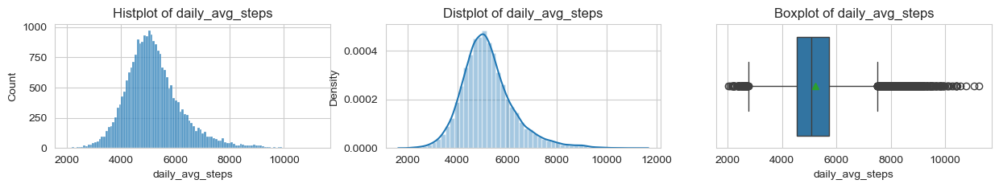

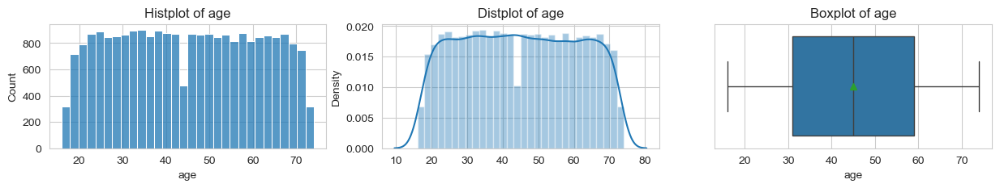

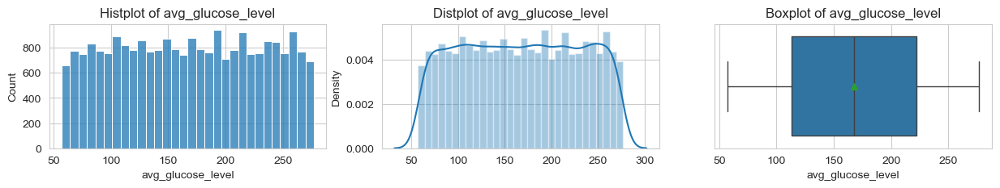

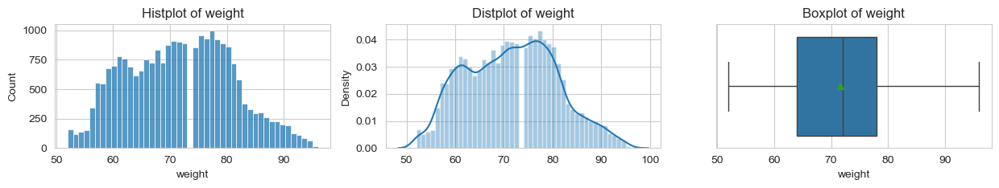

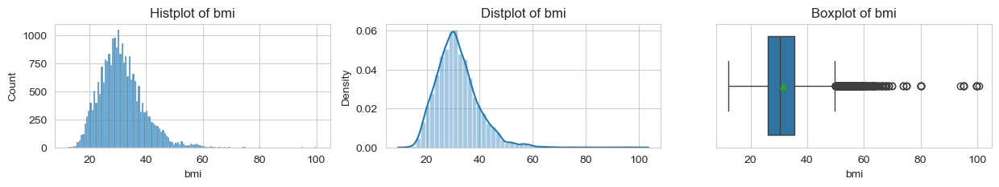

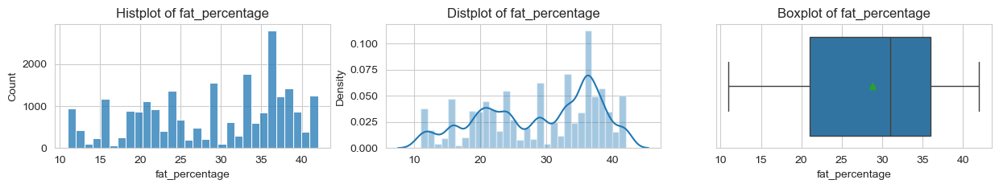

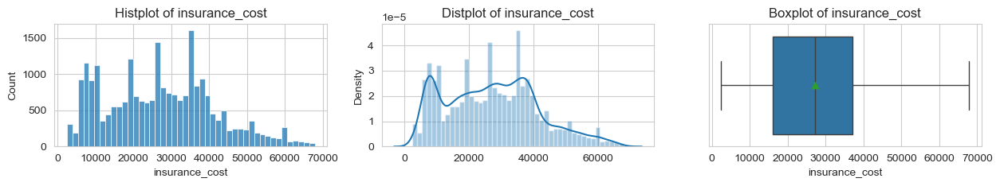

In [419]:
for i in inscost_ieda[num]:
    fig,axes= plt.subplots(ncols=3,figsize=(15,2))
    sns.histplot(x=inscost_ieda[i],ax=axes[0])
    axes[0].set_title('Histplot of {}'.format(i))
    sns.distplot(x=inscost_ieda[i],ax=axes[1])
    axes[1].set_title('Distplot of {}'.format(i))
    sns.boxplot(data=inscost_ieda,x=i,showmeans=True,ax=axes[2])
    axes[2].set_title('Boxplot of {}'.format(i))
    plt.show()

In [ ]:
inscost['fat_percentage'].nunique()

Observations:
- Columns with outliers: daily_avg_steps
- age,avg_glucose_level have a uniform distribution
- weight variable has a multimodal distribution
- fat_percentage has 32 unique values ranging from 11-42. Hence the distribution is multimodal

In [ ]:
non_bin_cat=[x for x in cat if x not in binry]

In [ ]:
for i in inscost_ieda[non_bin_cat]:
    plt.figure(figsize=(4,4))
    sns.countplot(data=inscost_ieda,x=i,palette='YlGnBu')
    plt.title('Countplot of {}'.format(i))
    plt.xticks(rotation=90)
    plt.tight_layout();
    plt.show();

Observations:
- The count of customers having 2 years of insurance with us is lower than the rest
- Most of the people have not had any regular checkup last year
- There is almost an equal number of Students and Business professionals in the dataset. However, the count of Salaried professionals is almost half than that of the other two categories in Occupation field
- Most of the people seem to have visited the doctor 2-4 times last year 
- Most of the people have either 125-150 or 150-175 cholestrol level. Those of them who have higher cholestrol levels are very low in count
- Most of the people in the dataset have reported to have never smoked. However, there is an Unknown category in the smoking_status field. For the purpose of this project,it is treated as Unknown. However, if there is a way to get this information, it  would help in analysis
- There are 15 unique locations in the dataset, where people are from, and they are almost equally distributed amonst these locations.
- Most of the people have reported Rare or no alcohol consumption. Very few have reported daily alcohol consumption
- Most of the people have reported moderate excercise
- Most of the customers have reported a weight change of 3-4 in the past year
- Most of the customers are classified as lightly active, i.e. they take 4500-6000 steps everyday
- Most of the people are overweight, ie. have weight ranging from 70-80 . Very few are classified as very obese i.e. >90.
- Most of the people have High body fat.ie, body fat_percentage ranging from 30-40
- Based of the classification of insurance cost, most of the people belon to the 4th tier, ie., 30000-40000

In [ ]:
for i in inscost_ieda[binry]:
    plt.pie(x=inscost_ieda[i].value_counts(),labels=inscost_ieda[i].value_counts().index,autopct='%0.2f%%',colors=['olive','teal'],
       wedgeprops=dict(width=0.4,linewidth=5),pctdistance=1.25,startangle=90)
    plt.title('Proportion of categories in {}\n\n'.format(i))
    plt.Circle((0,0),0.6,color='white')
    plt.axis('equal')
    plt.show();

Observations:
- Among the categorical variables, Gender, adventure_sports, covered_by_other_company, heart_dec_history, other_decs_historyare all binary in nature
- About 2/3rd of the people are males
- Less than 10% have had other major diseased, adn less than 5% have had heart diseases
- Aboout 8% of the people engage in adventure sports
- And about 30% are covered by other insurance companies

### Bivariate Analysis

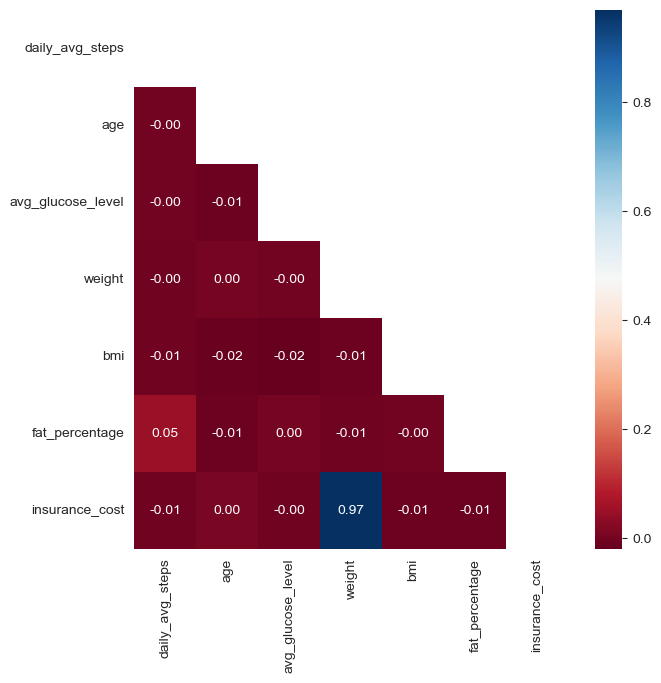

In [420]:
corl=inscost_ieda[num].corr()
plt.figure(figsize=(7,7))
mask=np.triu(np.ones_like(corl))
sns.heatmap(data=corl,annot=True, fmt='.2f',cmap='RdBu',mask=mask)
plt.show()

Observations:
- Of all the numerical variables, only the weight variable seems to have a high positive correlation with the target variable

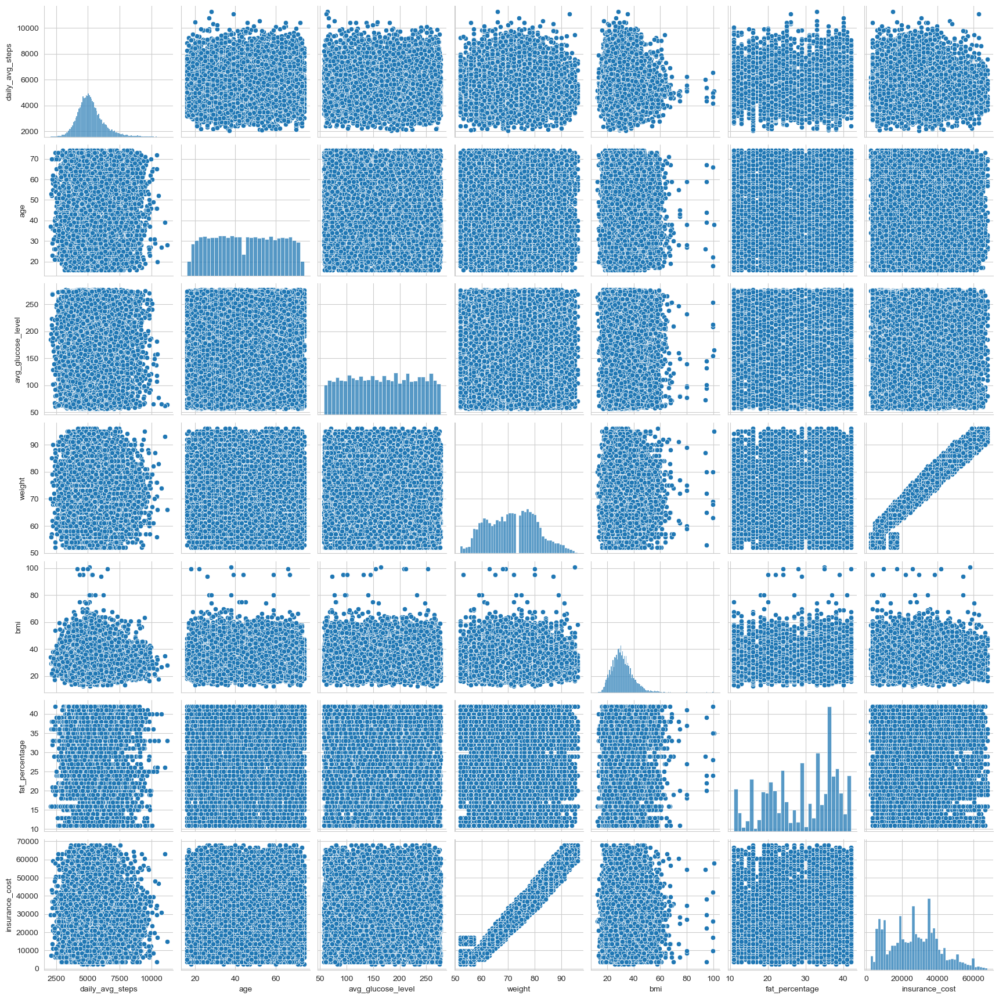

In [421]:
sns.pairplot(inscost_ieda[num])

Observations:
- From the pairplots above, a linear relation can be observed only between weight and insurance cost
- No other relation between any of the variables in discernable

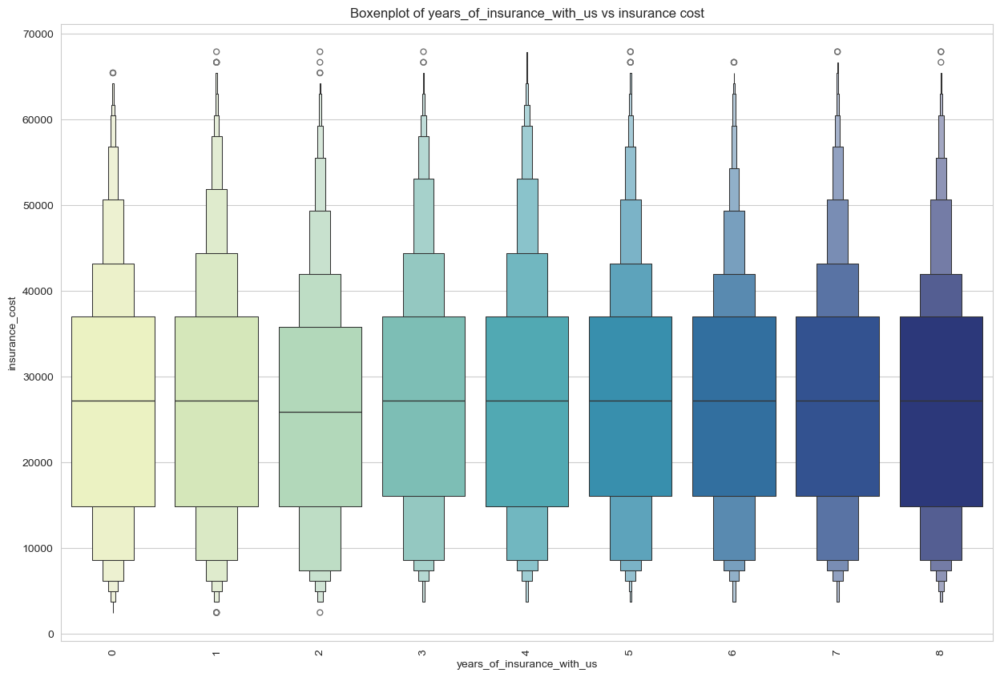

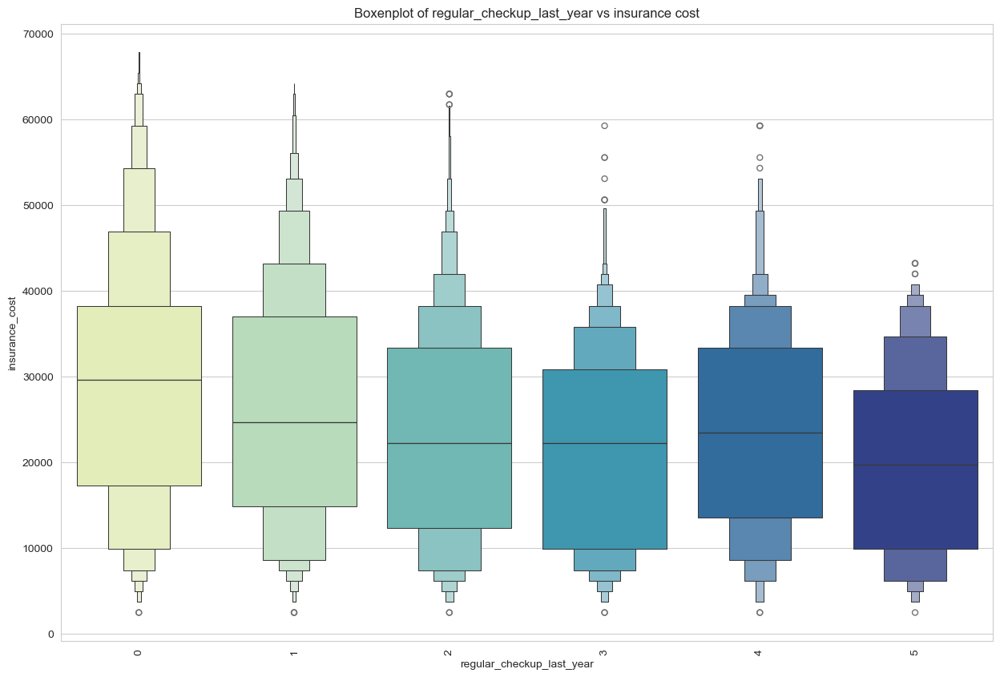

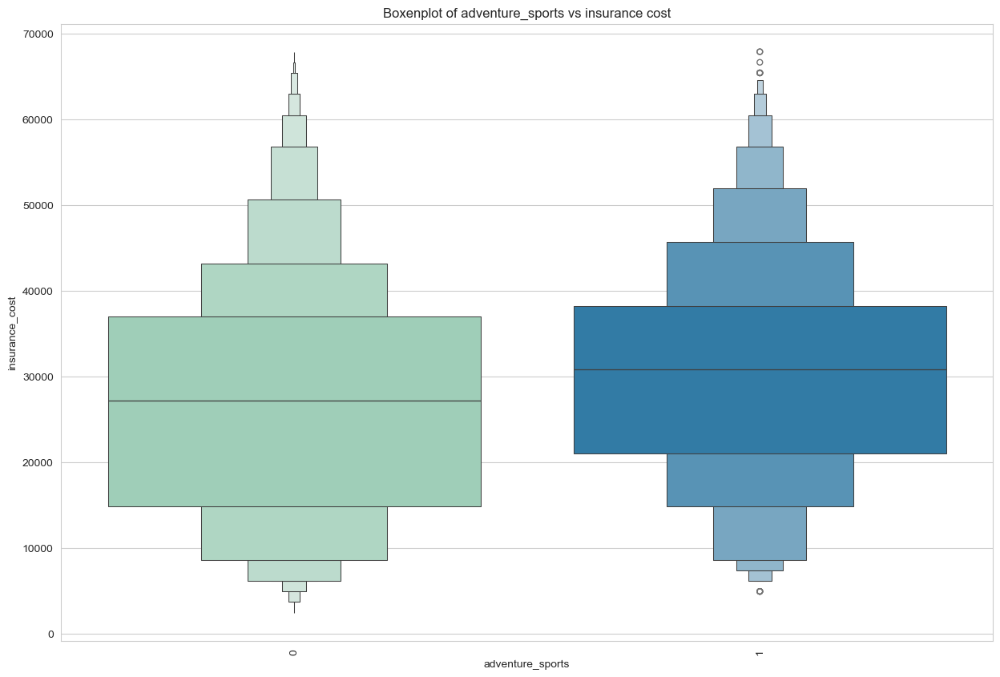

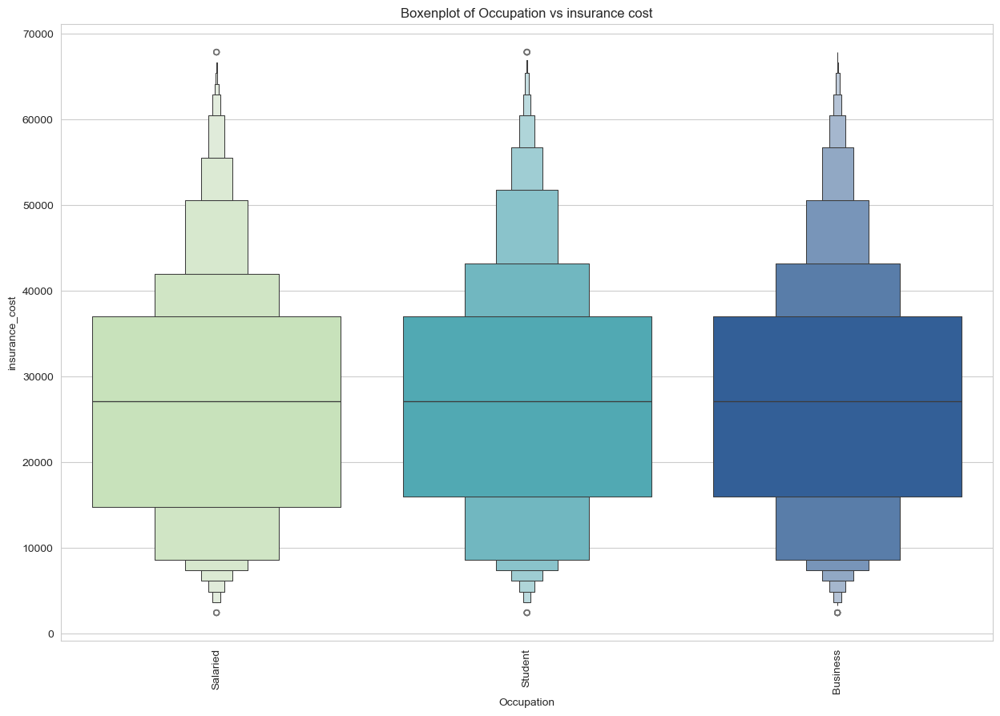

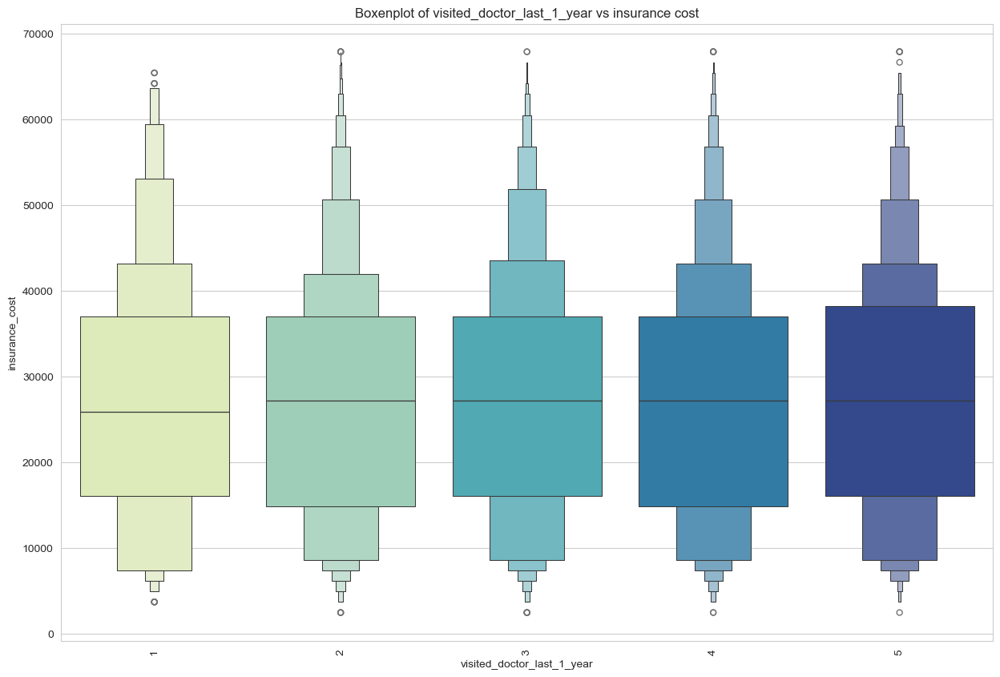

...

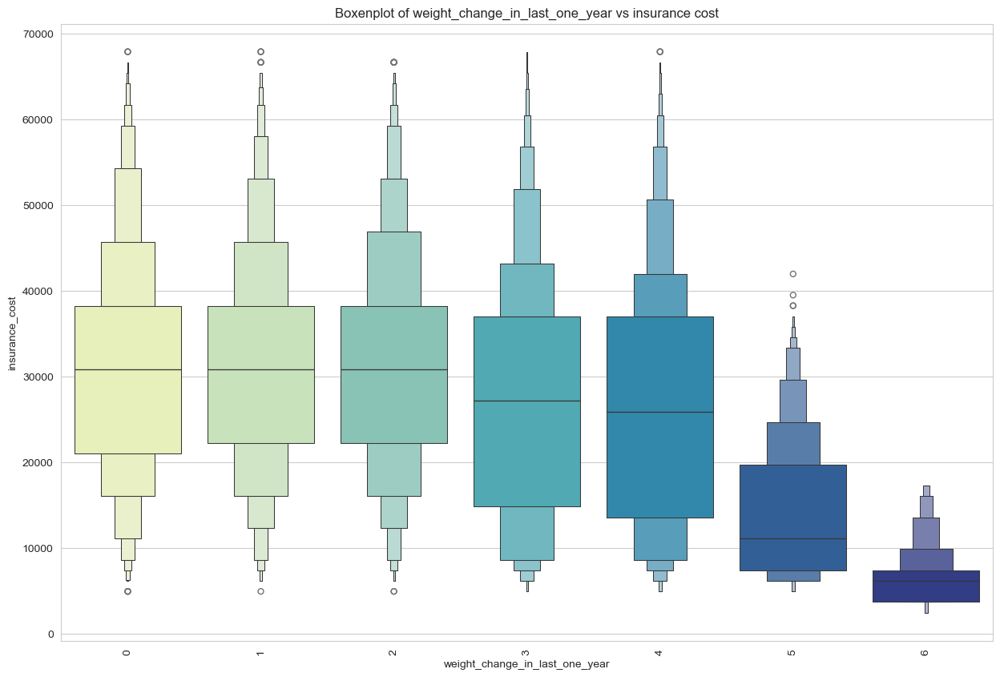

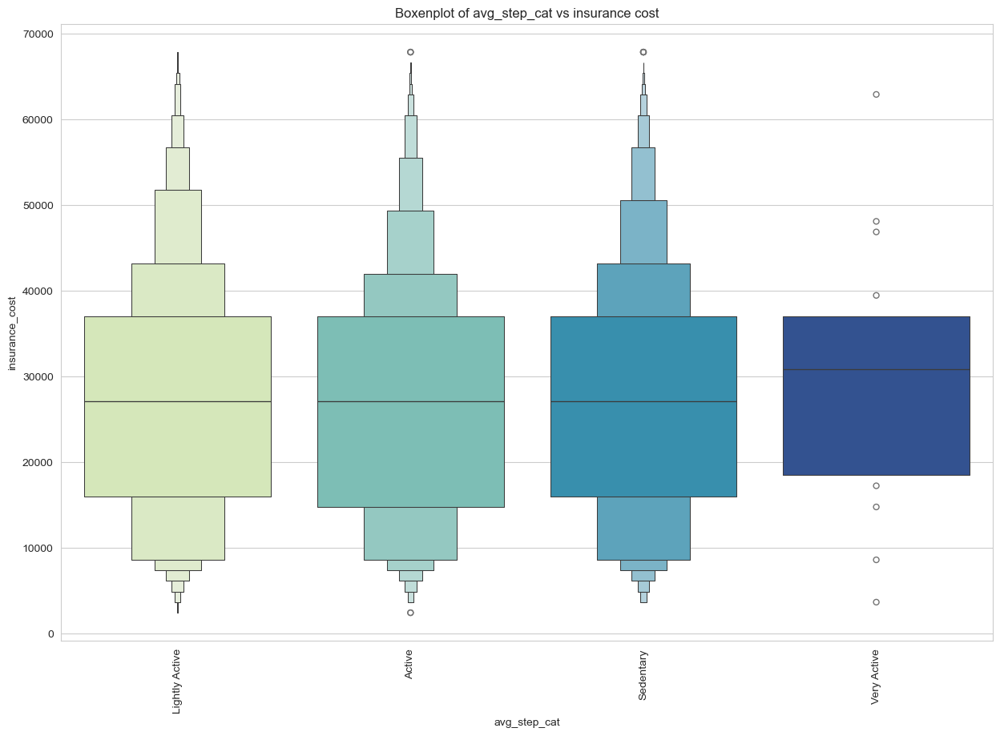

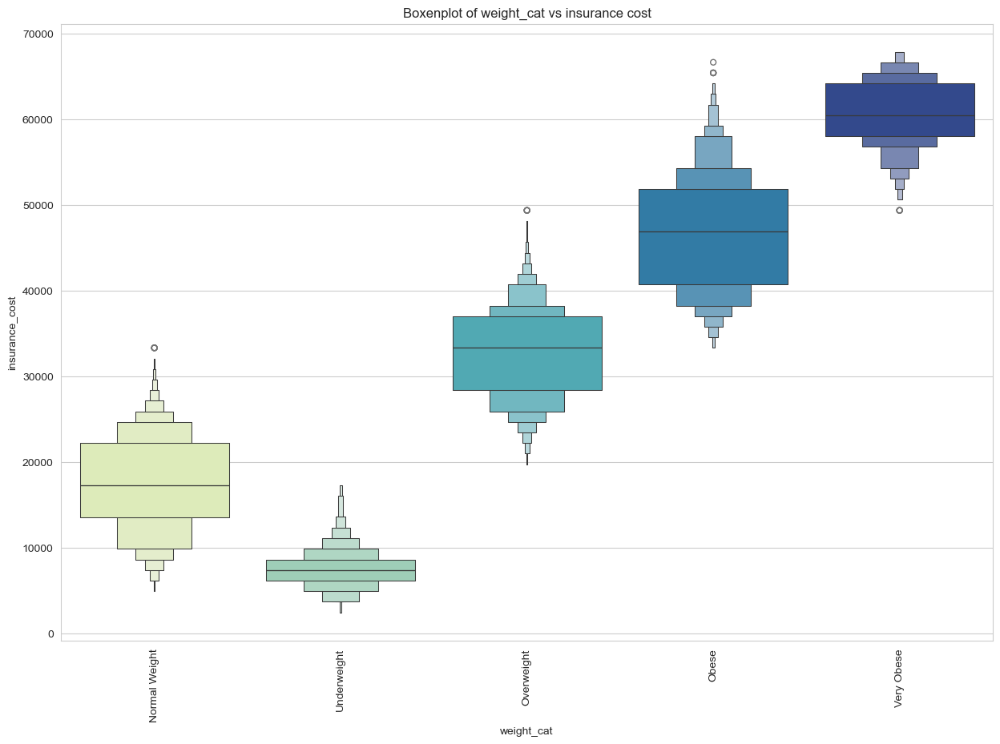

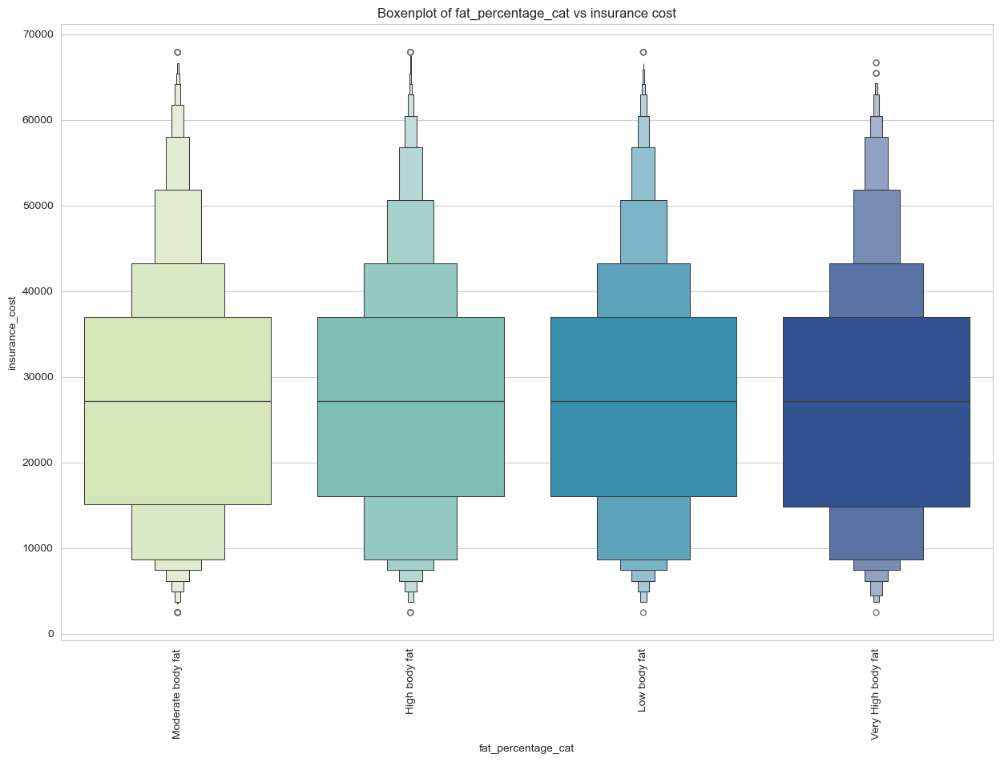

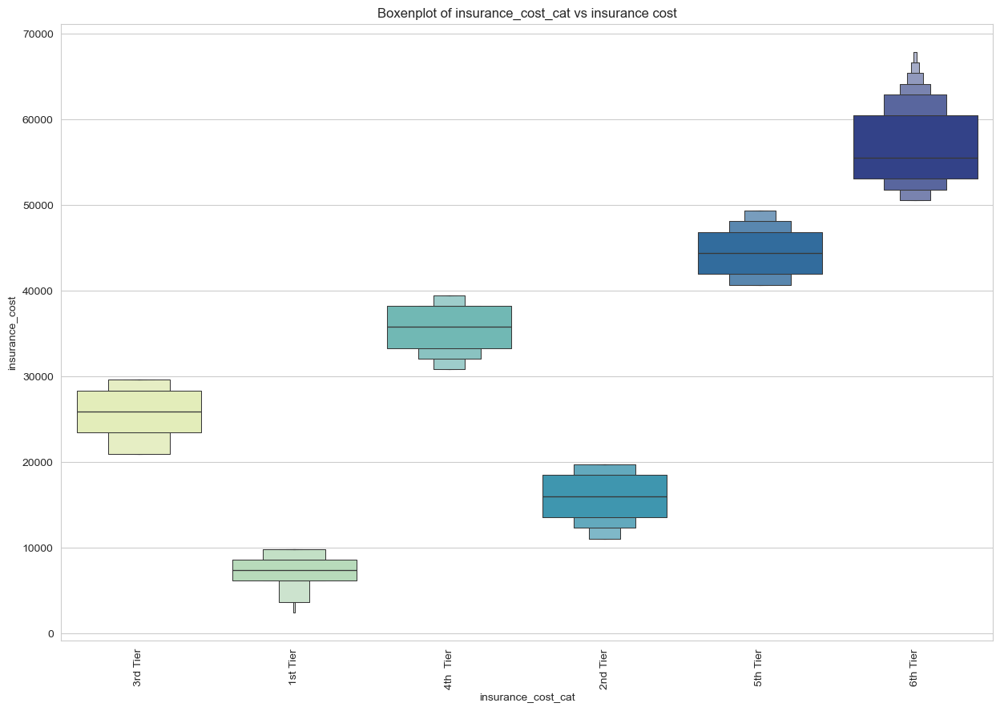

In [418]:
for i in inscost_ieda[cat]:
    plt.figure(figsize=(15,10))
    sns.boxenplot(data=inscost_ieda,x=i,y='insurance_cost',palette='YlGnBu',showfliers=True)
    plt.title('Boxenplot of {} vs insurance cost'.format(i))
    plt.xticks(rotation=90)
    plt.show();

In [ ]:
for i in inscost_ieda[cat]:
    plt.figure(figsize=(15,10))
    sns.violinplot(data=inscost_ieda,x=i,y='insurance_cost',palette='YlGnBu',width=0.8)
    plt.title('Boxenplot of {} vs insurance cost'.format(i))
    plt.xticks(rotation=90)
    plt.show();

Observations:

From the bivariate analysis of the target variable,i.e., insurance_cost, with the other categorical variables, the following are the observations:
- Those who have had 0 regular checkups last year have the highest median insurance cost
- Those who have had 5 or more than 5 regular checkups have the lowest insurance cost
- Those who engage in adventure sports have higher insurance cost than those who don't
- The median insurance cost is slightly lower in Ahmedabad and Bangalore when compared to that in other cities
- Those who have coverage from other insurance companies tend to have a higher insurance cost than those who don't
- As the weight change in the past year increases, the insurance cost decreases
- As the weight category increases, insurance cost also increases

In [ ]:
import itertools

In [ ]:
cat_pairs=list(itertools.combinations(cat,2))

In [ ]:
num_pairs=list(itertools.combinations(num,2))

In [ ]:
from statsmodels.graphics.mosaicplot import mosaic

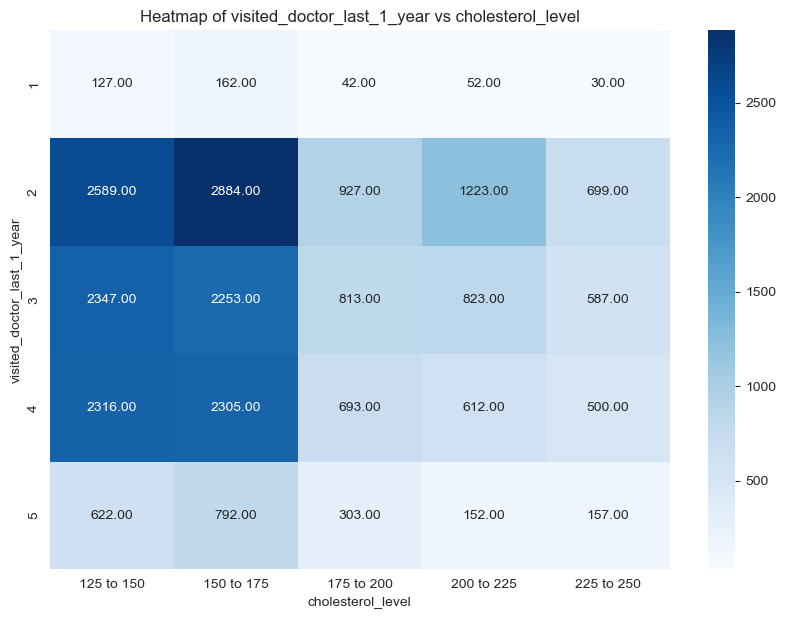

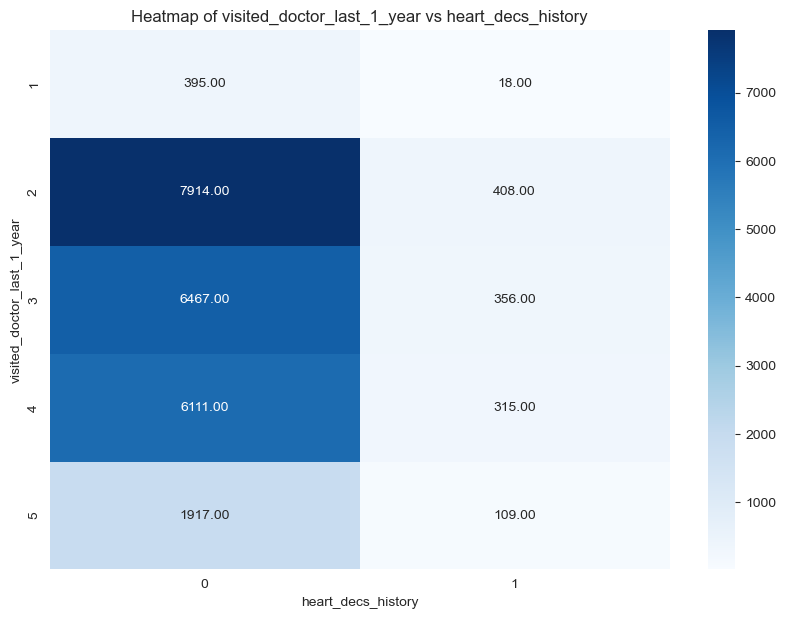

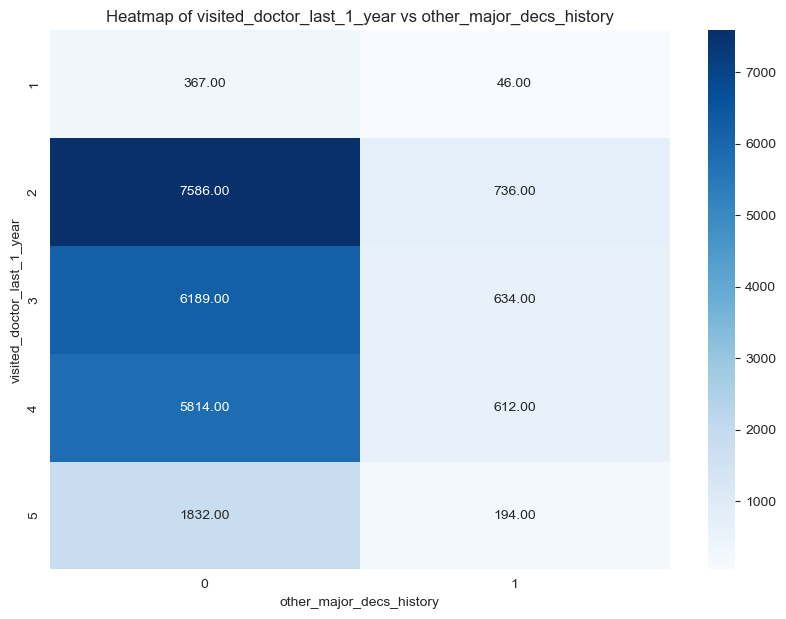

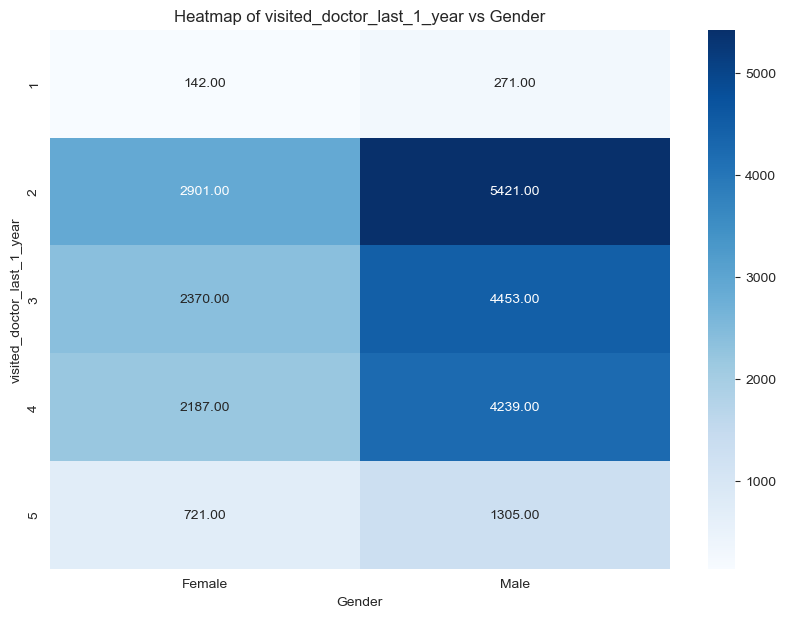

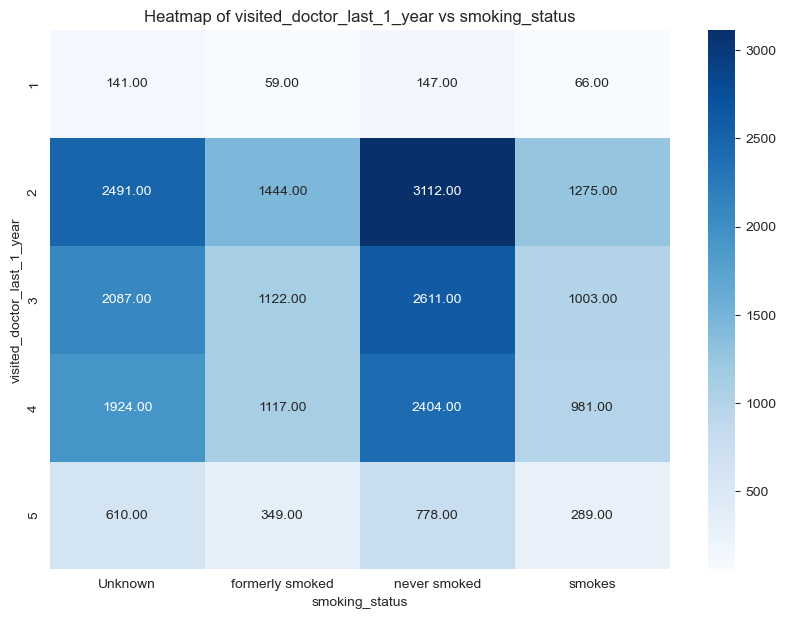

...

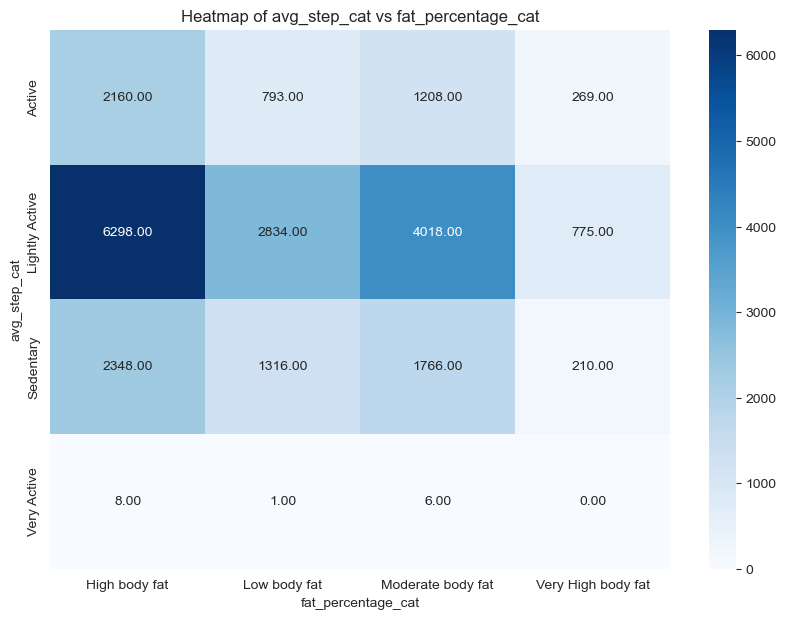

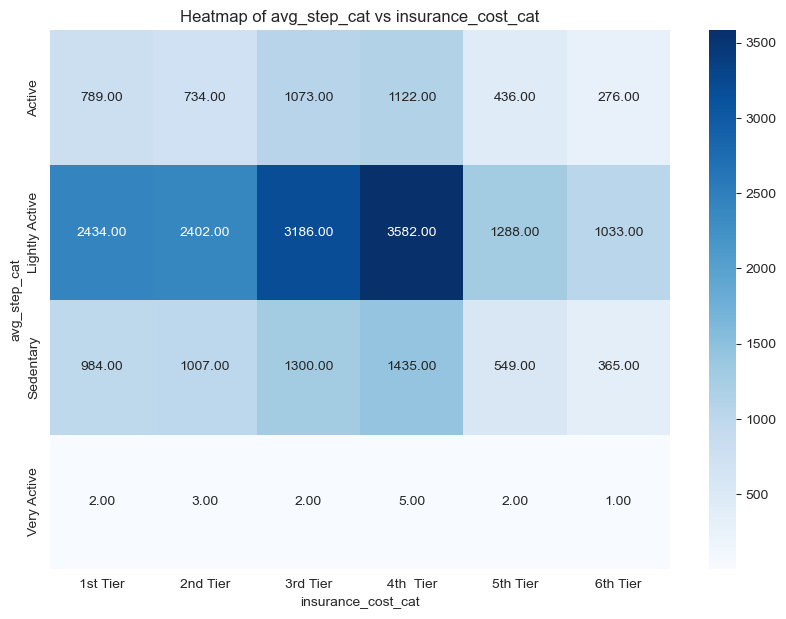

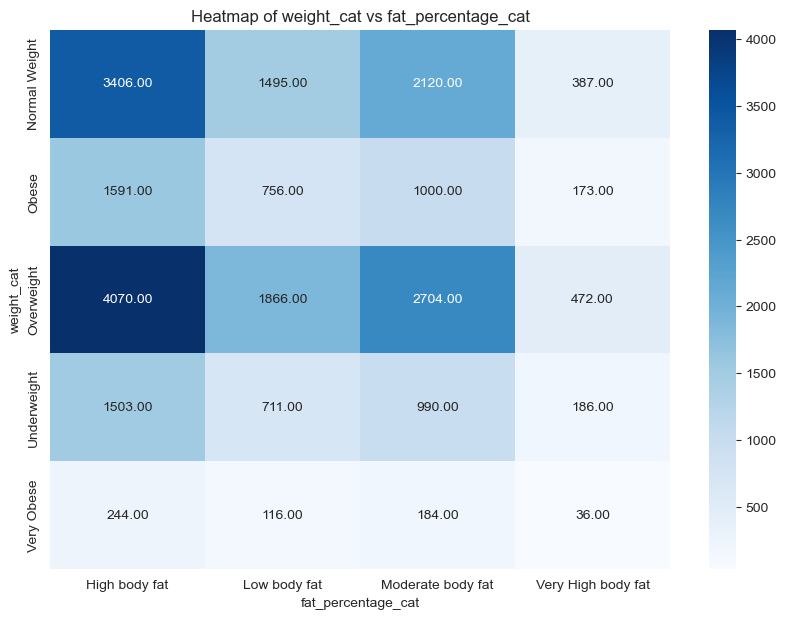

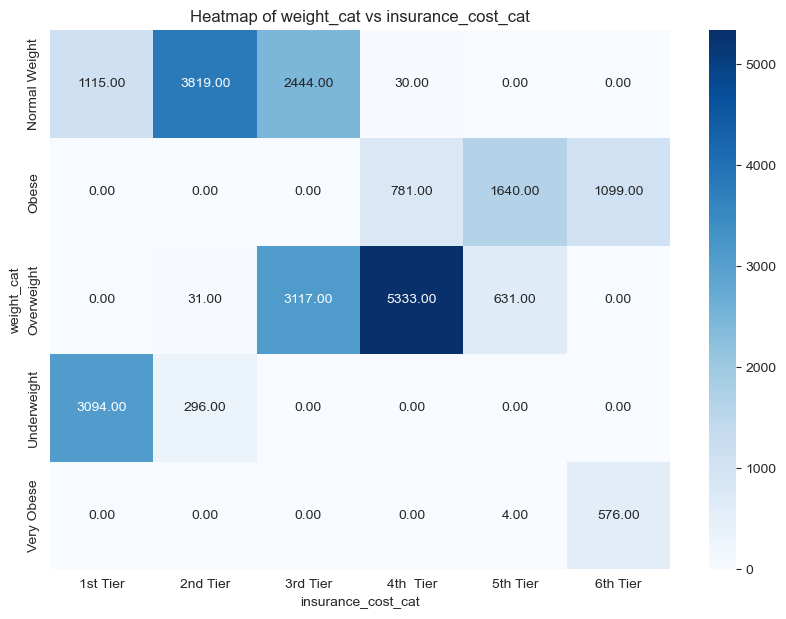

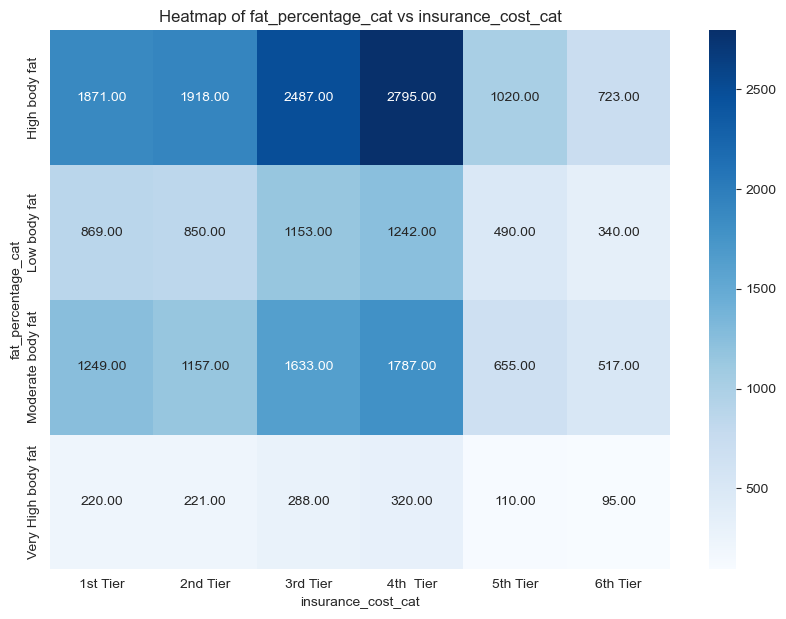

In [81]:
for i,j in cat_pairs:
    ct=pd.crosstab(index=inscost_ieda[i],columns=inscost_ieda[j])
    plt.figure(figsize=(10,7))
    sns.heatmap(ct,annot=True,fmt='.2f',cmap='Blues')
    plt.title('Heatmap of {} vs {}'.format(i,j))
    plt.xlabel(j)
    plt.ylabel(i)
    plt.show();

Observations:
Heatmaps were plotted for a combination of each categorical variable with another. The following are the observations:
- The countplot patterns continue for each category
- 2801 people have less than 0 years insurance with us and are not being covered by any other company, which means they are new to the health insurance field.
- Around 13469 people have not had a regular checkup last year and are not into adventure sports. This is more than half the dataset size
- Students and Business people are more likely to have had 0 regular checkups last year
- Around 1/5th of the population have visited the doctor last year and have not had any regular checkups
- Most of the people who have not had regular checkup last year have a cholestrol level below 175
- More than half the population size have no major disease or heart disease and have not had regular checkup- these might be at risk of unknown medical issues. This might be a potential  risk.
- Around 10242 people have not had regular checkup and are not covered by any other company
- 1/3rd of the people have reported rare intake of alcohol, but have not had regular checkup
- Around 6000 people have reported a weight change of 3-4 and have not had regular checkup
- 5851 people are overweight, and have not had regular checkup. This might be a potential risk
- 6562 people have high body fat and have not had regular checkup
- No student has a cholestrol level over 175
- Business people are prone to high cholestrol levels 150-225
- Business people have reported the highest number of heart diseases, followed by students
- 5471 students have a high body fat
- Most of the people who visited the doctor last year 2-4 times have a cholestro; level below 175
- People with very High body fat,ie. fat_percentage from have cholestrol level greater than 200
- Almost half  of the females have reported an Unknown smoking status

<AxesSubplot:xlabel='cholesterol_level', ylabel='fat_percentage'>

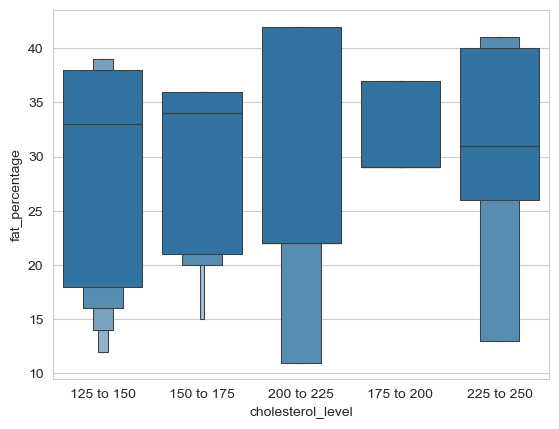

In [82]:
sns.boxenplot(data=inscost_ieda,x='cholesterol_level',y='fat_percentage')

### Multivariate Analysis

In [83]:
num_predictors=['daily_avg_steps',
 'age',
 'avg_glucose_level',
                'bmi',
 'weight',
 'fat_percentage']

In [84]:
num_predictors_pairs=list(itertools.combinations(num_predictors,2))

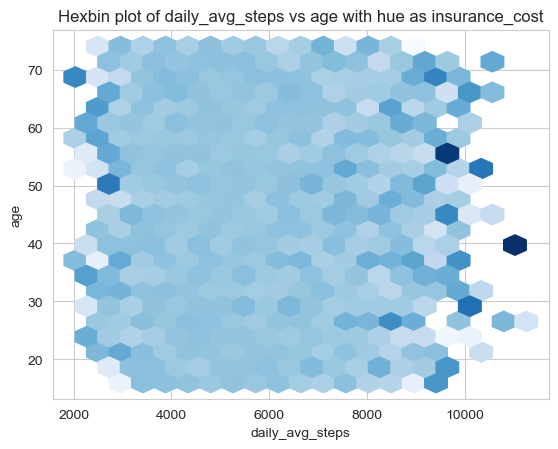

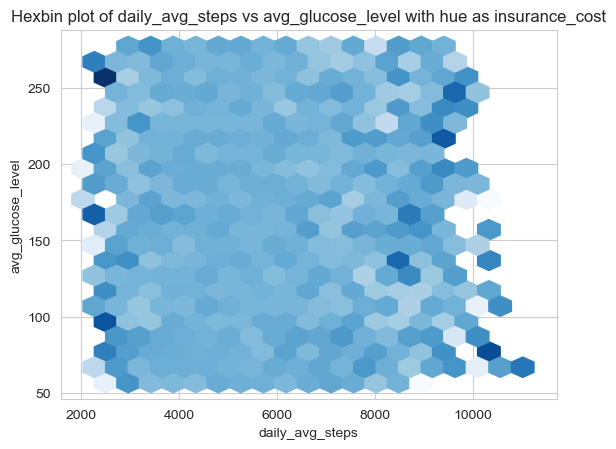

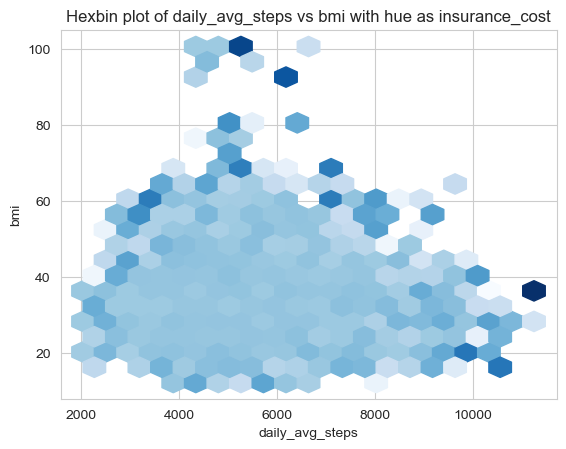

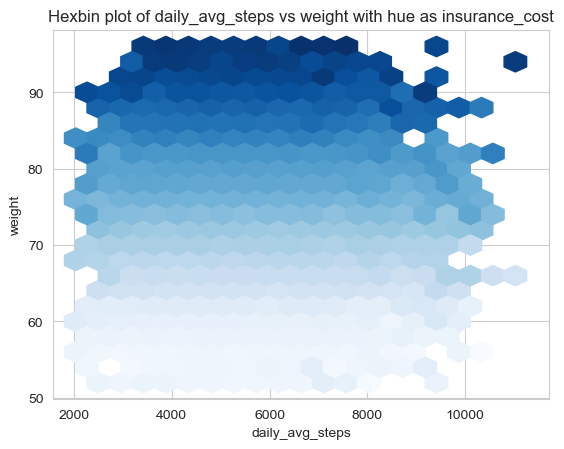

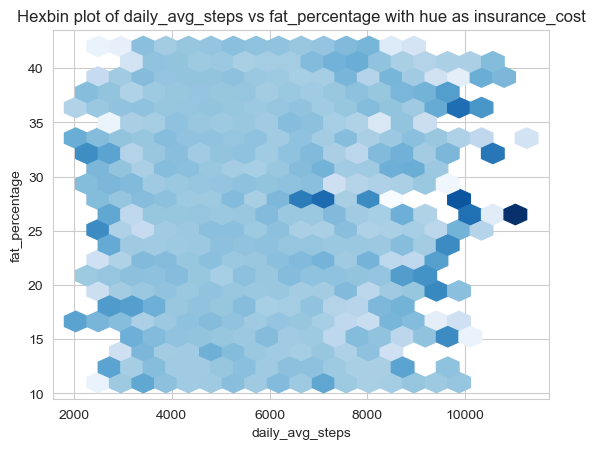

...

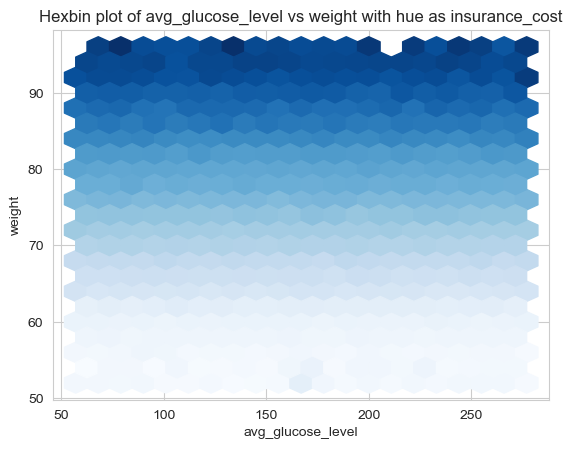

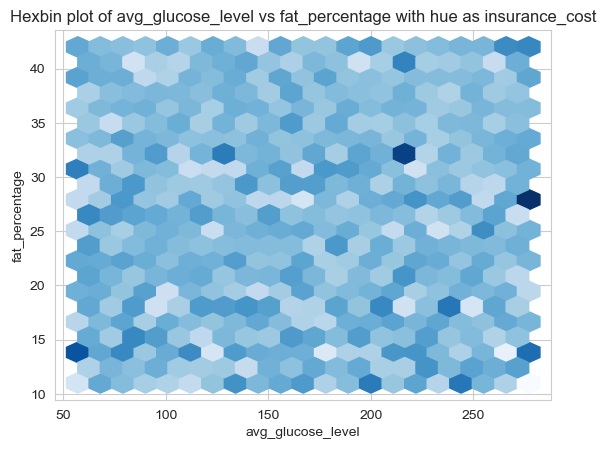

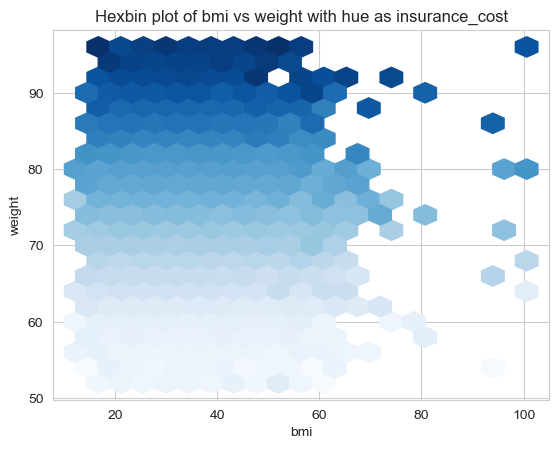

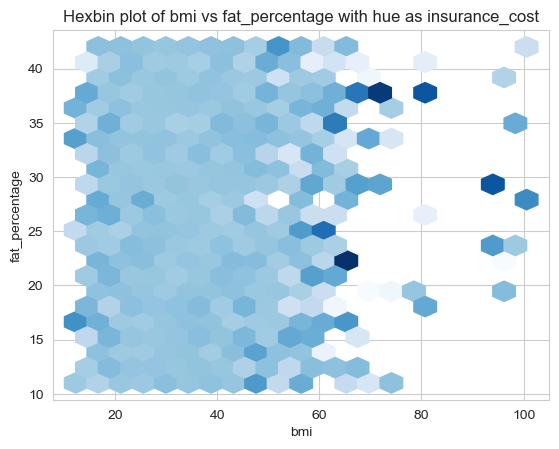

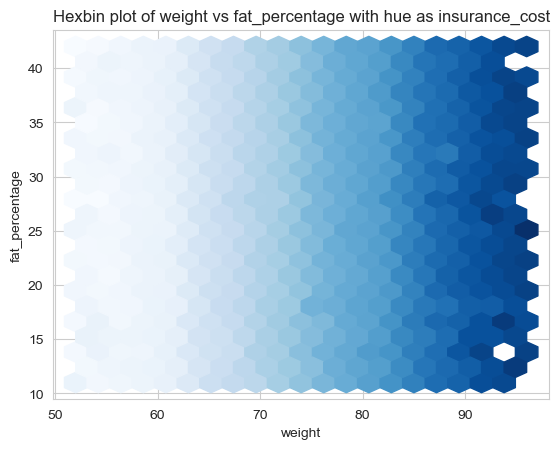

In [85]:
for i,j in num_predictors_pairs:
            plt.hexbin(inscost_ieda[i],inscost_ieda[j],gridsize=20,cmap='Blues',C=inscost_ieda['insurance_cost'])
            plt.title('Hexbin plot of {} vs {} with hue as insurance_cost'.format(i,j))
            plt.xlabel(i)
            plt.ylabel(j)
            plt.show();

Observations:
- Weight clearly seems to have a positive corrleation with insurance cost
- Other than this, the numerical variables do not seem to be correlated

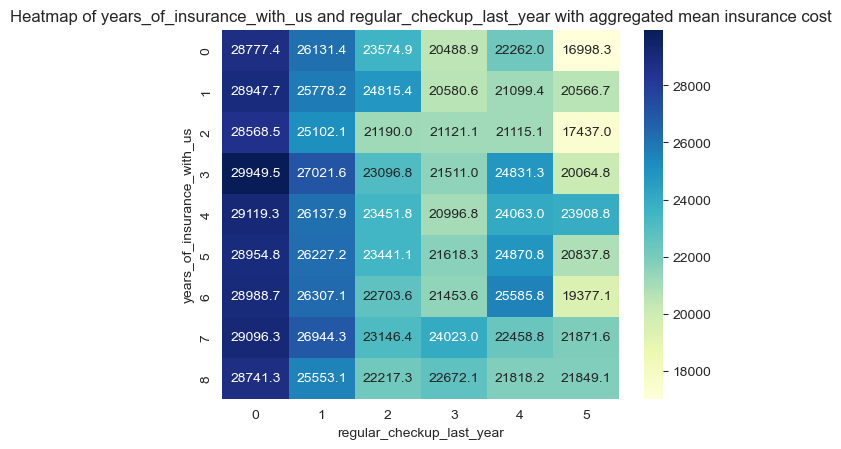

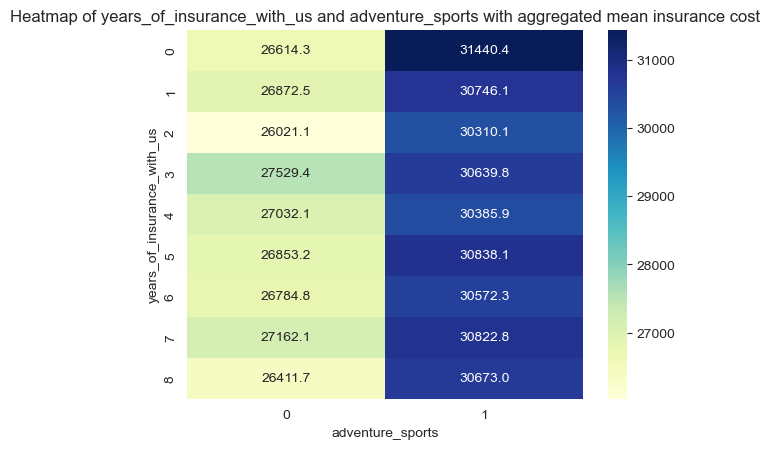

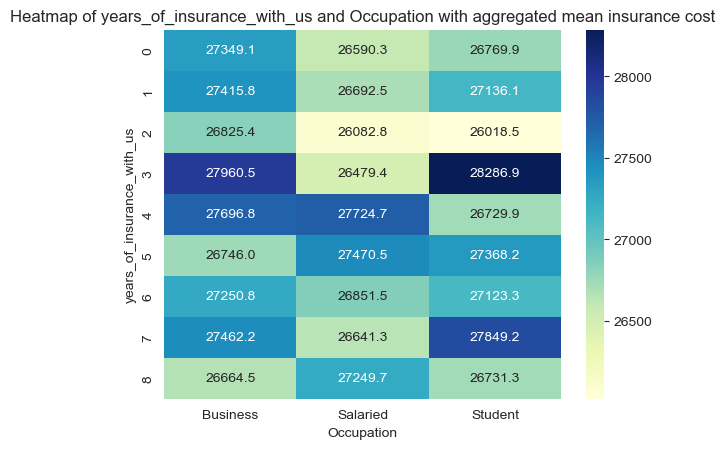

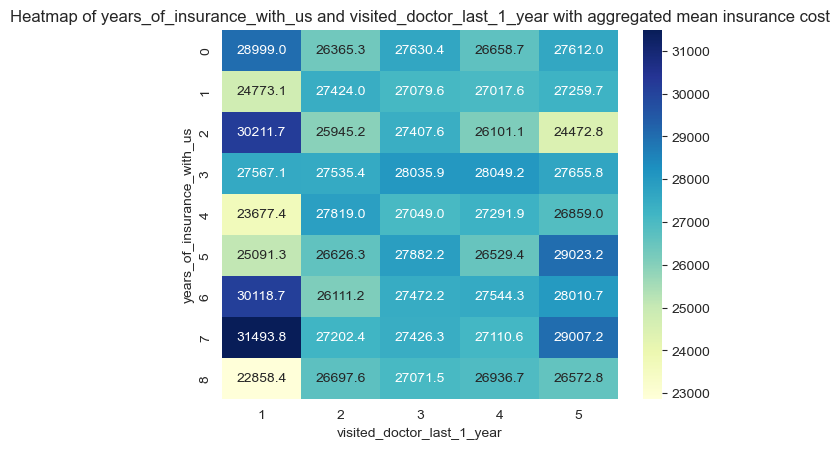

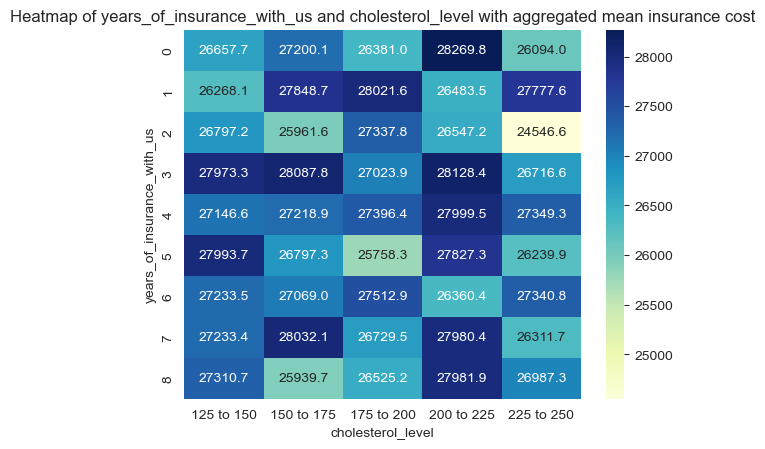

...

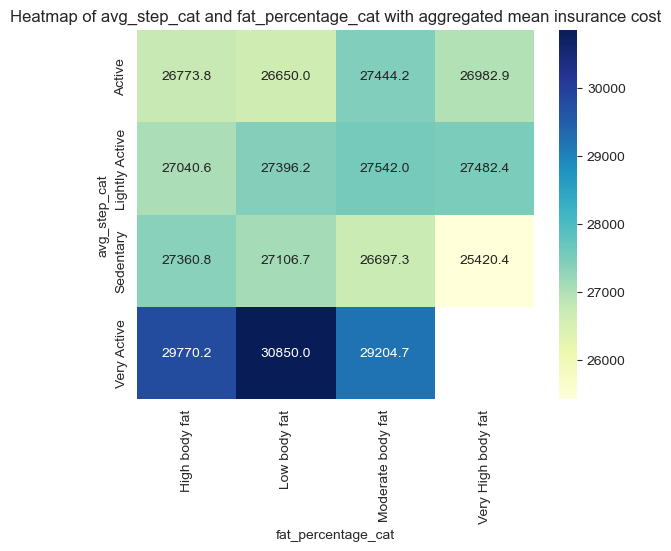

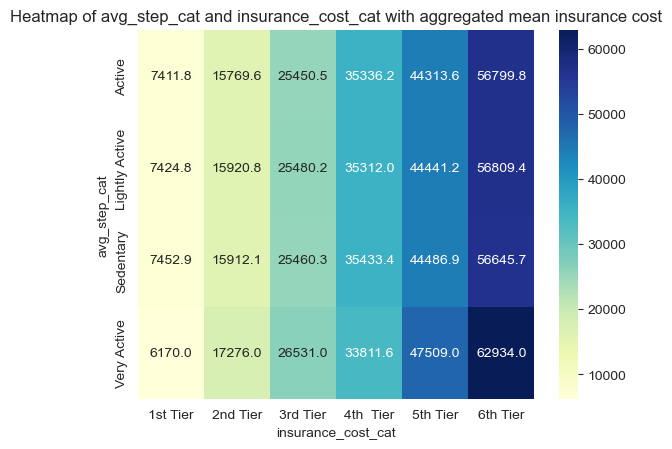

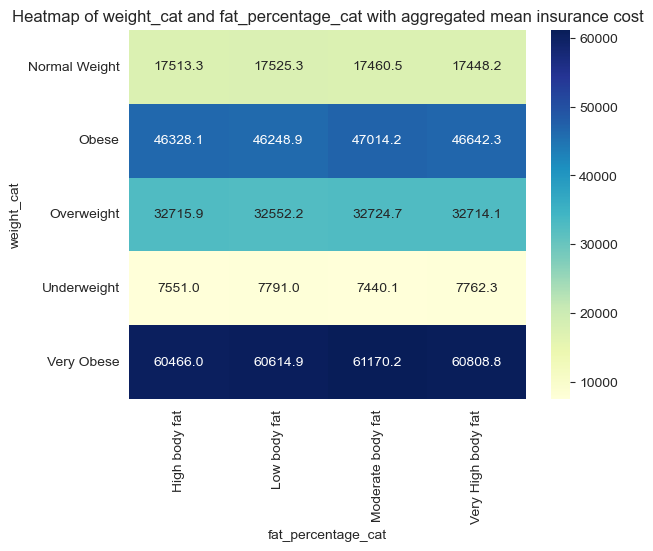

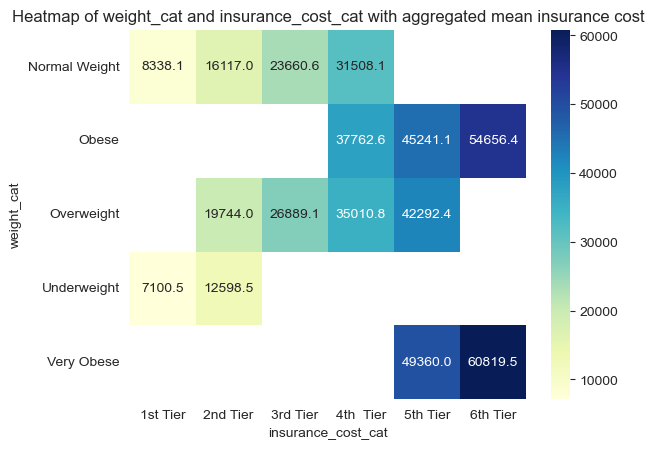

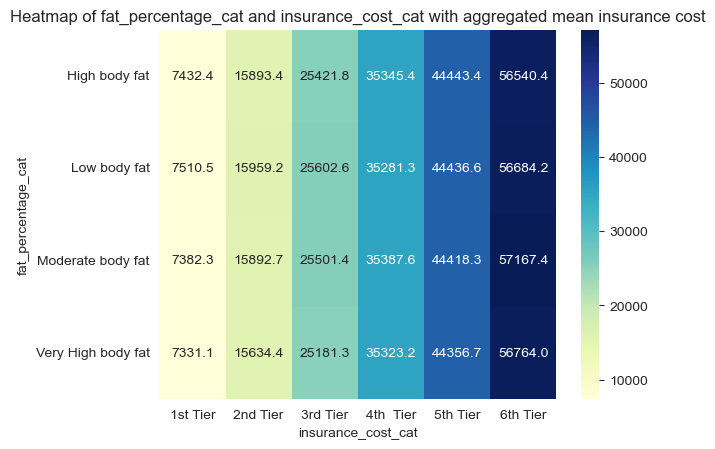

In [86]:
for i,j in cat_pairs:
            pvt=pd.pivot_table(inscost_ieda,values='insurance_cost',index=i,columns=j,aggfunc='mean')
            sns.heatmap(pvt,cmap='YlGnBu',annot=True,fmt='.1f')
            plt.title('Heatmap of {} and {} with aggregated mean insurance cost'.format(i,j))
            plt.show();

Observations:
- People who have had 2 years insurance with us and have had 5 or more regular checkups habe low insurance cost
- People who have had 2 years insurance and are into adventure sports have the highest median insurance cost
- People who are covered by other insurance companies, ad have less number of years of insurance with us tend to have higher insurance costs
- People who are into adventure sports and have no regular checkups have high insurance cost
- People who have not had regular checkups, but have visited doctor for 5 times have the highest insurance mean
- People who have heart and other diseases, by have 5 or more regular checkups have low insurance cost
- People who do not consume alcohol, and have regular checkups have low insurance cost
- People who engage in adventure sporats and who have visited doctor more than 2 times have high insurance cost
- Business people with Very active walking habits havehigh insurance cost
- People who have a cholestertol level of 225-250 and have had heart disease hame higher insurance cost
- People who have a very active lifestyle based on the daily average steps, and have cholesterol ranging from 150-175 have a high mean insurance cost
- People who have a habit of daily alcohol consumption and have a very active lifestyle have a higher insurance cost
- Whne people belong to the very obese weight category, the insurance cost tier is 5 or above
- When they are underweight, their insurance tier is 2 or below

In [87]:
binry_pairs=list(itertools.combinations(binry,2))

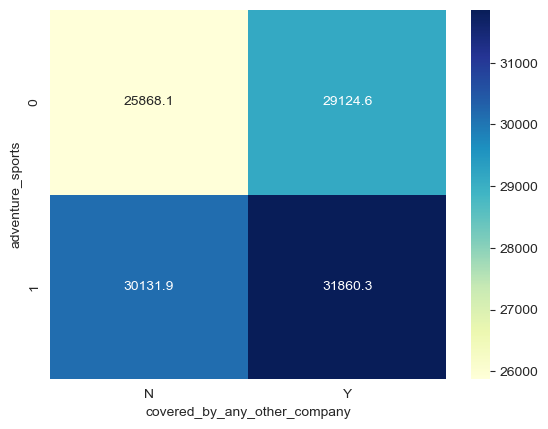

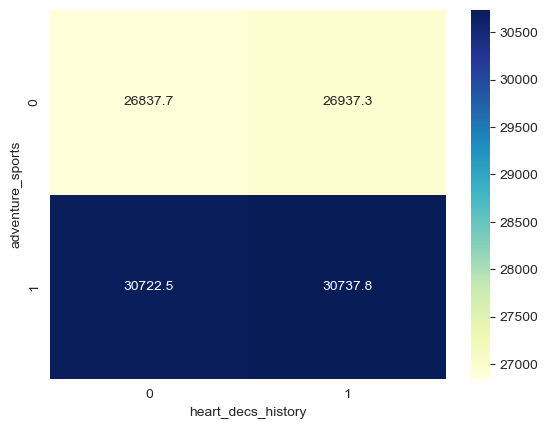

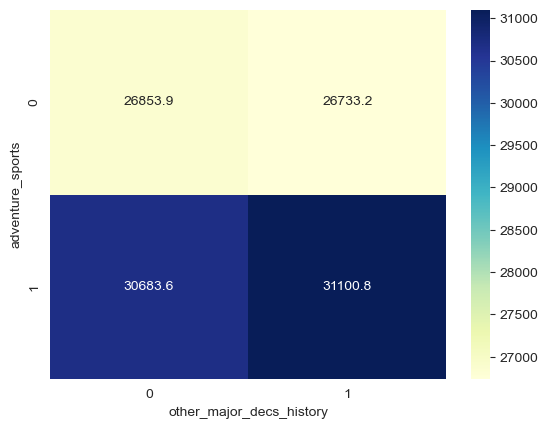

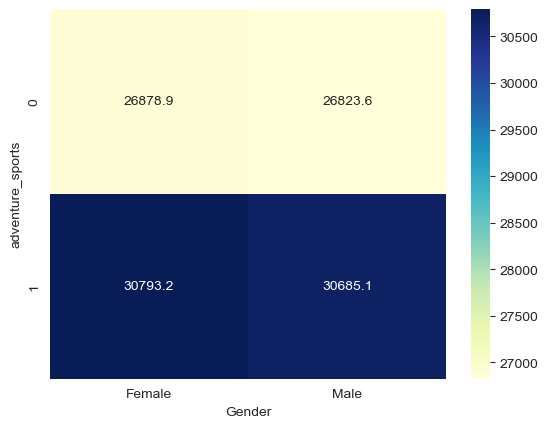

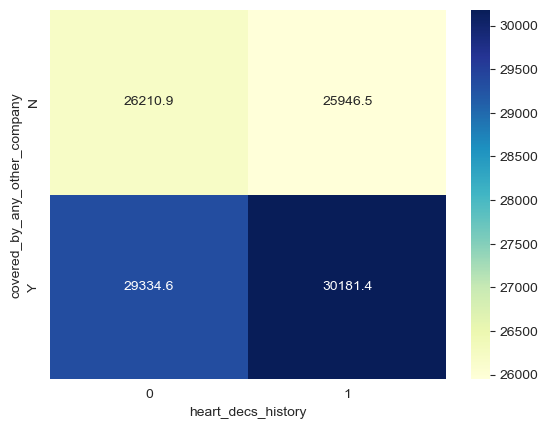

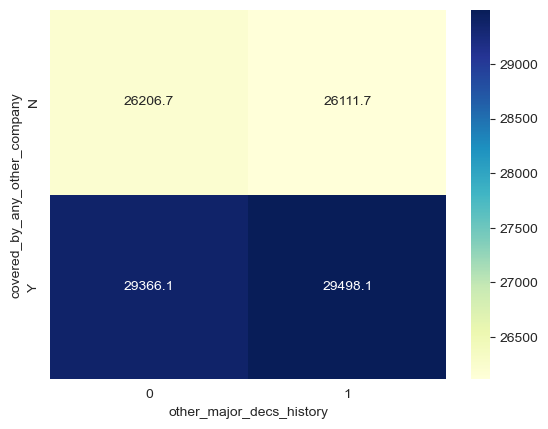

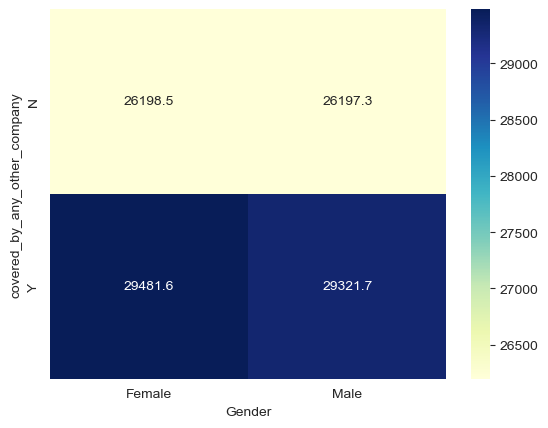

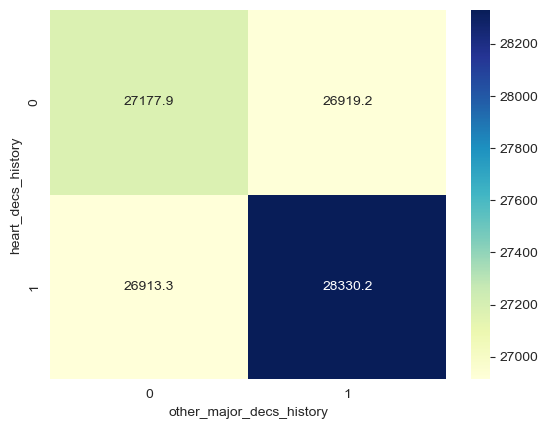

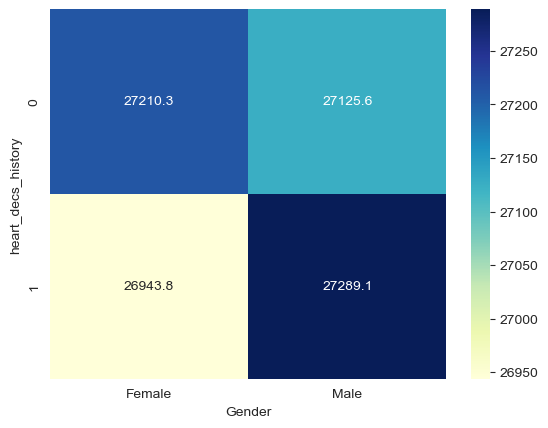

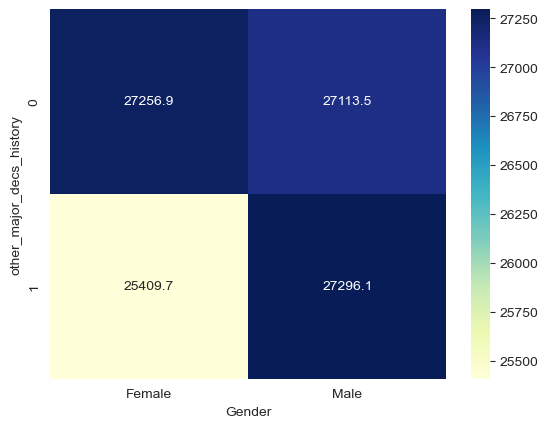

In [88]:
for i,j in binry_pairs:
            pvt=pd.pivot_table(inscost_ieda,values='insurance_cost',index=i,columns=j,aggfunc='mean')
            sns.heatmap(pvt,cmap='YlGnBu',annot=True,fmt='.1f')
            plt.show();

Observations:

From the heatmaps generated by pivoting the binary categorical variables against one another  , and using mean as the aggreagte measuree observe that people who have a history of both heart disease and other major disease have a higher mean insurance cost

<AxesSubplot:xlabel='exercise-fat_percentage_cat', ylabel='Gender-smoking_status'>

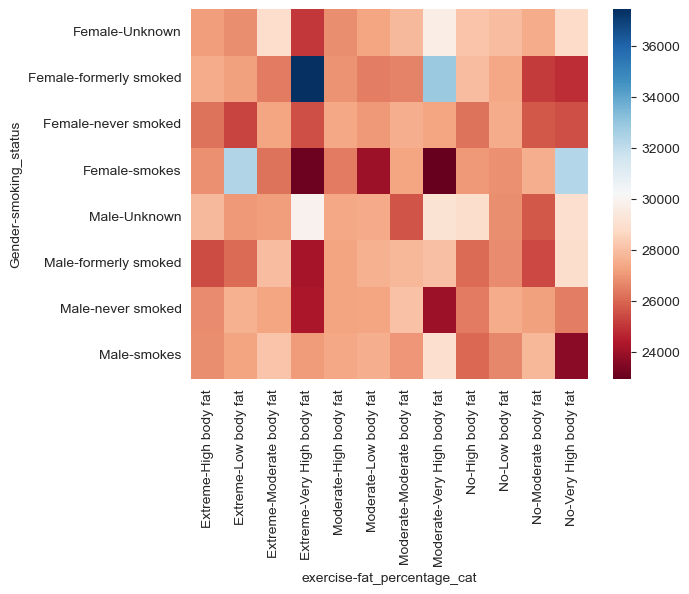

In [89]:
pvt=pd.pivot_table(inscost_ieda,values='insurance_cost',index=['Gender','smoking_status'],columns=['exercise','fat_percentage_cat'])
sns.heatmap(pvt,cmap='RdBu')

<AxesSubplot:xlabel='exercise-fat_percentage_cat', ylabel='smoking_status'>

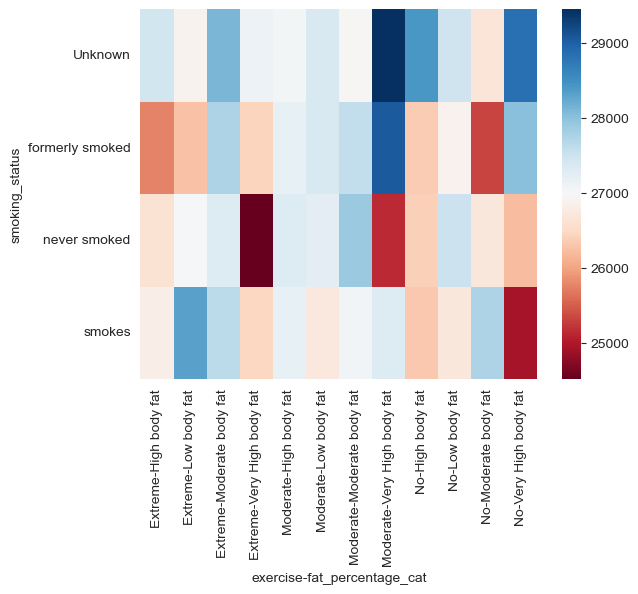

In [90]:
pvt=pd.pivot_table(inscost_ieda,values='insurance_cost',index=['smoking_status'],columns=['exercise','fat_percentage_cat'])
sns.heatmap(pvt,cmap='RdBu')

<AxesSubplot:xlabel='exercise', ylabel='smoking_status'>

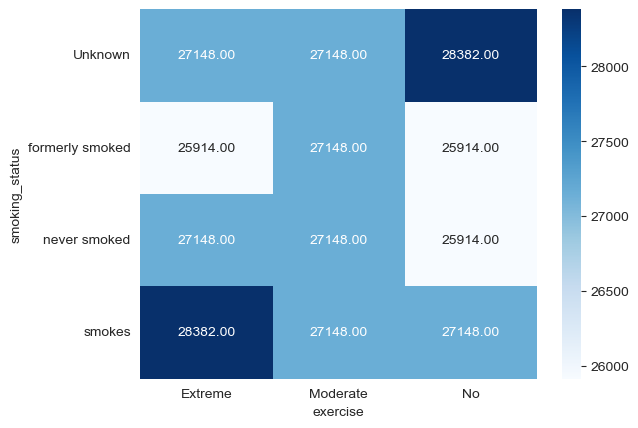

In [91]:
pvt=pd.pivot_table(inscost_ieda,values='insurance_cost',index=['smoking_status'],columns=['exercise'],aggfunc='median')
sns.heatmap(pvt,cmap='Blues',annot=True,fmt='.2f')

<AxesSubplot:xlabel='Gender', ylabel='smoking_status'>

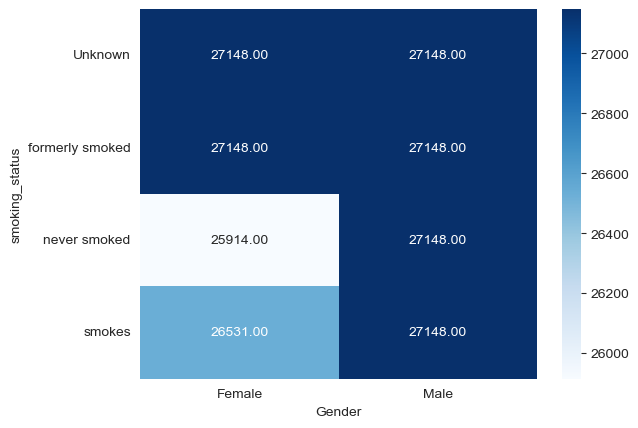

In [92]:
pvt=pd.pivot_table(inscost_ieda,values='insurance_cost',index=['smoking_status'],columns=['Gender'],aggfunc='median')
sns.heatmap(pvt,cmap='Blues',annot=True,fmt='.2f')

<AxesSubplot:xlabel='smoking_status', ylabel='Gender'>

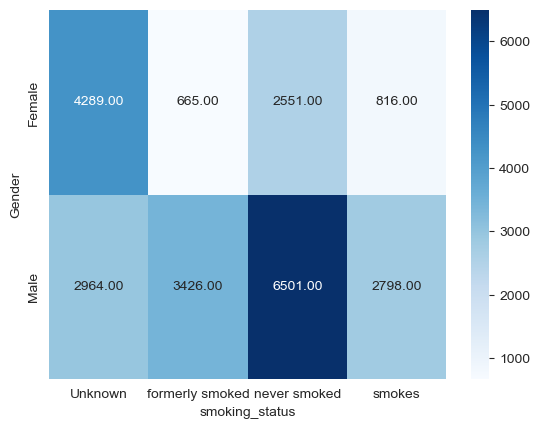

In [93]:
ct=pd.crosstab(index=inscost_ieda['Gender'],columns=inscost_ieda['smoking_status'])
sns.heatmap(ct,annot=True,fmt='.2f',cmap='Blues')

<AxesSubplot:xlabel='weight_cat', ylabel='Gender'>

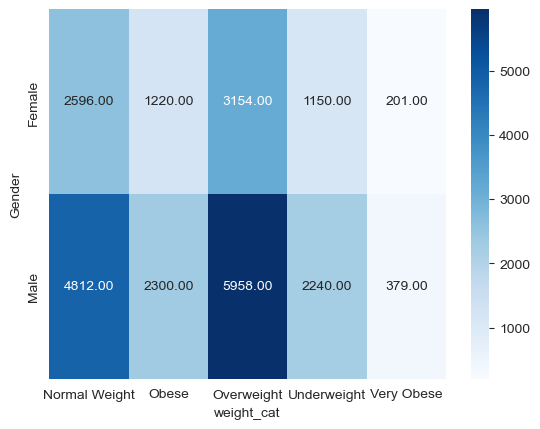

In [94]:
ct=pd.crosstab(index=inscost_ieda['Gender'],columns=inscost_ieda['weight_cat'])
sns.heatmap(ct,annot=True,fmt='.2f',cmap='Blues')

<AxesSubplot:xlabel='insurance_cost_cat', ylabel='Gender'>

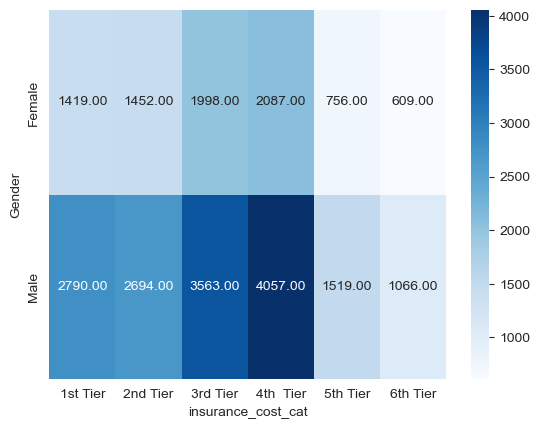

In [95]:
ct=pd.crosstab(index=inscost_ieda['Gender'],columns=inscost_ieda['insurance_cost_cat'])
sns.heatmap(ct,annot=True,fmt='.2f',cmap='Blues')

<AxesSubplot:xlabel='insurance_cost_cat', ylabel='weight_cat'>

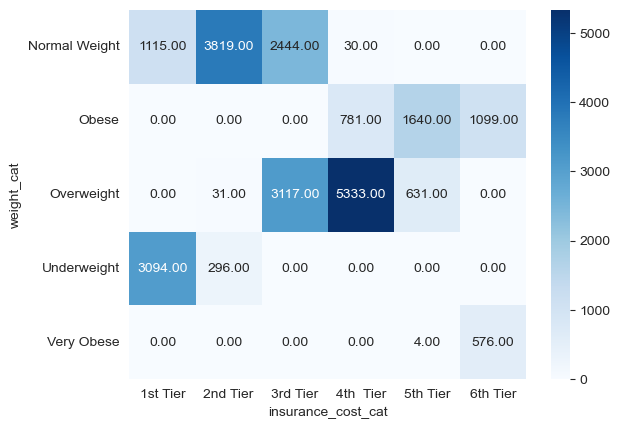

In [96]:
ct=pd.crosstab(index=inscost_ieda['weight_cat'],columns=inscost_ieda['insurance_cost_cat'])
sns.heatmap(ct,annot=True,fmt='.2f',cmap='Blues')

<AxesSubplot:xlabel='insurance_cost_cat', ylabel='covered_by_any_other_company'>

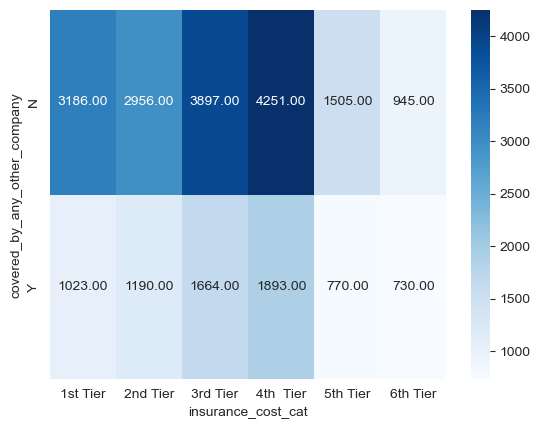

In [97]:
ct=pd.crosstab(index=inscost_ieda['covered_by_any_other_company'],columns=inscost_ieda['insurance_cost_cat'])
sns.heatmap(ct,annot=True,fmt='.2f',cmap='Blues')

## Scaling

In [98]:
inscost_i[num_cols].describe().round(2).T

,count,mean,std,min,25%,50%,75%,max
daily_avg_steps,24010.0,5215.86,1053.56,2034.0,4543.0,5089.0,5730.75,11255.0
age,24010.0,44.92,16.09,16.0,31.0,45.0,59.00,74.0
avg_glucose_level,24010.0,167.53,62.73,57.0,113.0,168.0,222.00,277.0
weight,24010.0,71.62,9.33,52.0,64.0,72.0,78.00,96.0
bmi,24010.0,31.39,7.88,12.3,26.1,30.5,35.60,100.6
fat_percentage,24010.0,28.82,8.63,11.0,21.0,31.0,36.00,42.0
insurance_cost,24010.0,27160.64,14332.04,2468.0,16042.0,27148.0,37020.00,67870.0


In [99]:
cols_to_scale=['daily_avg_steps',
 'age',
 'avg_glucose_level',
 'bmi',
 'weight',
 'fat_percentage']

In [100]:
inscost_scaled=inscost_i[cols_to_scale]

In [101]:
from sklearn.preprocessing import StandardScaler

In [102]:
scaler=StandardScaler()

In [103]:
inscost_scaled=scaler.fit_transform(inscost_scaled)

In [104]:
inscost_scaled=pd.DataFrame(inscost_scaled,columns=cols_to_scale)

In [105]:
inscost_scaled

,daily_avg_steps,age,avg_glucose_level,bmi,weight,fat_percentage
0,-0.332085,-1.051680,-1.124469,-0.024545,-0.494891,-0.442882
1,1.134407,0.315844,0.708871,0.356341,-1.459130,-0.211244
2,-0.670945,1.434727,-0.024465,1.143505,0.147936,0.367853
3,0.947417,0.378004,-0.933164,-1.078330,-0.066340,0.946949
4,-0.263744,-0.057117,-0.789685,-0.621267,0.255074,0.599491
...,...,...,...,...,...,...
24005,0.264003,-0.119277,-1.507079,-0.507001,-1.137717,0.831130
24006,0.377906,-1.424641,-0.359249,0.597569,0.790762,1.294407
24007,-0.471616,0.813126,-0.534612,-0.011849,-0.602028,-0.095424
24008,5.278553,-1.113840,-1.618674,-0.608571,0.255074,1.294407


In [106]:
inscost_no_scale=pd.DataFrame(inscost_i.copy())

In [107]:
inscost_no_scale.drop(cols_to_scale,axis=1,inplace=True)

In [108]:
inscost_no_scale

,years_of_insurance_with_us,regular_checkup_last_year,adventure_sports,Occupation,visited_doctor_last_1_year,cholesterol_level,heart_decs_history,other_major_decs_history,Gender,smoking_status,Location,covered_by_any_other_company,Alcohol,exercise,weight_change_in_last_one_year,insurance_cost
0,3,1,1,Salaried,2,125 to 150,1,0,Male,Unknown,Chennai,N,Rare,Moderate,1,20978
1,0,0,0,Student,4,150 to 175,0,0,Male,formerly smoked,Jaipur,N,Rare,Moderate,3,6170
2,1,0,0,Business,4,200 to 225,0,0,Female,formerly smoked,Jaipur,N,Daily,Extreme,0,28382
3,7,4,0,Business,2,175 to 200,0,0,Female,Unknown,Chennai,Y,Rare,No,3,27148
4,3,1,0,Student,2,150 to 175,0,1,Male,never smoked,Bangalore,N,No,Extreme,0,29616
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24994,7,0,0,Business,3,150 to 175,0,0,Female,Unknown,Mumbai,N,Rare,Moderate,5,13574
24995,3,0,0,Salaried,4,225 to 250,0,0,Male,smokes,Kanpur,Y,Rare,Moderate,4,39488
24996,6,0,0,Business,4,200 to 225,0,0,Male,never smoked,Kanpur,N,Rare,Moderate,2,14808
24998,1,0,0,Salaried,2,225 to 250,0,0,Male,Unknown,Surat,N,Rare,Moderate,0,30850


In [109]:
len(inscost_no_scale.columns)

16

In [110]:
len(inscost_scaled.columns)

6

In [111]:
colms=['years_of_insurance_with_us', 'regular_checkup_last_year',
       'adventure_sports', 'Occupation', 'visited_doctor_last_1_year',
       'cholesterol_level', 'heart_decs_history', 'other_major_decs_history',
       'Gender', 'bmi', 'smoking_status', 'Location',
       'covered_by_any_other_company', 'Alcohol', 'exercise',
       'weight_change_in_last_one_year', 'insurance_cost','daily_avg_steps', 'age', 'avg_glucose_level', 'weight',
       'fat_percentage']
len(colms)

22

In [112]:
inscost_no_scale.reset_index(drop=True, inplace=True)
inscost_scaled.reset_index(drop=True, inplace=True)
inscost_is = pd.concat([inscost_no_scale, inscost_scaled], axis=1, ignore_index=True)

In [113]:
colms=list(inscost_no_scale.columns)+list(inscost_scaled.columns)

In [114]:
inscost_is.columns=colms

In [115]:
inscost_is

,years_of_insurance_with_us,regular_checkup_last_year,adventure_sports,Occupation,visited_doctor_last_1_year,cholesterol_level,heart_decs_history,other_major_decs_history,Gender,smoking_status,Location,covered_by_any_other_company,Alcohol,exercise,weight_change_in_last_one_year,insurance_cost,daily_avg_steps,age,avg_glucose_level,bmi,weight,fat_percentage
0,3,1,1,Salaried,2,125 to 150,1,0,Male,Unknown,Chennai,N,Rare,Moderate,1,20978,-0.332085,-1.051680,-1.124469,-0.024545,-0.494891,-0.442882
1,0,0,0,Student,4,150 to 175,0,0,Male,formerly smoked,Jaipur,N,Rare,Moderate,3,6170,1.134407,0.315844,0.708871,0.356341,-1.459130,-0.211244
2,1,0,0,Business,4,200 to 225,0,0,Female,formerly smoked,Jaipur,N,Daily,Extreme,0,28382,-0.670945,1.434727,-0.024465,1.143505,0.147936,0.367853
3,7,4,0,Business,2,175 to 200,0,0,Female,Unknown,Chennai,Y,Rare,No,3,27148,0.947417,0.378004,-0.933164,-1.078330,-0.066340,0.946949
4,3,1,0,Student,2,150 to 175,0,1,Male,never smoked,Bangalore,N,No,Extreme,0,29616,-0.263744,-0.057117,-0.789685,-0.621267,0.255074,0.599491
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24005,7,0,0,Business,3,150 to 175,0,0,Female,Unknown,Mumbai,N,Rare,Moderate,5,13574,0.264003,-0.119277,-1.507079,-0.507001,-1.137717,0.831130
24006,3,0,0,Salaried,4,225 to 250,0,0,Male,smokes,Kanpur,Y,Rare,Moderate,4,39488,0.377906,-1.424641,-0.359249,0.597569,0.790762,1.294407
24007,6,0,0,Business,4,200 to 225,0,0,Male,never smoked,Kanpur,N,Rare,Moderate,2,14808,-0.471616,0.813126,-0.534612,-0.011849,-0.602028,-0.095424
24008,1,0,0,Salaried,2,225 to 250,0,0,Male,Unknown,Surat,N,Rare,Moderate,0,30850,5.278553,-1.113840,-1.618674,-0.608571,0.255074,1.294407


In [116]:
inscost.shape

(25000, 24)

In [117]:
inscost_is.shape

(24010, 22)

## Outlier Treatment

<AxesSubplot:>

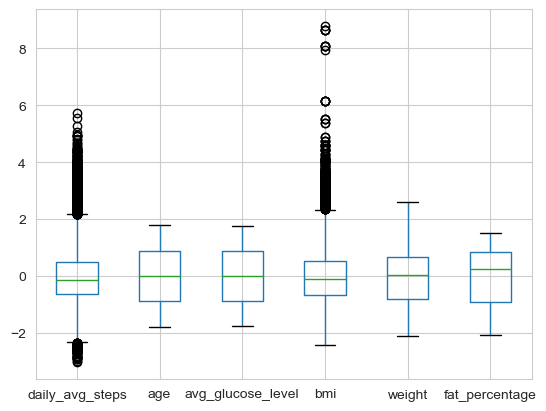

In [118]:
inscost_is[cols_to_scale].boxplot()

In [119]:
outlier_cols=['daily_avg_steps','bmi']

In [120]:
Q1 = inscost_is[num].quantile(0.25)
Q3 = inscost_is[num].quantile(0.75)
IQR = Q3 - Q1
UL = Q3 + 1.5*IQR
LL = Q1 - 1.5*IQR

In [121]:
((inscost_is[num]>UL)|(inscost_is[num]<LL)).sum()

daily_avg_steps      899
age                    0
avg_glucose_level      0
weight                 0
bmi                  549
fat_percentage         0
insurance_cost         0
dtype: int64

In [122]:
899/24010

0.03744273219491878

In [123]:
def treat_outlier(x):
    q1=np.percentile(x,25)
    q3=np.percentile(x,75)
    IQR=q3-q1
    ll=q1-(1.5*IQR)
    ul=q3+(1.5*IQR)
    return x.apply(lambda y:ll if y<ll else y).apply(lambda y:ul if y>ul else y)

In [124]:
inscost_iso=pd.DataFrame(inscost_is.copy())

In [125]:
inscost_iso

,years_of_insurance_with_us,regular_checkup_last_year,adventure_sports,Occupation,visited_doctor_last_1_year,cholesterol_level,heart_decs_history,other_major_decs_history,Gender,smoking_status,Location,covered_by_any_other_company,Alcohol,exercise,weight_change_in_last_one_year,insurance_cost,daily_avg_steps,age,avg_glucose_level,bmi,weight,fat_percentage
0,3,1,1,Salaried,2,125 to 150,1,0,Male,Unknown,Chennai,N,Rare,Moderate,1,20978,-0.332085,-1.051680,-1.124469,-0.024545,-0.494891,-0.442882
1,0,0,0,Student,4,150 to 175,0,0,Male,formerly smoked,Jaipur,N,Rare,Moderate,3,6170,1.134407,0.315844,0.708871,0.356341,-1.459130,-0.211244
2,1,0,0,Business,4,200 to 225,0,0,Female,formerly smoked,Jaipur,N,Daily,Extreme,0,28382,-0.670945,1.434727,-0.024465,1.143505,0.147936,0.367853
3,7,4,0,Business,2,175 to 200,0,0,Female,Unknown,Chennai,Y,Rare,No,3,27148,0.947417,0.378004,-0.933164,-1.078330,-0.066340,0.946949
4,3,1,0,Student,2,150 to 175,0,1,Male,never smoked,Bangalore,N,No,Extreme,0,29616,-0.263744,-0.057117,-0.789685,-0.621267,0.255074,0.599491
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24005,7,0,0,Business,3,150 to 175,0,0,Female,Unknown,Mumbai,N,Rare,Moderate,5,13574,0.264003,-0.119277,-1.507079,-0.507001,-1.137717,0.831130
24006,3,0,0,Salaried,4,225 to 250,0,0,Male,smokes,Kanpur,Y,Rare,Moderate,4,39488,0.377906,-1.424641,-0.359249,0.597569,0.790762,1.294407
24007,6,0,0,Business,4,200 to 225,0,0,Male,never smoked,Kanpur,N,Rare,Moderate,2,14808,-0.471616,0.813126,-0.534612,-0.011849,-0.602028,-0.095424
24008,1,0,0,Salaried,2,225 to 250,0,0,Male,Unknown,Surat,N,Rare,Moderate,0,30850,5.278553,-1.113840,-1.618674,-0.608571,0.255074,1.294407


In [126]:
inscost_iso['daily_avg_steps']=treat_outlier(inscost_iso['daily_avg_steps'])
inscost_iso['bmi']=treat_outlier(inscost_iso['bmi'])

<AxesSubplot:>

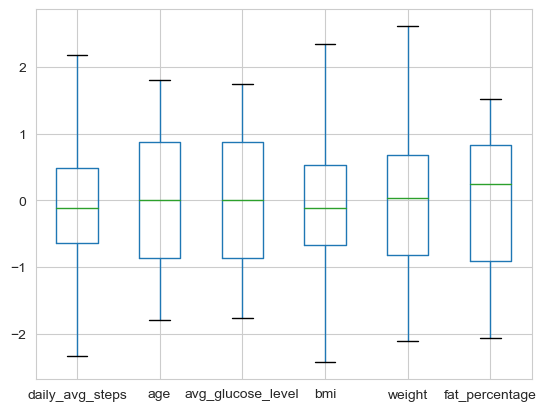

In [127]:
inscost_iso[cols_to_scale].boxplot()

In [128]:
inscost_iso.describe().T.round(2)

,count,mean,std,min,25%,50%,75%,max
years_of_insurance_with_us,24010.0,4.09,2.61,0.00,2.00,4.00,6.00,8.00
regular_checkup_last_year,24010.0,0.77,1.20,0.00,0.00,0.00,1.00,5.00
adventure_sports,24010.0,0.08,0.27,0.00,0.00,0.00,0.00,1.00
visited_doctor_last_1_year,24010.0,3.11,1.14,0.00,2.00,3.00,4.00,12.00
heart_decs_history,24010.0,0.05,0.22,0.00,0.00,0.00,0.00,1.00
other_major_decs_history,24010.0,0.09,0.29,0.00,0.00,0.00,0.00,1.00
weight_change_in_last_one_year,24010.0,2.52,1.69,0.00,1.00,3.00,4.00,6.00
insurance_cost,24010.0,27160.64,14332.04,2468.00,16042.00,27148.00,37020.00,67870.00
daily_avg_steps,24010.0,-0.03,0.92,-2.33,-0.64,-0.12,0.49,2.18
age,24010.0,-0.00,1.00,-1.80,-0.87,0.01,0.88,1.81


In [129]:
inscost_iso.shape

(24010, 22)

## Encoding- Transformation

In [130]:
inscost_isoen=pd.DataFrame(inscost_iso.copy())

In [131]:
ohe_cols=['Occupation',  'Gender', 'smoking_status','Alcohol', 'exercise',
       'Location', 'covered_by_any_other_company']

In [132]:
label_enc_cols=['cholesterol_level']

In [133]:
nenc_cols=['years_of_insurance_with_us', 'regular_checkup_last_year','cholesterol_level',
       'adventure_sports',  'visited_doctor_last_1_year',
        'daily_avg_steps', 'age', 'heart_decs_history',
       'other_major_decs_history',  'avg_glucose_level', 'bmi',
        'weight',  'weight_change_in_last_one_year',
       'fat_percentage', 'insurance_cost']

In [134]:
onehot_enc_cols=pd.get_dummies(inscost_isoen[ohe_cols],drop_first=True)

In [135]:
inscost_isoen=pd.concat([inscost_isoen[nenc_cols],onehot_enc_cols],axis=1)

inscost_isoen['exercise'].value_counts()

In [136]:
inscost_isoen['cholesterol_level']=np.where(inscost_isoen['cholesterol_level']=='125 to 150',1,inscost_isoen['cholesterol_level'])
inscost_isoen['cholesterol_level']=np.where(inscost_isoen['cholesterol_level']=='150 to 175',2,inscost_isoen['cholesterol_level'])
inscost_isoen['cholesterol_level']=np.where(inscost_isoen['cholesterol_level']=='175 to 200',3,inscost_isoen['cholesterol_level'])
inscost_isoen['cholesterol_level']=np.where(inscost_isoen['cholesterol_level']=='200 to 225',4,inscost_isoen['cholesterol_level'])
inscost_isoen['cholesterol_level']=np.where(inscost_isoen['cholesterol_level']=='225 to 250',5,inscost_isoen['cholesterol_level'])

inscost_isoen['smoking_status']=np.where(inscost_isoen['smoking_status']=='never smoked',1,inscost_isoen['smoking_status'])
inscost_isoen['smoking_status']=np.where(inscost_isoen['smoking_status']=='formerly smoked',2,inscost_isoen['smoking_status'])
inscost_isoen['smoking_status']=np.where(inscost_isoen['smoking_status']=='smokes',3,inscost_isoen['smoking_status'])
inscost_isoen['smoking_status']=np.where(inscost_isoen['smoking_status']=='Unknown',4,inscost_isoen['smoking_status'])

inscost_isoen['Alcohol']=np.where(inscost_isoen['Alcohol']=='No',1,inscost_isoen['Alcohol'])
inscost_isoen['Alcohol']=np.where(inscost_isoen['Alcohol']=='Rare',2,inscost_isoen['Alcohol'])
inscost_isoen['Alcohol']=np.where(inscost_isoen['Alcohol']=='Daily',3,inscost_isoen['Alcohol'])

inscost_isoen['exercise']=np.where(inscost_isoen['exercise']=='No',3,inscost_isoen['exercise'])
inscost_isoen['exercise']=np.where(inscost_isoen['exercise']=='Moderate',2,inscost_isoen['exercise'])
inscost_isoen['exercise']=np.where(inscost_isoen['exercise']=='Extreme',1,inscost_isoen['exercise'])

In [137]:
len(inscost_isoen.columns)

40

column_order=['years_of_insurance_with_us', 'regular_checkup_last_year',
       'adventure_sports', 'visited_doctor_last_1_year', 'daily_avg_steps',
       'age', 'heart_decs_history', 'other_major_decs_history',
       'avg_glucose_level', 'bmi', 'weight', 'weight_change_in_last_one_year',
       'fat_percentage', 'Occupation_Salaried',
       'Occupation_Student', 'cholesterol_level', 'Gender_Male',
       'smoking_status_formerly smoked', 'smoking_status_never smoked',
       'smoking_status_smokes', 'Location_Bangalore', 'Location_Bhubaneswar',
       'Location_Chennai', 'Location_Delhi', 'Location_Guwahati',
       'Location_Jaipur', 'Location_Kanpur', 'Location_Kolkata',
       'Location_Lucknow', 'Location_Mangalore', 'Location_Mumbai',
       'Location_Nagpur', 'Location_Pune', 'Location_Surat',
       'covered_by_any_other_company_Y', 'Alcohol_No', 'Alcohol_Rare',
       'exercise_Moderate', 'exercise_No', 'insurance_cost']

inscost_isoen=inscost_isoen[column_order]

In [138]:
inscost_isoen

,years_of_insurance_with_us,regular_checkup_last_year,cholesterol_level,adventure_sports,visited_doctor_last_1_year,daily_avg_steps,age,heart_decs_history,other_major_decs_history,avg_glucose_level,bmi,weight,weight_change_in_last_one_year,fat_percentage,insurance_cost,Occupation_Salaried,Occupation_Student,Gender_Male,smoking_status_formerly smoked,smoking_status_never smoked,smoking_status_smokes,Alcohol_No,Alcohol_Rare,exercise_Moderate,exercise_No,Location_Bangalore,Location_Bhubaneswar,Location_Chennai,Location_Delhi,Location_Guwahati,Location_Jaipur,Location_Kanpur,Location_Kolkata,Location_Lucknow,Location_Mangalore,Location_Mumbai,Location_Nagpur,Location_Pune,Location_Surat,covered_by_any_other_company_Y
0,3,1,1,1,2,-0.332085,-1.051680,1,0,-1.124469,-0.024545,-0.494891,1,-0.442882,20978,1,0,1,0,0,0,0,1,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,2,0,4,1.134407,0.315844,0,0,0.708871,0.356341,-1.459130,3,-0.211244,6170,0,1,1,1,0,0,0,1,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0
2,1,0,4,0,4,-0.670945,1.434727,0,0,-0.024465,1.143505,0.147936,0,0.367853,28382,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0
3,7,4,3,0,2,0.947417,0.378004,0,0,-0.933164,-1.078330,-0.066340,3,0.946949,27148,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1
4,3,1,2,0,2,-0.263744,-0.057117,0,1,-0.789685,-0.621267,0.255074,0,0.599491,29616,0,1,1,0,1,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24005,7,0,2,0,3,0.264003,-0.119277,0,0,-1.507079,-0.507001,-1.137717,5,0.831130,13574,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0
24006,3,0,5,0,4,0.377906,-1.424641,0,0,-0.359249,0.597569,0.790762,4,1.294407,39488,1,0,1,0,0,1,0,1,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1
24007,6,0,4,0,4,-0.471616,0.813126,0,0,-0.534612,-0.011849,-0.602028,2,-0.095424,14808,0,0,1,0,1,0,0,1,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0
24008,1,0,5,0,2,2.179817,-1.113840,0,0,-1.618674,-0.608571,0.255074,0,1.294407,30850,1,0,1,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0


In [139]:
inscost_isoen.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 24010 entries, 0 to 24009
Data columns (total 40 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   years_of_insurance_with_us      24010 non-null  int64  
 1   regular_checkup_last_year       24010 non-null  int64  
 2   cholesterol_level               24010 non-null  object 
 3   adventure_sports                24010 non-null  int64  
 4   visited_doctor_last_1_year      24010 non-null  int64  
 5   daily_avg_steps                 24010 non-null  float64
 6   age                             24010 non-null  float64
 7   heart_decs_history              24010 non-null  int64  
 8   other_major_decs_history        24010 non-null  int64  
 9   avg_glucose_level               24010 non-null  float64
 10  bmi                             24010 non-null  float64
 11  weight                          24010 non-null  float64
 12  weight_change_in_last_one_year  

In [140]:
inscost_isoen['cholesterol_level']=inscost_isoen['cholesterol_level'].astype('int64')

inscost_isoen['smoking_status']=inscost_isoen['smoking_status'].astype('int64')

inscost_isoen['Alcohol']=inscost_isoen['Alcohol'].astype('int64')

inscost_isoen['exercise']=inscost_isoen['exercise'].astype('int64')

## Recursive Feature Elimination

In [141]:
from sklearn.feature_selection import RFE

In [142]:
inscost_isoenrfe=pd.DataFrame(inscost_isoen.copy())

In [143]:
from sklearn.ensemble import RandomForestRegressor,RandomForestClassifier

In [144]:
X_RFE=inscost_isoenrfe.drop('insurance_cost',axis=1)
Y_RFE=inscost_isoenrfe['insurance_cost']

In [145]:
rfr_rfe=RandomForestRegressor()

In [146]:
selector=RFE(estimator=rfr_rfe,n_features_to_select=15,step=1)

In [147]:
selector.fit(X_RFE,Y_RFE)

RFE(estimator=RandomForestRegressor(), n_features_to_select=15)

In [148]:
selector.n_features_

15

In [149]:
selector.ranking_

array([ 1,  1,  1, 24,  1,  1,  1, 25,  8,  1,  1,  1,  1,  1,  9,  3,  2,
        4,  1,  6,  5,  1,  1,  7, 12, 15, 18, 10, 13, 19, 17, 22, 21, 11,
       23, 14, 16, 20,  1])

In [150]:
rfe_df=pd.DataFrame({'Features':X_RFE.columns,'Rank':selector.ranking_})
rfe_df

,Features,Rank
0,years_of_insurance_with_us,1
1,regular_checkup_last_year,1
2,cholesterol_level,1
3,adventure_sports,24
4,visited_doctor_last_1_year,1
5,daily_avg_steps,1
6,age,1
7,heart_decs_history,25
8,other_major_decs_history,8
9,avg_glucose_level,1


In [151]:
rfe_sel_df=rfe_df[rfe_df['Rank']==1]

In [152]:
rfe_sel_df

,Features,Rank
0,years_of_insurance_with_us,1
1,regular_checkup_last_year,1
2,cholesterol_level,1
4,visited_doctor_last_1_year,1
5,daily_avg_steps,1
6,age,1
9,avg_glucose_level,1
10,bmi,1
11,weight,1
12,weight_change_in_last_one_year,1


In [153]:
# selected_features=[]
selected_features=rfe_sel_df['Features'].values

In [154]:
selected_features

array(['years_of_insurance_with_us', 'regular_checkup_last_year',
       'cholesterol_level', 'visited_doctor_last_1_year',
       'daily_avg_steps', 'age', 'avg_glucose_level', 'bmi', 'weight',
       'weight_change_in_last_one_year', 'fat_percentage',
       'smoking_status_never smoked', 'Alcohol_Rare', 'exercise_Moderate',
       'covered_by_any_other_company_Y'], dtype=object)

## Clustering

In [155]:
inscost_clip=pd.DataFrame(inscost_isoen[selected_features])

In [156]:
from sklearn.cluster import KMeans

In [157]:
wss=[]
for i in range(1,26):
    KM=KMeans(n_clusters=i,random_state=40)
    KM.fit(inscost_clip)
    wss.append(KM.inertia_)

In [158]:
a=np.arange(1,26,1)
a

array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19, 20, 21, 22, 23, 24, 25])

<AxesSubplot:>

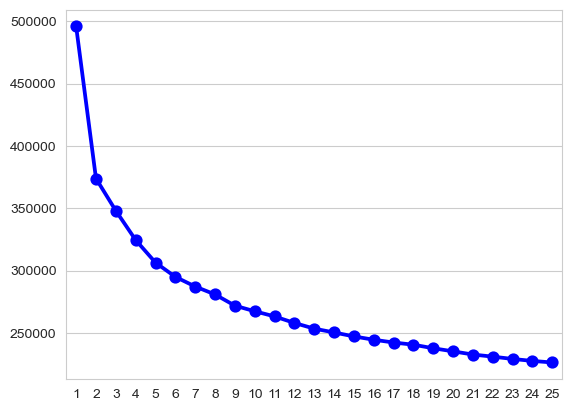

In [159]:
sns.pointplot(x=a,y=wss,color='blue')

In [160]:
from sklearn.metrics import silhouette_samples, silhouette_score

In [161]:
sil_score=[]
for i in range(2,11):
    k_means=KMeans(n_clusters=i,random_state=100)
    k_means.fit(inscost_clip)
    labels=k_means.labels_
    ss=silhouette_score(inscost_clip,labels,random_state=100)
    sil_score.append(ss)
    print(i,ss)

2 0.215487446763799
3 0.15303639293927696
4 0.11468112110484634
5 0.10757769877696052
6 0.09776982585064638
7 0.09690802673988083
8 0.0959059400935117
9 0.09596619258581414
10 0.09514078469751373


In [170]:
k_means_fin=KMeans(n_clusters=3,random_state=100)
k_means_fin.fit(inscost_clip)
labels_fin=k_means_fin.labels_

In [171]:
labels_fin

array([1, 1, 1, ..., 2, 1, 0])

print(silhouette_score(inscost_clip,labels_fin,random_state=100))

In [172]:
inscost_clip['Cluster']=labels_fin

In [173]:
##for i in range(0,5):
##    print(inscost_clip[inscost_clip['Cluster']==i].describe().round(2).T)

In [174]:
inscost_cluster_eda=pd.DataFrame(inscost_ieda.copy())

In [175]:
inscost_cluster_eda['Cluster']=labels_fin

In [176]:
inscost_cluster_eda[['years_of_insurance_with_us',
 'regular_checkup_last_year',
 'adventure_sports',
  'visited_doctor_last_1_year',
  'heart_decs_history',
 'other_major_decs_history',
  'covered_by_any_other_company',
  'weight_change_in_last_one_year']]=inscost_cluster_eda[['years_of_insurance_with_us',
 'regular_checkup_last_year',
 'adventure_sports',
  'visited_doctor_last_1_year',
  'heart_decs_history',
 'other_major_decs_history',
  'covered_by_any_other_company',
  'weight_change_in_last_one_year']].astype('object')

In [177]:
# Cluster profiling
cluster_profiles_mean = inscost_cluster_eda.groupby('Cluster')[num].mean().round(2).T
cluster_profiles_mean

Cluster,0,1,2
daily_avg_steps,5235.45,5214.43,5197.58
age,44.99,44.73,45.12
avg_glucose_level,168.03,166.98,167.84
weight,68.27,71.90,74.70
bmi,31.36,31.52,31.24
fat_percentage,28.98,28.85,28.62
insurance_cost,22381.91,27417.36,31759.32


In [178]:
cluster_profiles_median = inscost_cluster_eda.groupby('Cluster')[num].median().round(2).T
cluster_profiles_median

Cluster,0,1,2
daily_avg_steps,5112.5,5094.0,5058.0
age,45.0,44.0,45.0
avg_glucose_level,168.0,168.0,168.0
weight,67.0,72.0,75.0
bmi,30.6,30.6,30.3
fat_percentage,31.0,31.0,29.0
insurance_cost,19744.0,27148.0,30850.0


In [179]:
cluster_profiles_freq = inscost_cluster_eda.groupby('Cluster')[cat].apply(lambda x: x.mode().iloc[0]).T
cluster_profiles_freq

Cluster,0,1,2
0,,,
years_of_insurance_with_us,5,0,8
regular_checkup_last_year,0,0,0
adventure_sports,0,0,0
Occupation,Student,Student,Business
visited_doctor_last_1_year,2,2,2
cholesterol_level,150 to 175,150 to 175,150 to 175
heart_decs_history,0,0,0
other_major_decs_history,0,0,0
Gender,Male,Male,Male


## Advanced EDA based on clusters

In [180]:
inscost_cluster_eda.columns

Index(['years_of_insurance_with_us', 'regular_checkup_last_year',
       'adventure_sports', 'Occupation', 'visited_doctor_last_1_year',
       'cholesterol_level', 'daily_avg_steps', 'age', 'heart_decs_history',
       'other_major_decs_history', 'Gender', 'avg_glucose_level', 'bmi',
       'smoking_status', 'Location', 'weight', 'covered_by_any_other_company',
       'Alcohol', 'exercise', 'weight_change_in_last_one_year',
       'fat_percentage', 'avg_step_cat', 'weight_cat', 'fat_percentage_cat',
       'insurance_cost_cat', 'insurance_cost', 'Cluster'],
      dtype='object')

<AxesSubplot:xlabel='Cluster', ylabel='insurance_cost'>

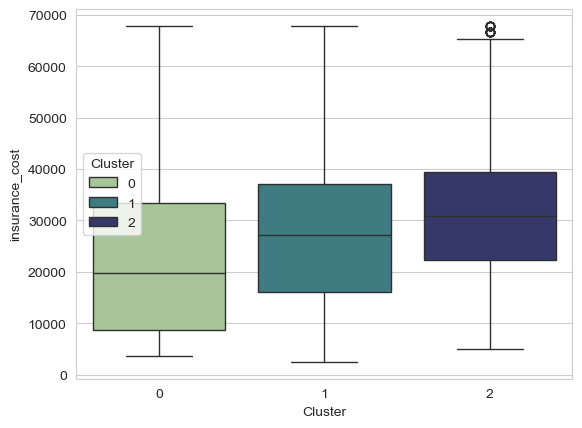

In [181]:
sns.boxplot(x=inscost_cluster_eda['Cluster'],y=inscost_cluster_eda['insurance_cost'],hue=inscost_cluster_eda['Cluster'],palette='crest')

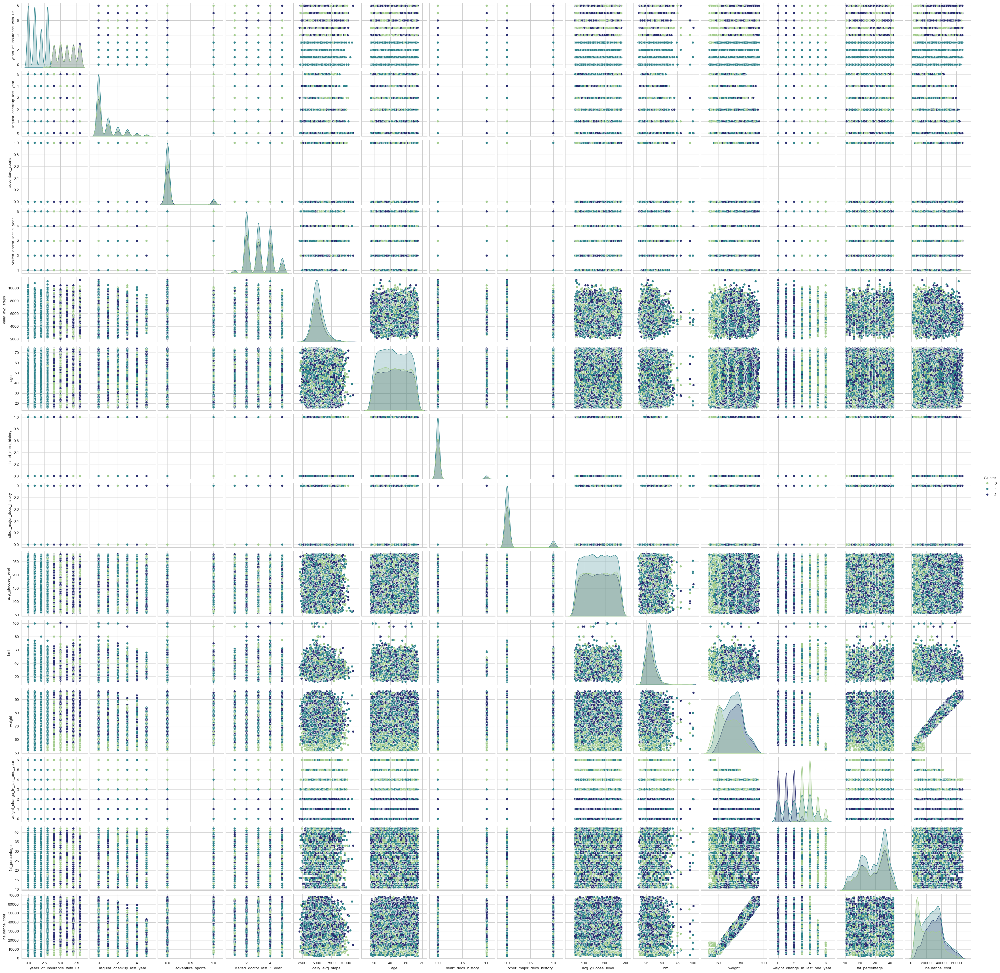

In [422]:
sns.pairplot(data=inscost_cluster_eda,hue='Cluster',palette='crest')

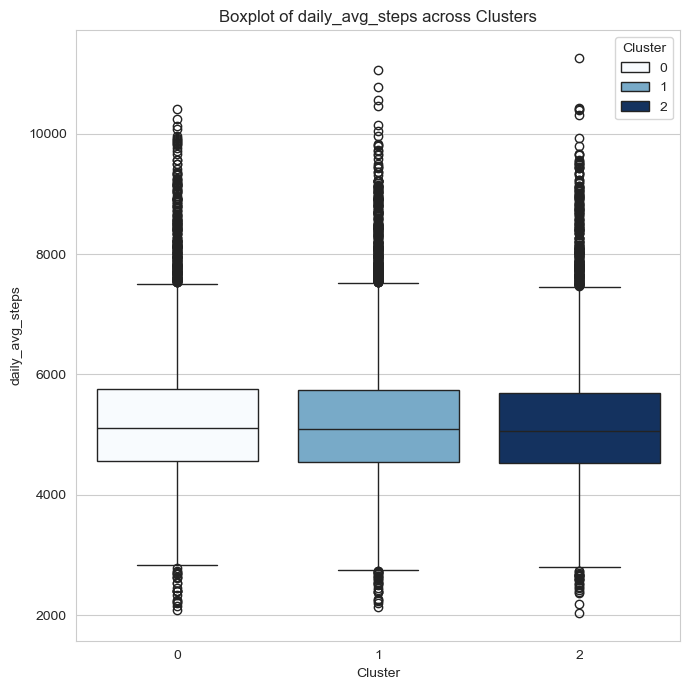

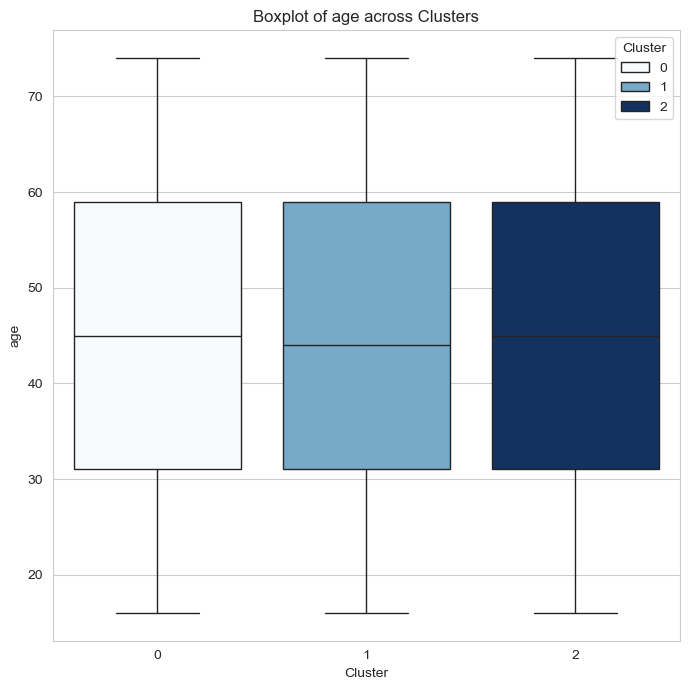

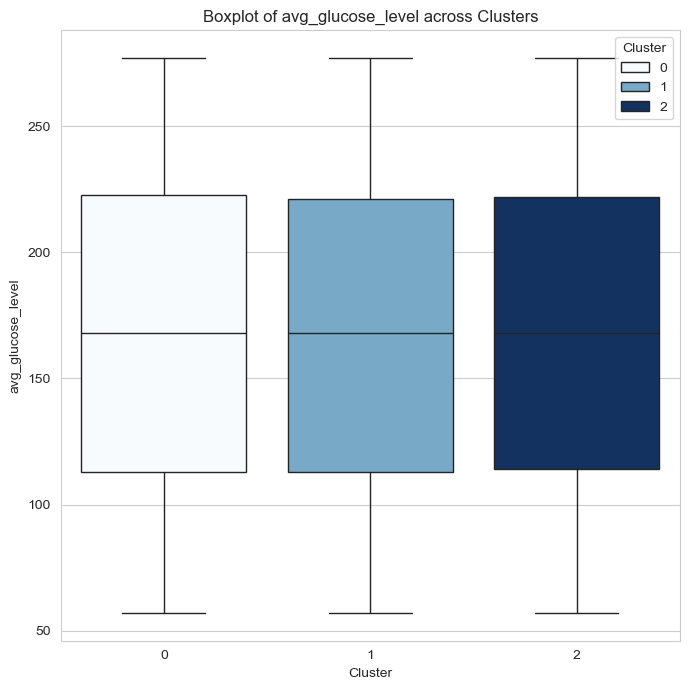

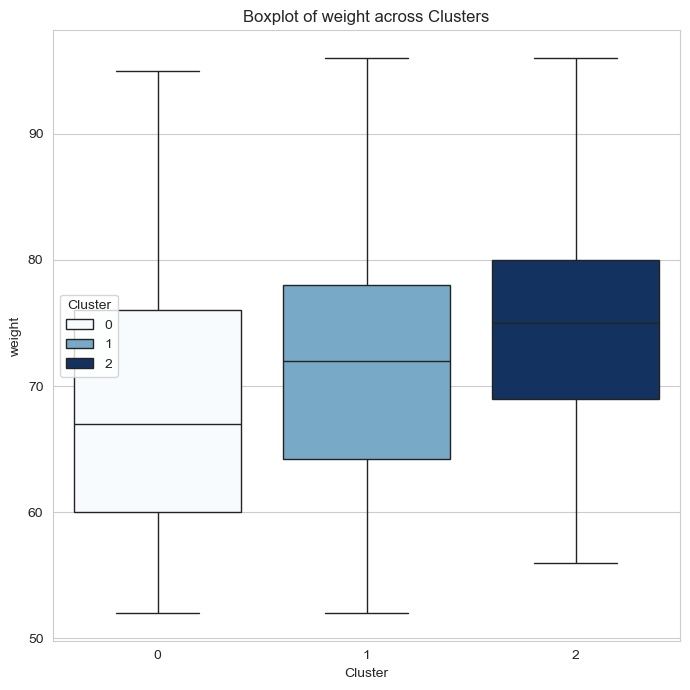

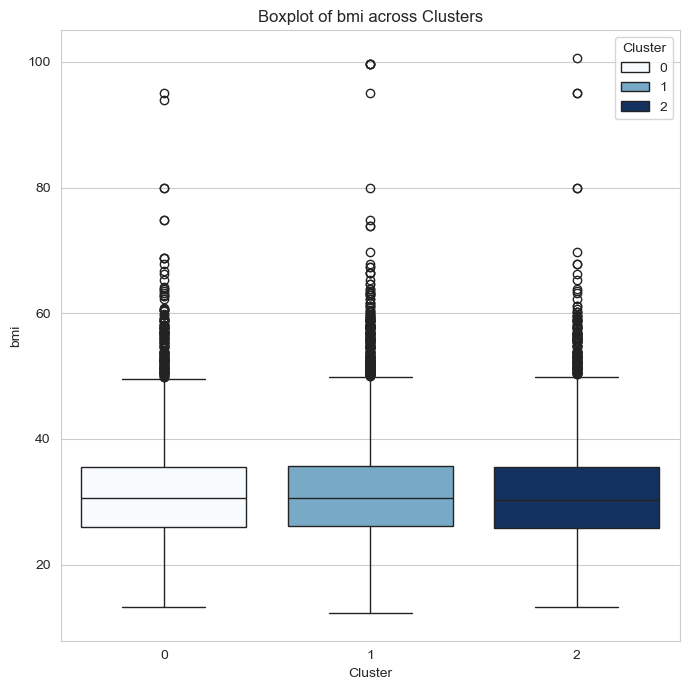

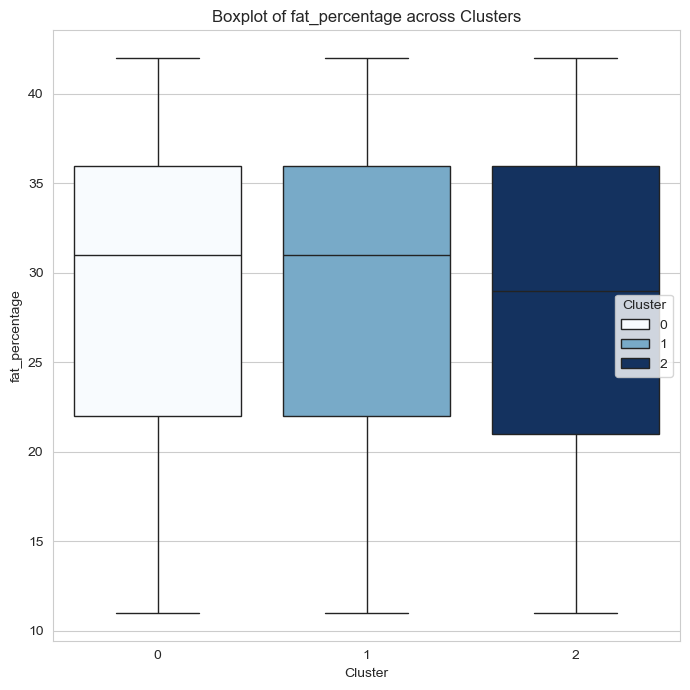

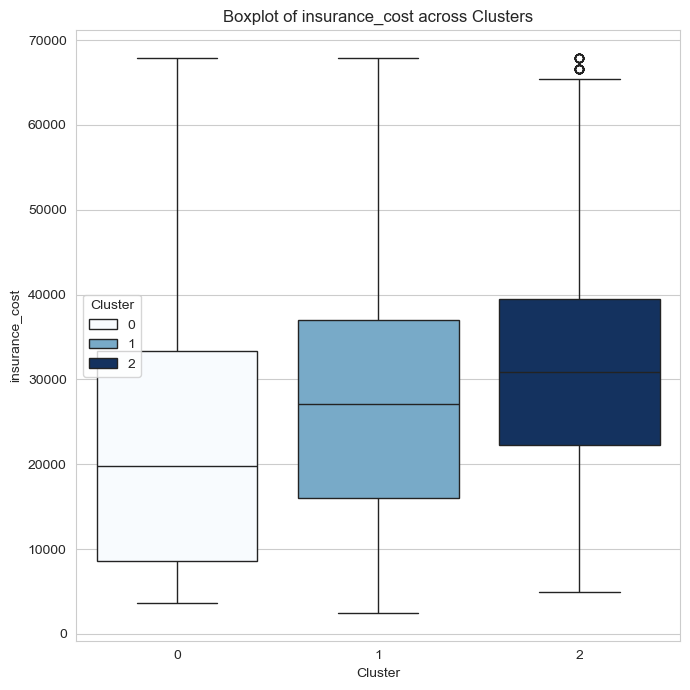

In [183]:
for i in inscost_cluster_eda[num]:
    plt.figure(figsize=(7,7)) 
    sns.boxplot(data=inscost_cluster_eda, x='Cluster', y=i, hue='Cluster', palette='Blues')
    plt.title(f'Boxplot of {i} across Clusters')
    plt.xlabel('Cluster')
    plt.ylabel(i)
    plt.tight_layout()

# Show the plots
plt.show()

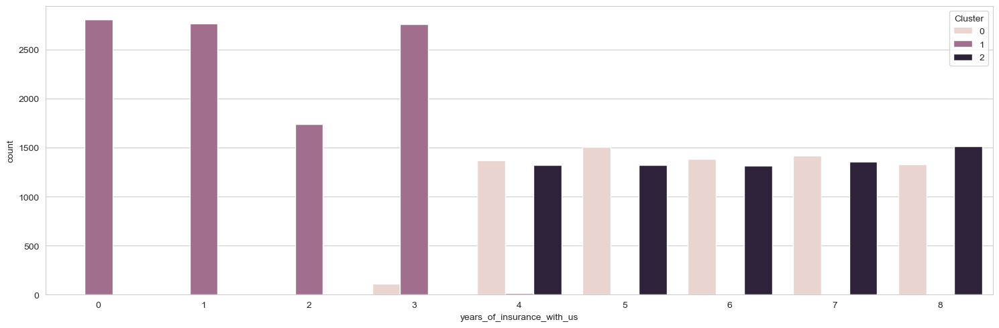

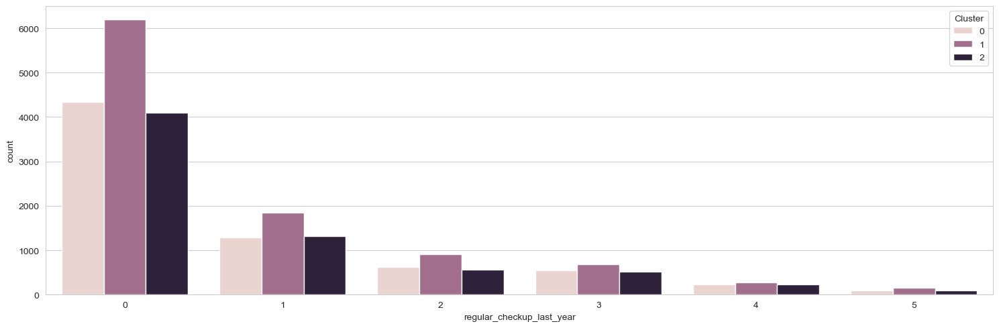

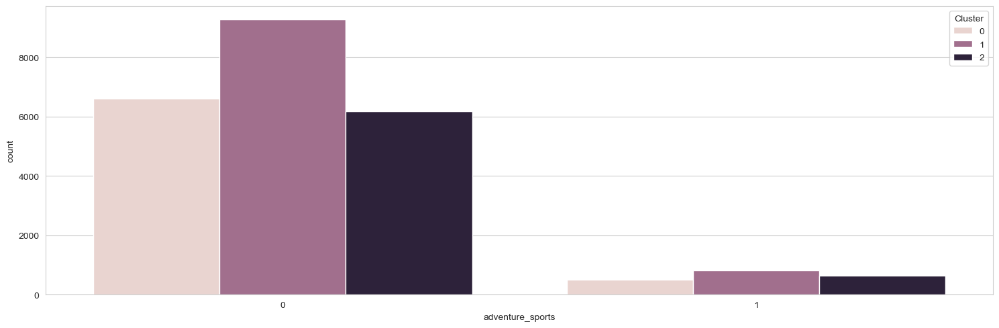

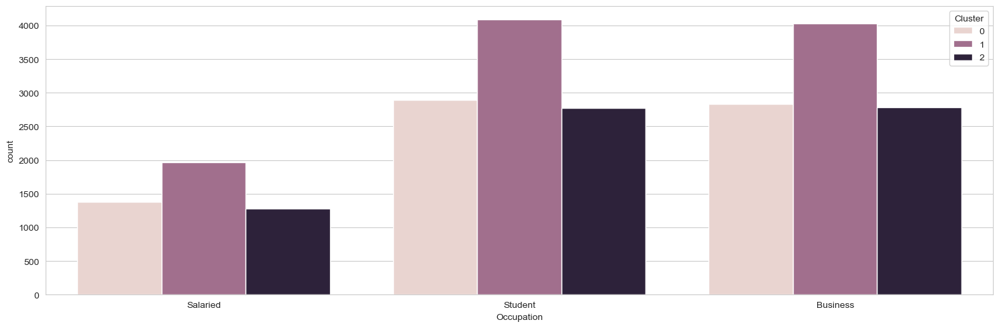

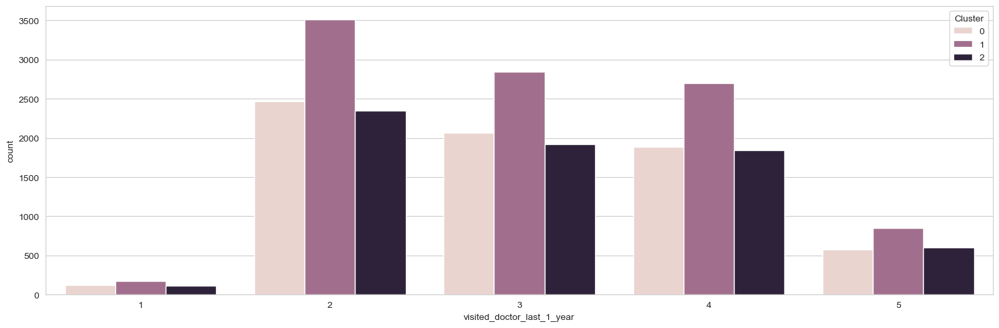

...

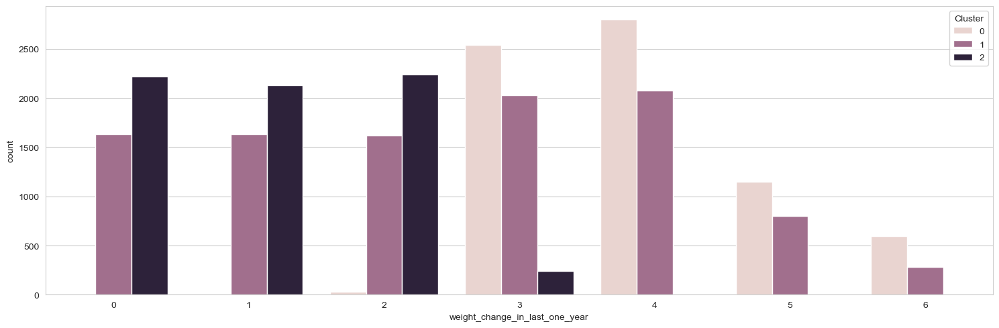

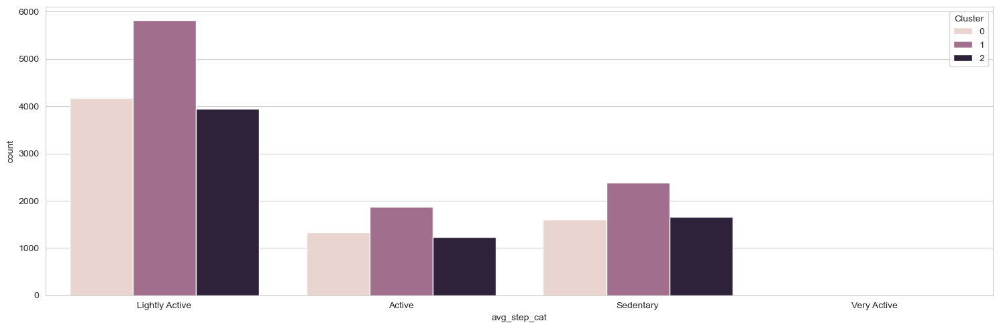

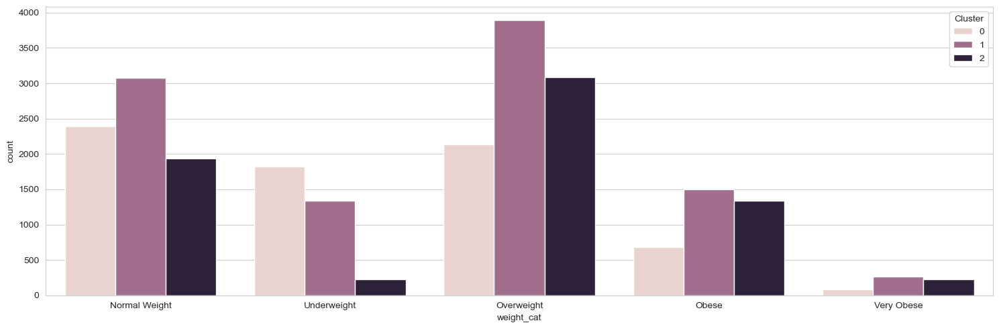

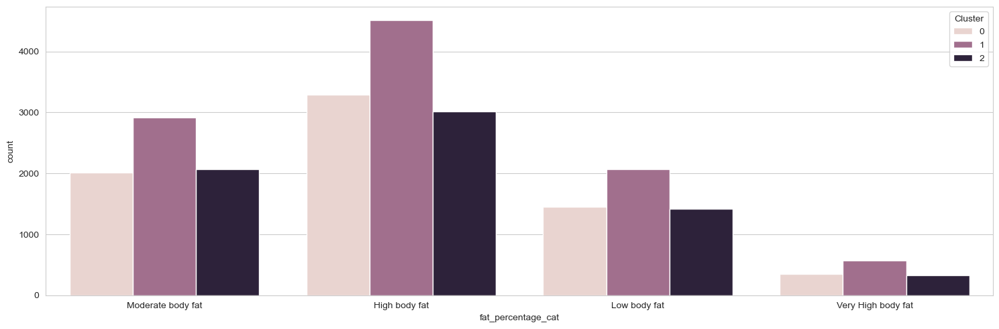

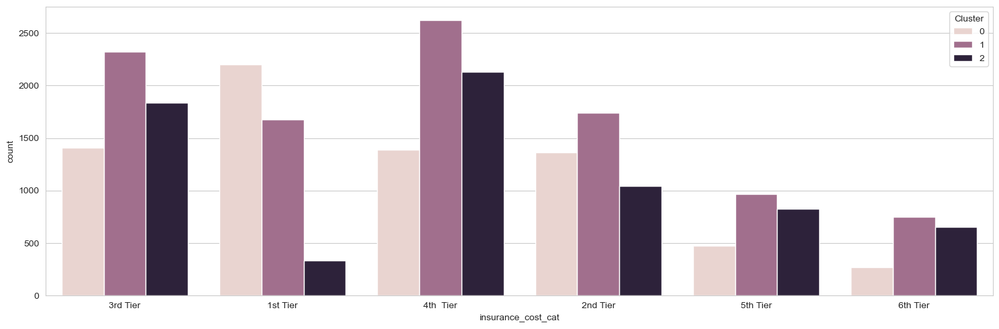

In [184]:
for i in inscost_cluster_eda[cat]:
    plt.figure(figsize=(15,5))
    sns.countplot(x=inscost_cluster_eda[i],hue=inscost_cluster_eda['Cluster'])
    plt.tight_layout();

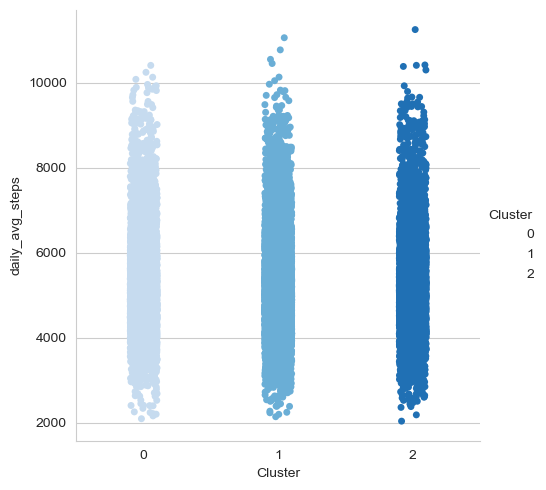

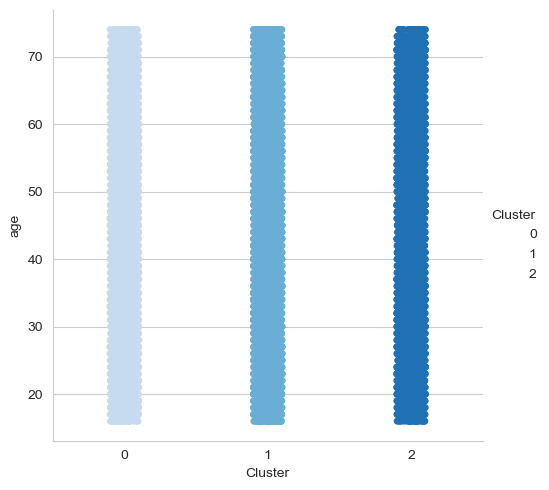

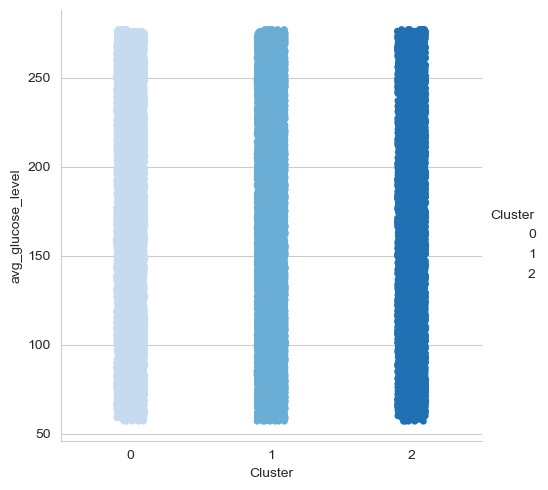

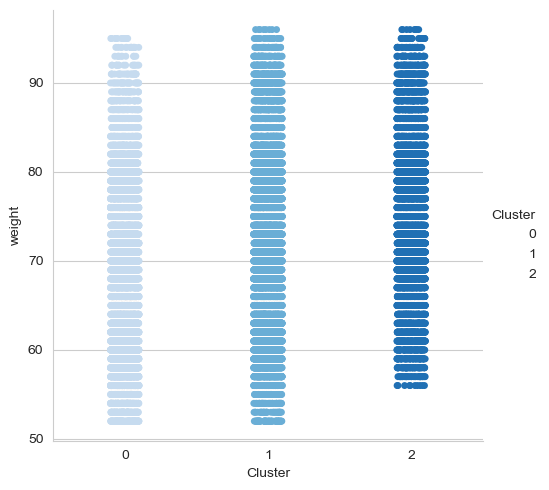

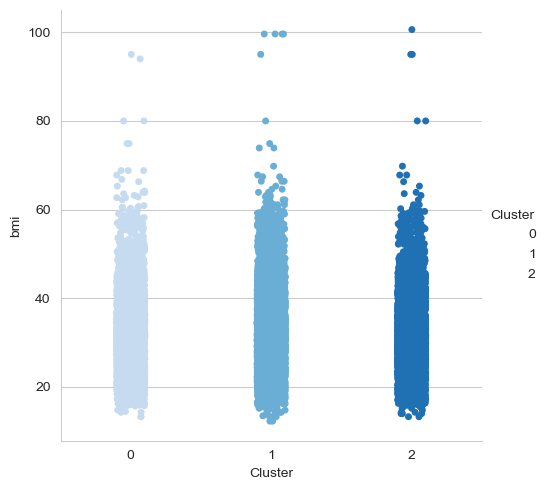

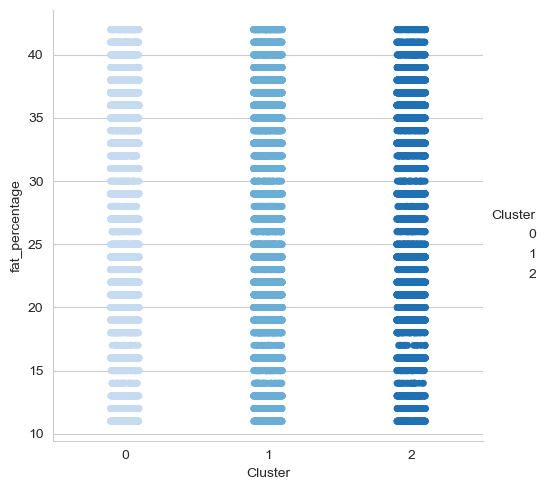

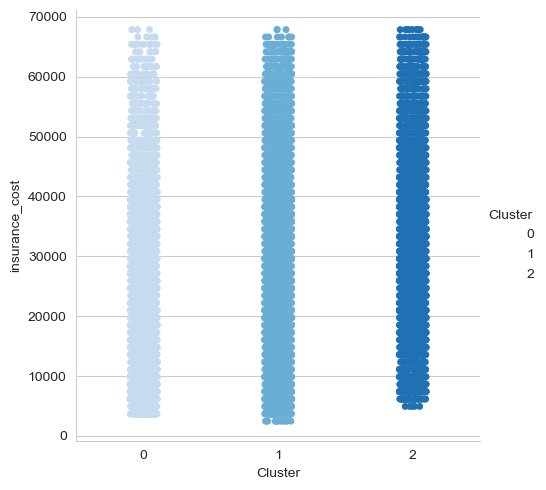

In [185]:
for i in inscost_cluster_eda[num]:
    sns.catplot(data=inscost_cluster_eda,x='Cluster',y=i,palette='Blues')
    plt.show();

<AxesSubplot:xlabel='weight', ylabel='insurance_cost'>

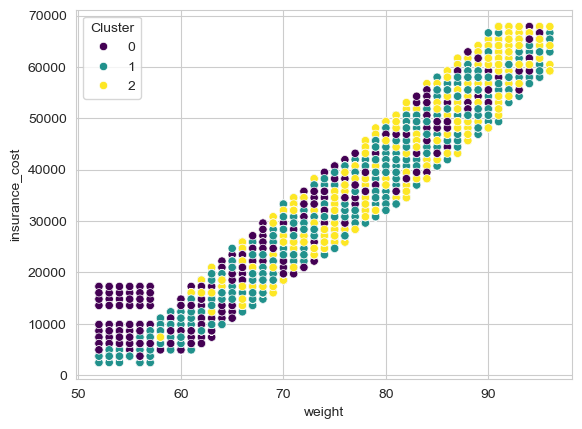

In [186]:
sns.scatterplot(data=inscost_cluster_eda,x='weight',y='insurance_cost',hue='Cluster',palette='viridis')

<AxesSubplot:xlabel='weight', ylabel='insurance_cost'>

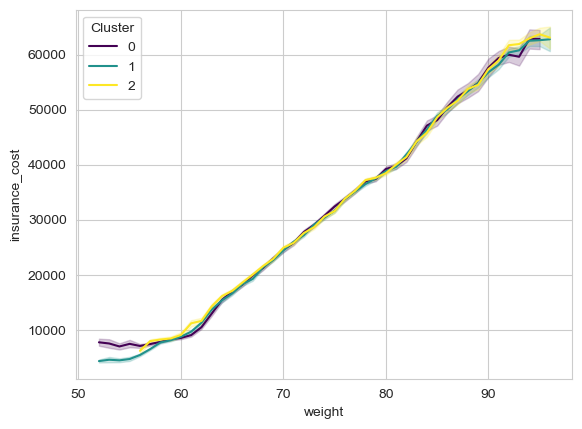

In [187]:
sns.lineplot(data=inscost_cluster_eda,x='weight',y='insurance_cost',hue='Cluster',palette='viridis')

## Train-Test Split

In [188]:
inscost_modeldf=pd.DataFrame(inscost_isoen[selected_features])

In [189]:
from sklearn.model_selection import train_test_split

In [190]:
X= inscost_modeldf
y= inscost_isoen['insurance_cost']

In [191]:
X_train, X_test, y_train, y_test= train_test_split(X,y,test_size=0.3,random_state=100)

In [192]:
X_train.shape

(16807, 15)

In [193]:
y_train.shape

(16807,)

In [194]:
X_test.shape

(7203, 15)

In [195]:
y_test.shape

(7203,)

In [196]:
results_df=pd.DataFrame({'RMSE':[],'MAE': [], 'MAPE' :[], 'R^2':[]})

## Parametric Models

### SKLEARN Linear Regression

In [197]:
from sklearn.linear_model import LinearRegression

In [198]:
from sklearn.metrics import mean_absolute_error as mae, mean_squared_error as mse, mean_absolute_percentage_error as mape

In [199]:
lr_model=LinearRegression().fit(X_train,y_train)

In [200]:
lr_model_pred_train=lr_model.predict(X_train)
lr_model_pred_test= lr_model.predict(X_test)

In [201]:
print('\nTrain Data Performance\n')
print('RMSE=',np.sqrt(mse(y_train,lr_model_pred_train)))
print('MAE=',mae(y_train,lr_model_pred_train))
print('MAPE=',mape(y_train,lr_model_pred_train))
print('R sq= ', lr_model.score(X_train,y_train))


Train Data Performance

RMSE= 3371.4610742796126
MAE= 2722.170427336154
MAPE= 0.15347054802123591
R sq=  0.9447736970122004


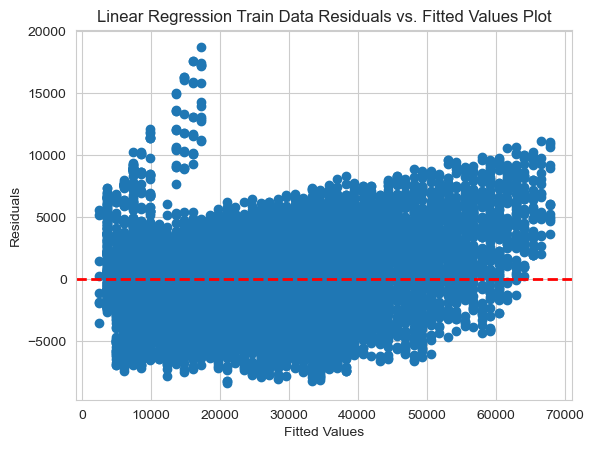

In [202]:
## Residual plot-train Data
residuals = y_train - lr_model_pred_train

plt.scatter(y_train, residuals)
plt.axhline(y=0, color='r', linestyle='--', linewidth=2)
plt.xlabel('Fitted Values')
plt.ylabel('Residuals')
plt.title('Linear Regression Train Data Residuals vs. Fitted Values Plot')
plt.show()

In [203]:
print('\nTest Data Performance\n')
print('RMSE=',np.sqrt(mse(y_test,lr_model_pred_test)))
print('MAE=',mae(y_test,lr_model_pred_test))
print('MAPE=',mape(y_test,lr_model_pred_test))


Test Data Performance

RMSE= 3353.279933373637
MAE= 2705.0525348592523
MAPE= 0.14968998842244605


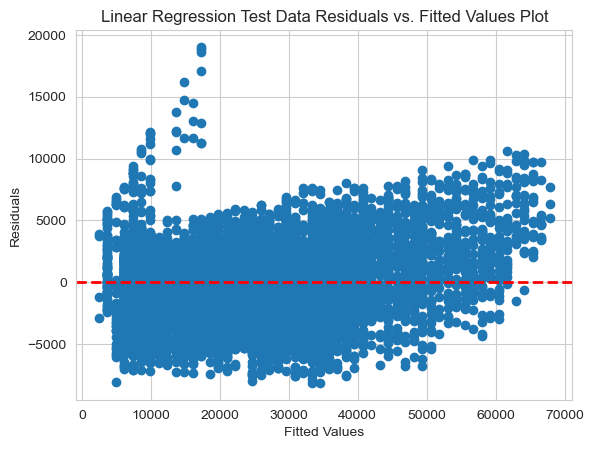

In [204]:
## Residual plot-Test Data
residuals = y_test - lr_model_pred_test

plt.scatter(y_test, residuals)
plt.axhline(y=0, color='r', linestyle='--', linewidth=2)
plt.xlabel('Fitted Values')
plt.ylabel('Residuals')
plt.title('Linear Regression Test Data Residuals vs. Fitted Values Plot')
plt.show()

In [205]:
lr_model_RMSE_test=round(np.sqrt(mse(y_test,lr_model_pred_test)),2)
lr_model_MAE_test=round(mae(y_test,lr_model_pred_test),2)
lr_model_MAPE_test=round(mape(y_test,lr_model_pred_test),2)
lr_model_rsq_test=round(lr_model.score(X_test,y_test),2)

In [206]:
results_df_lr_model=pd.DataFrame({'RMSE':lr_model_RMSE_test, 'MAE': lr_model_MAE_test, 'MAPE': lr_model_MAPE_test, 'R^2': lr_model_rsq_test},index=['LinearRegression'])

In [207]:
results_df_lr_model

,RMSE,MAE,MAPE,R^2
LinearRegression,3353.28,2705.05,0.15,0.94


In [208]:
results_df=pd.concat([results_df,results_df_lr_model],ignore_index=False)

In [209]:
results_df

,RMSE,MAE,MAPE,R^2
LinearRegression,3353.28,2705.05,0.15,0.94


In [210]:
lr_model.intercept_

26833.32255174719

In [211]:
lr_model.coef_.round(2)

array([-1.014000e+01, -4.530100e+02,  3.846000e+01, -5.710000e+01,
       -5.560000e+00,  5.138000e+01,  4.690000e+00, -2.627000e+01,
        1.388431e+04,  1.662100e+02, -4.679000e+01, -4.450000e+00,
        4.753000e+01,  2.071000e+01,  1.173110e+03])

In [212]:
X_train.columns

Index(['years_of_insurance_with_us', 'regular_checkup_last_year',
       'cholesterol_level', 'visited_doctor_last_1_year', 'daily_avg_steps',
       'age', 'avg_glucose_level', 'bmi', 'weight',
       'weight_change_in_last_one_year', 'fat_percentage',
       'smoking_status_never smoked', 'Alcohol_Rare', 'exercise_Moderate',
       'covered_by_any_other_company_Y'],
      dtype='object')

insurance_cost= 27061.41 + (-10.45 * 'years_of_insurance_with_us')+(-452.52 * 'regular_checkup_last_year') +    
(-59.64' * 'visited_doctor_last_1_year')+ (-2.33* 'daily_avg_steps') + (51.05 * 'age') +
(4.48 * 'avg_glucose_level') + (-2.97 * 'bmi') + (13884.36 * 'weight') + (16.22 * 'weight_change_in_last_one_year') +
(-42.69 * 'fat_percentage') + (-4.49 * 'smoking_status_never smoked') +
(1173.51 * 'covered_by_any_other_company_Y')

### Ridge Regression

In [213]:
from sklearn.linear_model import Ridge

In [214]:
ridge_model= Ridge (alpha=0.5)
ridge_model.fit(X_train,y_train)

Ridge(alpha=0.5)

In [215]:
ridge_model.coef_

array([-1.01299340e+01, -4.53059426e+02,  3.84570484e+01, -5.70988102e+01,
       -5.55642074e+00,  5.13787840e+01,  4.69099814e+00, -2.62695317e+01,
        1.38838221e+04,  1.66101920e+02, -4.67859568e+01, -4.44089284e+00,
        4.75253163e+01,  2.07152036e+01,  1.17299305e+03])

In [216]:
ridge_model_pred_train=ridge_model.predict(X_train)
ridge_model_pred_test=ridge_model.predict(X_test)

In [217]:
print('\nTrain Data Performance\n')
print('RMSE=',np.sqrt(mse(y_train,ridge_model_pred_train)))
print('MAE=',mae(y_train,ridge_model_pred_train))
print('MAPE=',mape(y_train,ridge_model_pred_train))
print('R sq= ', ridge_model.score(X_train,y_train))


Train Data Performance

RMSE= 3371.4611046892815
MAE= 2722.1592596647024
MAPE= 0.15346860270122933
R sq=  0.9447736960159476


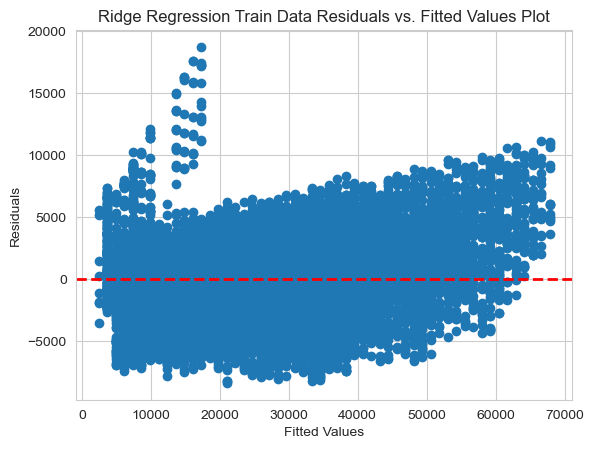

In [218]:
## Residual plot-train Data
residuals = y_train - ridge_model_pred_train

plt.scatter(y_train, residuals)
plt.axhline(y=0, color='r', linestyle='--', linewidth=2)
plt.xlabel('Fitted Values')
plt.ylabel('Residuals')
plt.title('Ridge Regression Train Data Residuals vs. Fitted Values Plot')
plt.show()

In [219]:
print('\nTest Data Performance\n')
print('RMSE=',np.sqrt(mse(y_test,ridge_model_pred_test)))
print('MAE=',mae(y_test,ridge_model_pred_test))
print('MAPE=',mape(y_test,ridge_model_pred_test))


Test Data Performance

RMSE= 3353.2857695196526
MAE= 2705.0433998874328
MAPE= 0.14968798731109392


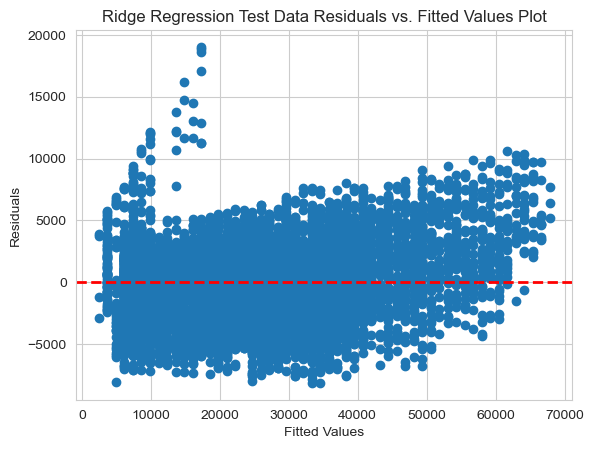

In [220]:
## Residual plot-Test Data
residuals = y_test - ridge_model_pred_test

plt.scatter(y_test, residuals)
plt.axhline(y=0, color='r', linestyle='--', linewidth=2)
plt.xlabel('Fitted Values')
plt.ylabel('Residuals')
plt.title('Ridge Regression Test Data Residuals vs. Fitted Values Plot')
plt.show()

In [221]:
ridge_model_RMSE_test=round(np.sqrt(mse(y_test,ridge_model_pred_test)),2)
ridge_model_MAE_test=round(mae(y_test,ridge_model_pred_test),2)
ridge_model_MAPE_test=round(mape(y_test,ridge_model_pred_test),2)
ridge_model_rsq_test=round(ridge_model.score(X_test,y_test),2)

In [222]:
results_df_ridge_model=pd.DataFrame({'RMSE':ridge_model_RMSE_test, 'MAE': ridge_model_MAE_test, 'MAPE': ridge_model_MAPE_test, 'R^2': ridge_model_rsq_test},index=['RidgeRegression'])
results_df_ridge_model

,RMSE,MAE,MAPE,R^2
RidgeRegression,3353.29,2705.04,0.15,0.94


In [223]:
results_df=pd.concat([results_df,results_df_ridge_model],ignore_index=False)
results_df

,RMSE,MAE,MAPE,R^2
LinearRegression,3353.28,2705.05,0.15,0.94
RidgeRegression,3353.29,2705.04,0.15,0.94


#### Tuning

In [224]:
from sklearn.model_selection import GridSearchCV

In [225]:
alpha=np.linspace(-5,5,50)

In [226]:
ridge_params = {'alpha': alpha}
ridge_grid_search = GridSearchCV(Ridge(), param_grid=ridge_params, cv=5, scoring='neg_mean_squared_error')
ridge_grid_search.fit(X_train, y_train)

GridSearchCV(cv=5, estimator=Ridge(),
             param_grid={'alpha': array([-5.        , -4.79591837, -4.59183673, -4.3877551 , -4.18367347,
       -3.97959184, -3.7755102 , -3.57142857, -3.36734694, -3.16326531,
       -2.95918367, -2.75510204, -2.55102041, -2.34693878, -2.14285714,
       -1.93877551, -1.73469388, -1.53061224, -1.32653061, -1.12244898,
       -0.91836735, -0.71428571, -0.51020408, -0.30612245, -0.10204082,
        0.10204082,  0.30612245,  0.51020408,  0.71428571,  0.91836735,
        1.12244898,  1.32653061,  1.53061224,  1.73469388,  1.93877551,
        2.14285714,  2.34693878,  2.55102041,  2.75510204,  2.95918367,
        3.16326531,  3.36734694,  3.57142857,  3.7755102 ,  3.97959184,
        4.18367347,  4.3877551 ,  4.59183673,  4.79591837,  5.        ])},
             scoring='neg_mean_squared_error')

In [227]:
best_ridge_alpha=ridge_grid_search.best_params_
best_ridge_alpha

{'alpha': 3.163265306122449}

In [228]:
best_ridge_model=Ridge(alpha=3.16)
best_ridge_model.fit(X_train,y_train)

Ridge(alpha=3.16)

In [229]:
best_ridge_model_pred_train=best_ridge_model.predict(X_train)
best_ridge_model_pred_test=best_ridge_model.predict(X_test)

In [230]:
print('\nTrain Data Performance\n')
print('RMSE=',np.sqrt(mse(y_train,best_ridge_model_pred_train)))
print('MAE=',mae(y_train,best_ridge_model_pred_train))
print('MAPE=',mape(y_train,best_ridge_model_pred_train))
print('R sq= ', best_ridge_model.score(X_train,y_train))


Train Data Performance

RMSE= 3371.4622884152473
MAE= 2722.0999939980506
MAPE= 0.1534582594574712
R sq=  0.9447736572358345


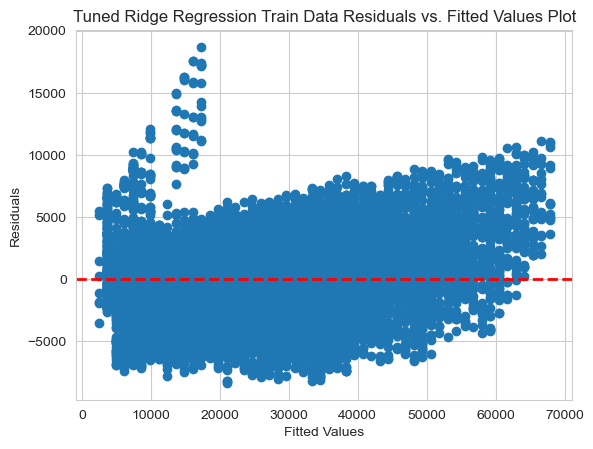

In [231]:
## Residual plot-train Data
residuals = y_train - best_ridge_model_pred_train

plt.scatter(y_train, residuals)
plt.axhline(y=0, color='r', linestyle='--', linewidth=2)
plt.xlabel('Fitted Values')
plt.ylabel('Residuals')
plt.title('Tuned Ridge Regression Train Data Residuals vs. Fitted Values Plot')
plt.show()

In [232]:
print('\nTest Data Performance\n')
print('RMSE=',np.sqrt(mse(y_test,best_ridge_model_pred_test)))
print('MAE=',mae(y_test,best_ridge_model_pred_test))
print('MAPE=',mape(y_test,best_ridge_model_pred_test))


Test Data Performance

RMSE= 3353.317830959868
MAE= 2704.9951828357002
MAPE= 0.1496773626805524


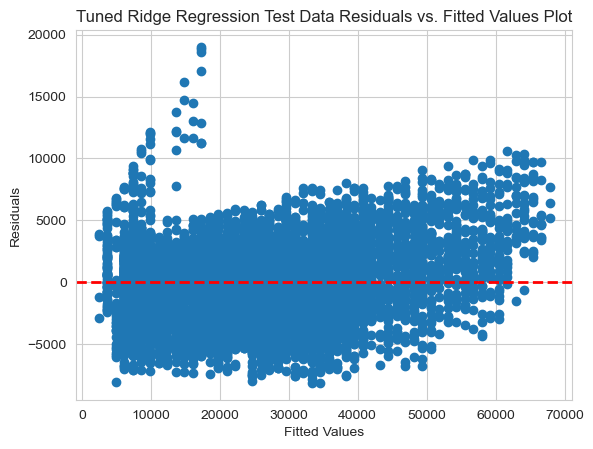

In [233]:
## Residual plot-Test Data
residuals = y_test - best_ridge_model_pred_test

plt.scatter(y_test, residuals)
plt.axhline(y=0, color='r', linestyle='--', linewidth=2)
plt.xlabel('Fitted Values')
plt.ylabel('Residuals')
plt.title('Tuned Ridge Regression Test Data Residuals vs. Fitted Values Plot')
plt.show()

In [234]:
best_ridge_model_RMSE_test=round(np.sqrt(mse(y_test,best_ridge_model_pred_test)),2)
best_ridge_model_MAE_test=round(mae(y_test,best_ridge_model_pred_test),2)
best_ridge_model_MAPE_test=round(mape(y_test,best_ridge_model_pred_test),2)
best_ridge_model_rsq_test=round(best_ridge_model.score(X_test,y_test),2)

In [235]:
results_df_best_ridge_model=pd.DataFrame({'RMSE':best_ridge_model_RMSE_test, 'MAE': best_ridge_model_MAE_test, 'MAPE': best_ridge_model_MAPE_test, 'R^2': best_ridge_model_rsq_test},index=['TunedRidgeRegression'])
results_df_best_ridge_model

,RMSE,MAE,MAPE,R^2
TunedRidgeRegression,3353.32,2705.0,0.15,0.94


In [236]:
results_df=pd.concat([results_df,results_df_best_ridge_model],ignore_index=False)
results_df

,RMSE,MAE,MAPE,R^2
LinearRegression,3353.28,2705.05,0.15,0.94
RidgeRegression,3353.29,2705.04,0.15,0.94
TunedRidgeRegression,3353.32,2705.00,0.15,0.94


### Lasso Regression

In [237]:
from sklearn.linear_model import Lasso

In [238]:
lasso_model=Lasso(alpha=1.0)
lasso_model.fit(X_train,y_train)

Lasso()

In [239]:
lasso_model_pred_train=lasso_model.predict(X_train)
lasso_model_pred_test=lasso_model.predict(X_test)

In [240]:
print('\nTrain Data Performance\n')
print('RMSE=',np.sqrt(mse(y_train,lasso_model_pred_train)))
print('MAE=',mae(y_train,lasso_model_pred_train))
print('MAPE=',mape(y_train,lasso_model_pred_train))
print('R sq= ', lasso_model.score(X_train,y_train))


Train Data Performance

RMSE= 3371.4652882938117
MAE= 2722.144582519645
MAPE= 0.15346125031015548
R sq=  0.9447735589565828


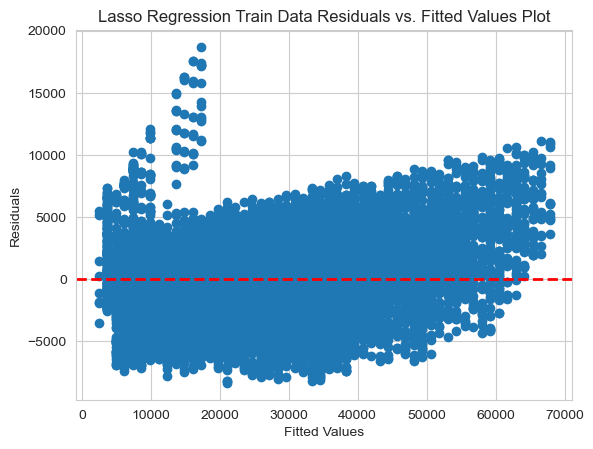

In [241]:
## Residual plot-train Data
residuals = y_train - lasso_model_pred_train

plt.scatter(y_train, residuals)
plt.axhline(y=0, color='r', linestyle='--', linewidth=2)
plt.xlabel('Fitted Values')
plt.ylabel('Residuals')
plt.title('Lasso Regression Train Data Residuals vs. Fitted Values Plot')
plt.show()

In [242]:
print('\nTest Data Performance\n')
print('RMSE=',np.sqrt(mse(y_test,lasso_model_pred_test)))
print('MAE=',mae(y_test,lasso_model_pred_test))
print('MAPE=',mape(y_test,lasso_model_pred_test))


Test Data Performance

RMSE= 3353.2413576136673
MAE= 2705.0470845273826
MAPE= 0.14967900007827775


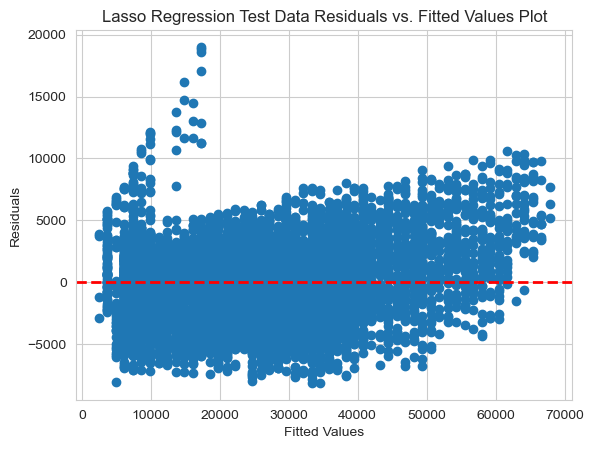

In [243]:
## Residual plot-Test Data
residuals = y_test - lasso_model_pred_test

plt.scatter(y_test, residuals)
plt.axhline(y=0, color='r', linestyle='--', linewidth=2)
plt.xlabel('Fitted Values')
plt.ylabel('Residuals')
plt.title('Lasso Regression Test Data Residuals vs. Fitted Values Plot')
plt.show()

In [244]:
lasso_model_RMSE_test=round(np.sqrt(mse(y_test,lasso_model_pred_test)),2)
lasso_model_MAE_test=round(mae(y_test,lasso_model_pred_test),2)
lasso_model_MAPE_test=round(mape(y_test,lasso_model_pred_test),2)
lasso_model_rsq_test=round(lasso_model.score(X_test,y_test),2)

In [245]:
results_df_lasso_model=pd.DataFrame({'RMSE':lr_model_RMSE_test, 'MAE': lr_model_MAE_test, 'MAPE': lr_model_MAPE_test, 'R^2': lr_model_rsq_test},index=['LassoRegression'])
results_df_lasso_model

,RMSE,MAE,MAPE,R^2
LassoRegression,3353.28,2705.05,0.15,0.94


In [246]:
results_df=pd.concat([results_df,results_df_lasso_model],ignore_index=False)
results_df

,RMSE,MAE,MAPE,R^2
LinearRegression,3353.28,2705.05,0.15,0.94
RidgeRegression,3353.29,2705.04,0.15,0.94
TunedRidgeRegression,3353.32,2705.00,0.15,0.94
LassoRegression,3353.28,2705.05,0.15,0.94


#### Tuned Lasso

In [247]:
alpha=np.linspace(-5,500,100)
lasso_params = {'alpha': alpha}
lasso_grid_search = GridSearchCV(Lasso(), param_grid=lasso_params, cv=5, scoring='neg_mean_squared_error')
lasso_grid_search.fit(X_train, y_train)

GridSearchCV(cv=5, estimator=Lasso(),
             param_grid={'alpha': array([-5.00000000e+00,  1.01010101e-01,  5.20202020e+00,  1.03030303e+01,
        1.54040404e+01,  2.05050505e+01,  2.56060606e+01,  3.07070707e+01,
        3.58080808e+01,  4.09090909e+01,  4.60101010e+01,  5.11111111e+01,
        5.62121212e+01,  6.13131313e+01,  6.64141414e+01,  7.15151515e+01,
        7.66161616e+01,  8.17171717e+01,  8.68181818e+01,  9...
        3.82676768e+02,  3.87777778e+02,  3.92878788e+02,  3.97979798e+02,
        4.03080808e+02,  4.08181818e+02,  4.13282828e+02,  4.18383838e+02,
        4.23484848e+02,  4.28585859e+02,  4.33686869e+02,  4.38787879e+02,
        4.43888889e+02,  4.48989899e+02,  4.54090909e+02,  4.59191919e+02,
        4.64292929e+02,  4.69393939e+02,  4.74494949e+02,  4.79595960e+02,
        4.84696970e+02,  4.89797980e+02,  4.94898990e+02,  5.00000000e+02])},
             scoring='neg_mean_squared_error')

In [248]:
best_lasso_alpha=lasso_grid_search.best_params_
best_lasso_alpha

{'alpha': 15.404040404040405}

In [249]:
best_lasso_model=Lasso(alpha=15.40)
best_lasso_model.fit(X_train,y_train)

Lasso(alpha=15.4)

In [250]:
best_lasso_model_pred_train=best_lasso_model.predict(X_train)
best_lasso_model_pred_test=best_lasso_model.predict(X_test)

In [251]:
print('\nTrain Data Performance\n')
print('RMSE=',np.sqrt(mse(y_train,best_lasso_model_pred_train)))
print('MAE=',mae(y_train,best_lasso_model_pred_train))
print('MAPE=',mape(y_train,best_lasso_model_pred_train))
print('R sq= ', best_lasso_model.score(X_train,y_train))


Train Data Performance

RMSE= 3372.017441799069
MAE= 2722.230669102428
MAPE= 0.15335720011287876
R sq=  0.9447554683239383


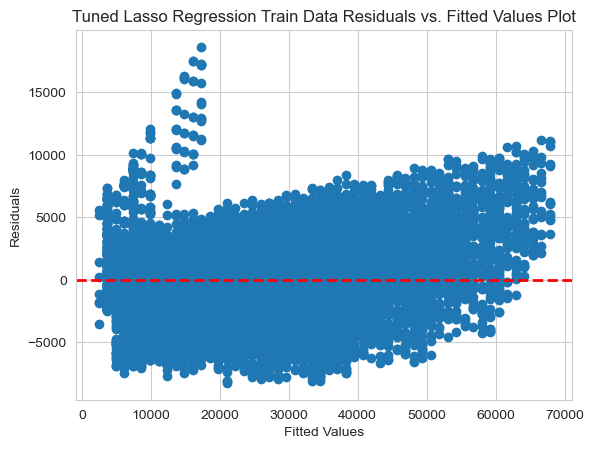

In [252]:
## Residual plot-train Data
residuals = y_train - best_lasso_model_pred_train

plt.scatter(y_train, residuals)
plt.axhline(y=0, color='r', linestyle='--', linewidth=2)
plt.xlabel('Fitted Values')
plt.ylabel('Residuals')
plt.title('Tuned Lasso Regression Train Data Residuals vs. Fitted Values Plot')
plt.show()

In [253]:
print('\nTest Data Performance\n')
print('RMSE=',np.sqrt(mse(y_test,best_lasso_model_pred_test)))
print('MAE=',mae(y_test,best_lasso_model_pred_test))
print('MAPE=',mape(y_test,best_lasso_model_pred_test))


Test Data Performance

RMSE= 3353.406087856092
MAE= 2705.2717605118714
MAPE= 0.14955693680794735


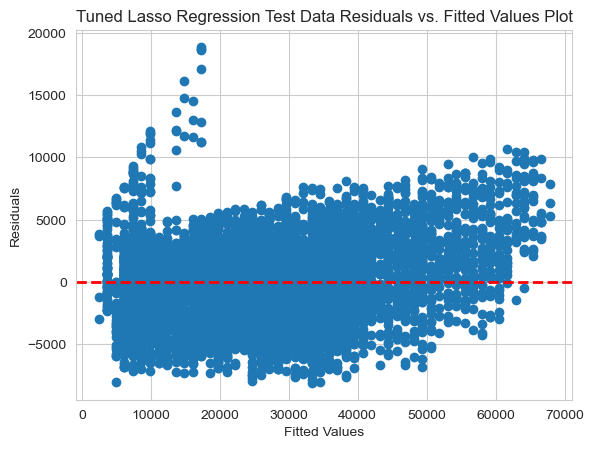

In [254]:
## Residual plot-Test Data
residuals = y_test - best_lasso_model_pred_test

plt.scatter(y_test, residuals)
plt.axhline(y=0, color='r', linestyle='--', linewidth=2)
plt.xlabel('Fitted Values')
plt.ylabel('Residuals')
plt.title('Tuned Lasso Regression Test Data Residuals vs. Fitted Values Plot')
plt.show()

In [255]:
best_lasso_model_RMSE_test=round(np.sqrt(mse(y_test,best_lasso_model_pred_test)),2)
best_lasso_model_MAE_test=round(mae(y_test,best_lasso_model_pred_test),2)
best_lasso_model_MAPE_test=round(mape(y_test,best_lasso_model_pred_test),2)
best_lasso_model_rsq_test=round(best_lasso_model.score(X_test,y_test),2)

In [256]:
results_df_best_lasso_model=pd.DataFrame({'RMSE':best_lasso_model_RMSE_test, 'MAE': best_lasso_model_MAE_test, 'MAPE': best_lasso_model_MAPE_test, 'R^2': best_lasso_model_rsq_test},index=['TunedLassoRegression'])
results_df_best_lasso_model

,RMSE,MAE,MAPE,R^2
TunedLassoRegression,3353.41,2705.27,0.15,0.94


In [257]:
results_df=pd.concat([results_df,results_df_best_lasso_model],ignore_index=False)
results_df

,RMSE,MAE,MAPE,R^2
LinearRegression,3353.28,2705.05,0.15,0.94
RidgeRegression,3353.29,2705.04,0.15,0.94
TunedRidgeRegression,3353.32,2705.00,0.15,0.94
LassoRegression,3353.28,2705.05,0.15,0.94
TunedLassoRegression,3353.41,2705.27,0.15,0.94


### LDA

In [258]:
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis

In [259]:
lda_model= LinearDiscriminantAnalysis()
lda_model.fit(X_train,y_train)

LinearDiscriminantAnalysis()

In [260]:
lda_model_pred_train=lda_model.predict(X_train)
lda_model_pred_test=lda_model.predict(X_test)

In [265]:
print('\nTrain Data Performance\n')
print('RMSE=',np.sqrt(mse(y_train,lda_model_pred_train)))
print('MAE=',mae(y_train,lda_model_pred_train))
print('MAPE=',mape(y_train,lda_model_pred_train))
print('R sq= ', lda_model.score(X_train,y_train))


Train Data Performance

RMSE= 3315.9899934916857
MAE= 2532.244064972928
MAPE= 0.1214197549041923
R sq=  0.19479978580353424


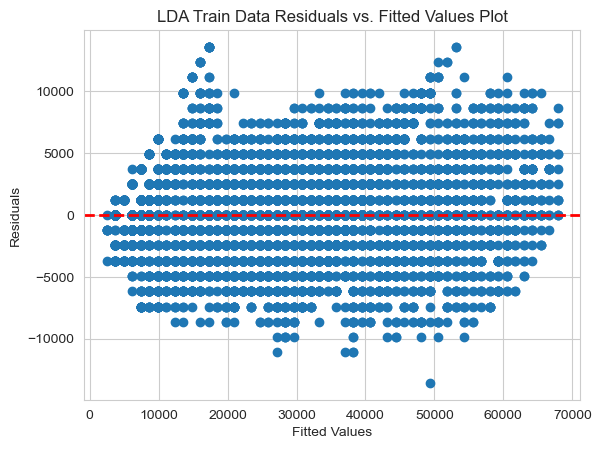

In [262]:
## Residual plot-train Data
residuals = y_train - lda_model_pred_train

plt.scatter(y_train, residuals)
plt.axhline(y=0, color='r', linestyle='--', linewidth=2)
plt.xlabel('Fitted Values')
plt.ylabel('Residuals')
plt.title('LDA Train Data Residuals vs. Fitted Values Plot')
plt.show()

In [266]:
print('\nTest Data Performance\n')
print('RMSE=',np.sqrt(mse(y_test,lda_model_pred_test)))
print('MAE=',mae(y_test,lda_model_pred_test))
print('MAPE=',mape(y_test,lda_model_pred_test))



Test Data Performance

RMSE= 3331.48685495276
MAE= 2572.8463140358185
MAPE= 0.12347805163488682


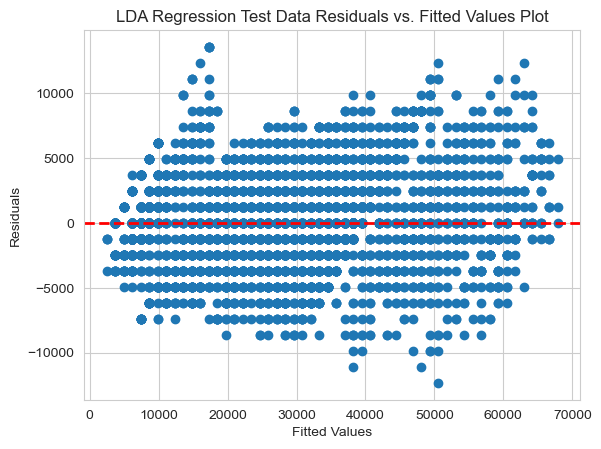

In [267]:
## Residual plot-Test Data
residuals = y_test - lda_model_pred_test

plt.scatter(y_test, residuals)
plt.axhline(y=0, color='r', linestyle='--', linewidth=2)
plt.xlabel('Fitted Values')
plt.ylabel('Residuals')
plt.title('LDA Regression Test Data Residuals vs. Fitted Values Plot')
plt.show()

In [268]:
lda_model_RMSE_test=round(np.sqrt(mse(y_test,lda_model_pred_test)),2)
lda_model_MAE_test=round(mae(y_test,lda_model_pred_test),2)
lda_model_MAPE_test=round(mape(y_test,lda_model_pred_test),2)
lda_model_rsq_test=round(lda_model.score(X_test,y_test),2)

In [269]:
results_df_lda_model=pd.DataFrame({'RMSE':lda_model_RMSE_test, 'MAE': lda_model_MAE_test, 'MAPE': lda_model_MAPE_test, 'R^2': lda_model_rsq_test},index=['LDA'])
results_df_lda_model

,RMSE,MAE,MAPE,R^2
LDA,3331.49,2572.85,0.12,0.17


In [270]:
results_df=pd.concat([results_df,results_df_lda_model],ignore_index=False)
results_df

,RMSE,MAE,MAPE,R^2
LinearRegression,3353.28,2705.05,0.15,0.94
RidgeRegression,3353.29,2705.04,0.15,0.94
TunedRidgeRegression,3353.32,2705.00,0.15,0.94
LassoRegression,3353.28,2705.05,0.15,0.94
TunedLassoRegression,3353.41,2705.27,0.15,0.94
LDA,3331.49,2572.85,0.12,0.17


### Elastic Net Regression

In [271]:
from sklearn.linear_model import ElasticNet

In [272]:
en_model=ElasticNet(alpha=1,l1_ratio=0.5)
en_model.fit(X_train,y_train)

ElasticNet(alpha=1)

In [273]:
en_model_pred_train=en_model.predict(X_train)
en_model_pred_test=en_model.predict(X_test)

In [274]:
print('\nTrain Data Performance\n')
print('RMSE=',np.sqrt(mse(y_train,en_model_pred_train)))
print('MAE=',mae(y_train,en_model_pred_train))
print('MAPE=',mape(y_train,en_model_pred_train))
print('R sq= ', en_model.score(X_train,y_train))


Train Data Performance

RMSE= 5772.588121801394
MAE= 4621.965050110715
MAPE= 0.2769614748913114
R sq=  0.8380985216603958


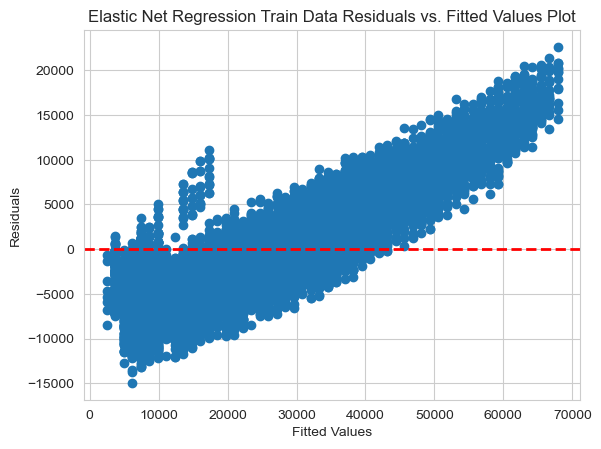

In [275]:
## Residual plot-train Data
residuals = y_train - en_model_pred_train

plt.scatter(y_train, residuals)
plt.axhline(y=0, color='r', linestyle='--', linewidth=2)
plt.xlabel('Fitted Values')
plt.ylabel('Residuals')
plt.title('Elastic Net Regression Train Data Residuals vs. Fitted Values Plot')
plt.show()

In [276]:
print('\nTest Data Performance\n')
print('RMSE=',np.sqrt(mse(y_test,en_model_pred_test)))
print('MAE=',mae(y_test,en_model_pred_test))
print('MAPE=',mape(y_test,en_model_pred_test))


Test Data Performance

RMSE= 5786.388632391683
MAE= 4631.275478533796
MAPE= 0.2742794162159609


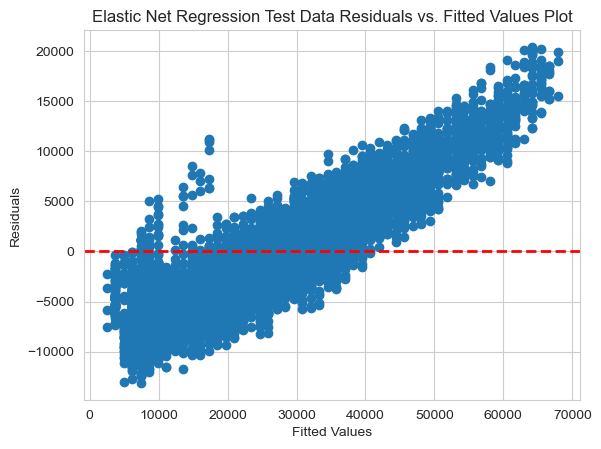

In [277]:
## Residual plot-Test Data
residuals = y_test - en_model_pred_test

plt.scatter(y_test, residuals)
plt.axhline(y=0, color='r', linestyle='--', linewidth=2)
plt.xlabel('Fitted Values')
plt.ylabel('Residuals')
plt.title('Elastic Net Regression Test Data Residuals vs. Fitted Values Plot')
plt.show()

In [278]:
en_model_RMSE_test=round(np.sqrt(mse(y_test,en_model_pred_test)),2)
en_model_MAE_test=round(mae(y_test,en_model_pred_test),2)
en_model_MAPE_test=round(mape(y_test,en_model_pred_test),2)
en_model_rsq_test=round(en_model.score(X_test,y_test),2)

In [279]:
results_df_en_model=pd.DataFrame({'RMSE':en_model_RMSE_test, 'MAE': en_model_MAE_test, 'MAPE': en_model_MAPE_test, 'R^2': en_model_rsq_test},index=['ElasticNetRegression'])
results_df_en_model

,RMSE,MAE,MAPE,R^2
ElasticNetRegression,5786.39,4631.28,0.27,0.84


In [280]:
results_df=pd.concat([results_df,results_df_en_model],ignore_index=False)
results_df

,RMSE,MAE,MAPE,R^2
LinearRegression,3353.28,2705.05,0.15,0.94
RidgeRegression,3353.29,2705.04,0.15,0.94
TunedRidgeRegression,3353.32,2705.00,0.15,0.94
LassoRegression,3353.28,2705.05,0.15,0.94
TunedLassoRegression,3353.41,2705.27,0.15,0.94
LDA,3331.49,2572.85,0.12,0.17
ElasticNetRegression,5786.39,4631.28,0.27,0.84


#### Tuned ENR

In [281]:
alpha=np.linspace(-5,500,100)
l1ratio=np.linspace(0.1,1,100)
en_params = {'alpha': alpha,'l1_ratio':l1ratio}

In [282]:
en_grid_search = GridSearchCV(ElasticNet(), param_grid=en_params, cv=5, scoring='neg_mean_squared_error')
en_grid_search.fit(X_train, y_train)

GridSearchCV(cv=5, estimator=ElasticNet(),
             param_grid={'alpha': array([-5.00000000e+00,  1.01010101e-01,  5.20202020e+00,  1.03030303e+01,
        1.54040404e+01,  2.05050505e+01,  2.56060606e+01,  3.07070707e+01,
        3.58080808e+01,  4.09090909e+01,  4.60101010e+01,  5.11111111e+01,
        5.62121212e+01,  6.13131313e+01,  6.64141414e+01,  7.15151515e+01,
        7.66161616e+01,  8.17171717e+01,  8.68181818e...
       0.69090909, 0.7       , 0.70909091, 0.71818182, 0.72727273,
       0.73636364, 0.74545455, 0.75454545, 0.76363636, 0.77272727,
       0.78181818, 0.79090909, 0.8       , 0.80909091, 0.81818182,
       0.82727273, 0.83636364, 0.84545455, 0.85454545, 0.86363636,
       0.87272727, 0.88181818, 0.89090909, 0.9       , 0.90909091,
       0.91818182, 0.92727273, 0.93636364, 0.94545455, 0.95454545,
       0.96363636, 0.97272727, 0.98181818, 0.99090909, 1.        ])},
             scoring='neg_mean_squared_error')

In [283]:
best_en_params=en_grid_search.best_params_
best_en_params

{'alpha': 15.404040404040405, 'l1_ratio': 1.0}

In [284]:
best_en_model=ElasticNet(alpha=15.404,l1_ratio=1.0)
best_en_model.fit(X_train,y_train)

ElasticNet(alpha=15.404, l1_ratio=1.0)

In [285]:
best_en_model_pred_train=best_en_model.predict(X_train)
best_en_model_pred_test=best_en_model.predict(X_test)

In [286]:
print('\nTrain Data Performance\n')
print('RMSE=',np.sqrt(mse(y_train,best_en_model_pred_train)))
print('MAE=',mae(y_train,best_en_model_pred_train))
print('MAPE=',mape(y_train,best_en_model_pred_train))
print('R sq= ', best_en_model.score(X_train,y_train))


Train Data Performance

RMSE= 3372.0176774774436
MAE= 2722.230724184533
MAPE= 0.1533571726155827
R sq=  0.9447554606015928


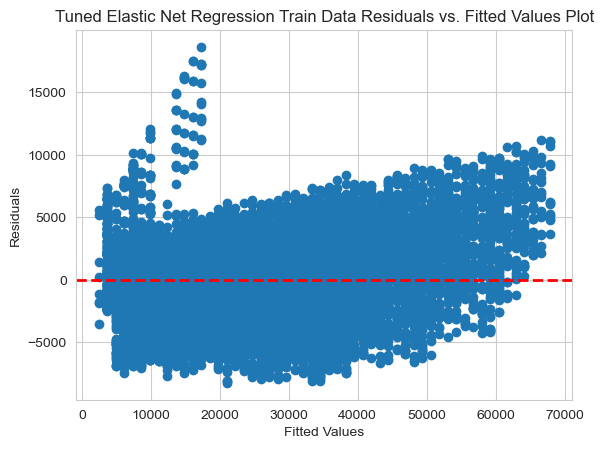

In [287]:
## Residual plot-train Data
residuals = y_train - best_en_model_pred_train

plt.scatter(y_train, residuals)
plt.axhline(y=0, color='r', linestyle='--', linewidth=2)
plt.xlabel('Fitted Values')
plt.ylabel('Residuals')
plt.title('Tuned Elastic Net Regression Train Data Residuals vs. Fitted Values Plot')
plt.show()

In [288]:
print('\nTest Data Performance\n')
print('RMSE=',np.sqrt(mse(y_test,best_en_model_pred_test)))
print('MAE=',mae(y_test,best_en_model_pred_test))
print('MAPE=',mape(y_test,best_en_model_pred_test))


Test Data Performance

RMSE= 3353.4063035774843
MAE= 2705.271845872306
MAPE= 0.14955690125434407


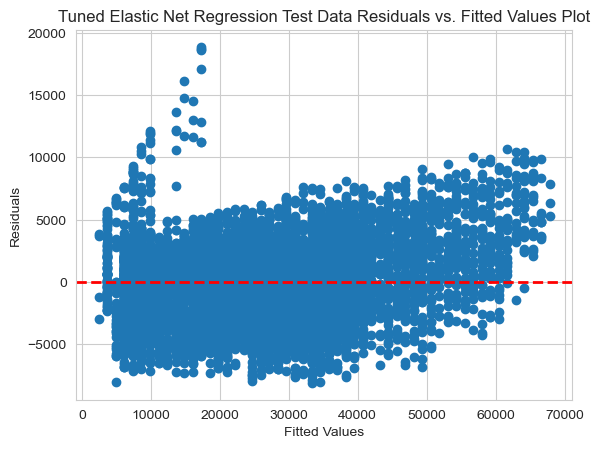

In [289]:
## Residual plot-Test Data
residuals = y_test - best_en_model_pred_test

plt.scatter(y_test, residuals)
plt.axhline(y=0, color='r', linestyle='--', linewidth=2)
plt.xlabel('Fitted Values')
plt.ylabel('Residuals')
plt.title('Tuned Elastic Net Regression Test Data Residuals vs. Fitted Values Plot')
plt.show()

In [290]:
best_en_model_RMSE_test=round(np.sqrt(mse(y_test,best_en_model_pred_test)),2)
best_en_model_MAE_test=round(mae(y_test,best_en_model_pred_test),2)
best_en_model_MAPE_test=round(mape(y_test,best_en_model_pred_test),2)
best_en_model_rsq_test=round(best_en_model.score(X_test,y_test),2)

In [291]:
results_df_best_en_model=pd.DataFrame({'RMSE':best_en_model_RMSE_test, 'MAE': best_en_model_MAE_test, 'MAPE': best_en_model_MAPE_test, 'R^2': best_en_model_rsq_test},index=['TunedENRegression'])
results_df_best_en_model

,RMSE,MAE,MAPE,R^2
TunedENRegression,3353.41,2705.27,0.15,0.94


In [292]:
results_df=pd.concat([results_df,results_df_best_en_model],ignore_index=False)
results_df

,RMSE,MAE,MAPE,R^2
LinearRegression,3353.28,2705.05,0.15,0.94
RidgeRegression,3353.29,2705.04,0.15,0.94
TunedRidgeRegression,3353.32,2705.00,0.15,0.94
LassoRegression,3353.28,2705.05,0.15,0.94
TunedLassoRegression,3353.41,2705.27,0.15,0.94
LDA,3331.49,2572.85,0.12,0.17
ElasticNetRegression,5786.39,4631.28,0.27,0.84
TunedENRegression,3353.41,2705.27,0.15,0.94


## Non-Parametric Regression

### Random Forest

In [293]:
from sklearn.ensemble import RandomForestRegressor

In [294]:
rf_model=RandomForestRegressor(random_state=100)
rf_model.fit(X_train,y_train)

RandomForestRegressor(random_state=100)

In [295]:
rf_model_pred_train=rf_model.predict(X_train)
rf_model_pred_test=rf_model.predict(X_test)

In [296]:
print('\nTrain Data Performance\n')
print('RMSE=',np.sqrt(mse(y_train,rf_model_pred_train)))
print('MAE=',mae(y_train,rf_model_pred_train))
print('MAPE=',mape(y_train,rf_model_pred_train))
print('R sq= ', rf_model.score(X_train,y_train))


Train Data Performance

RMSE= 1173.320995448255
MAE= 931.7004700422443
MAPE= 0.04586292559102893
R sq=  0.9933112747708999


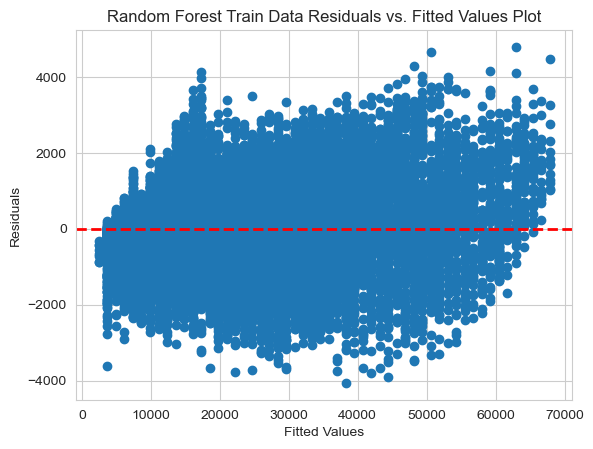

In [297]:
## Residual plot-train Data
residuals = y_train - rf_model_pred_train

plt.scatter(y_train, residuals)
plt.axhline(y=0, color='r', linestyle='--', linewidth=2)
plt.xlabel('Fitted Values')
plt.ylabel('Residuals')
plt.title('Random Forest Train Data Residuals vs. Fitted Values Plot')
plt.show()

In [298]:
print('\nTest Data Performance\n')
print('RMSE=',np.sqrt(mse(y_test,rf_model_pred_test)))
print('MAE=',mae(y_test,rf_model_pred_test))
print('MAPE=',mape(y_test,rf_model_pred_test))


Test Data Performance

RMSE= 3111.3145139027993
MAE= 2499.7262890462307
MAPE= 0.12202659195367004


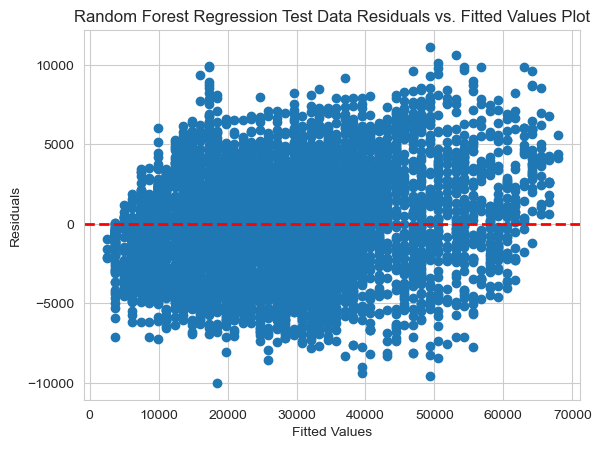

In [299]:
## Residual plot-Test Data
residuals = y_test - rf_model_pred_test

plt.scatter(y_test, residuals)
plt.axhline(y=0, color='r', linestyle='--', linewidth=2)
plt.xlabel('Fitted Values')
plt.ylabel('Residuals')
plt.title('Random Forest Regression Test Data Residuals vs. Fitted Values Plot')
plt.show()

In [300]:
rf_model_RMSE_test=round(np.sqrt(mse(y_test,rf_model_pred_test)),2)
rf_model_MAE_test=round(mae(y_test,rf_model_pred_test),2)
rf_model_MAPE_test=round(mape(y_test,rf_model_pred_test),2)
rf_model_rsq_test=round(rf_model.score(X_test,y_test),2)

In [301]:
results_df_rf_model=pd.DataFrame({'RMSE':rf_model_RMSE_test, 'MAE': rf_model_MAE_test, 'MAPE': rf_model_MAPE_test, 'R^2': rf_model_rsq_test},index=['RandomForestRegression'])
results_df_rf_model

,RMSE,MAE,MAPE,R^2
RandomForestRegression,3111.31,2499.73,0.12,0.95


In [302]:
results_df=pd.concat([results_df,results_df_rf_model],ignore_index=False)
results_df

,RMSE,MAE,MAPE,R^2
LinearRegression,3353.28,2705.05,0.15,0.94
RidgeRegression,3353.29,2705.04,0.15,0.94
TunedRidgeRegression,3353.32,2705.00,0.15,0.94
LassoRegression,3353.28,2705.05,0.15,0.94
TunedLassoRegression,3353.41,2705.27,0.15,0.94
LDA,3331.49,2572.85,0.12,0.17
ElasticNetRegression,5786.39,4631.28,0.27,0.84
TunedENRegression,3353.41,2705.27,0.15,0.94
RandomForestRegression,3111.31,2499.73,0.12,0.95


#### Tuned Random Forest Model

In [303]:
from sklearn.model_selection import RandomizedSearchCV

In [304]:
rf_params={
    'n_estimators': [100,300,500],
    'max_depth': [5,15],
    'min_samples_split' : [2,5,10],
    'min_samples_leaf' : [2,5,10],
   }

In [305]:
rf_grid_search = RandomizedSearchCV(RandomForestRegressor(random_state=100), param_distributions=rf_params, cv=5,n_iter=10, scoring='neg_mean_squared_error',random_state=100)
rf_grid_search.fit(X_train, y_train)

RandomizedSearchCV(cv=5, estimator=RandomForestRegressor(random_state=100),
                   param_distributions={'max_depth': [5, 15],
                                        'min_samples_leaf': [2, 5, 10],
                                        'min_samples_split': [2, 5, 10],
                                        'n_estimators': [100, 300, 500]},
                   random_state=100, scoring='neg_mean_squared_error')

In [306]:
best_rf_params=rf_grid_search.best_params_
best_rf_params

{'n_estimators': 500,
 'min_samples_split': 2,
 'min_samples_leaf': 10,
 'max_depth': 15}

In [307]:
best_rf_model=RandomForestRegressor(n_estimators=500,min_samples_split=2,min_samples_leaf=10,max_depth=15,random_state=100)
best_rf_model.fit(X_train,y_train)

RandomForestRegressor(max_depth=15, min_samples_leaf=10, n_estimators=500,
                      random_state=100)

In [308]:
best_rf_model_pred_train=best_rf_model.predict(X_train)
best_rf_model_pred_test=best_rf_model.predict(X_test)

In [309]:
print('\nTrain Data Performance\n')
print('RMSE=',np.sqrt(mse(y_train,best_rf_model_pred_train)))
print('MAE=',mae(y_train,best_rf_model_pred_train))
print('MAPE=',mape(y_train,best_rf_model_pred_train))
print('R sq= ', best_rf_model.score(X_train,y_train))


Train Data Performance

RMSE= 2482.1719266082114
MAE= 1980.0220053480052
MAPE= 0.09720112998564916
R sq=  0.970065404744303


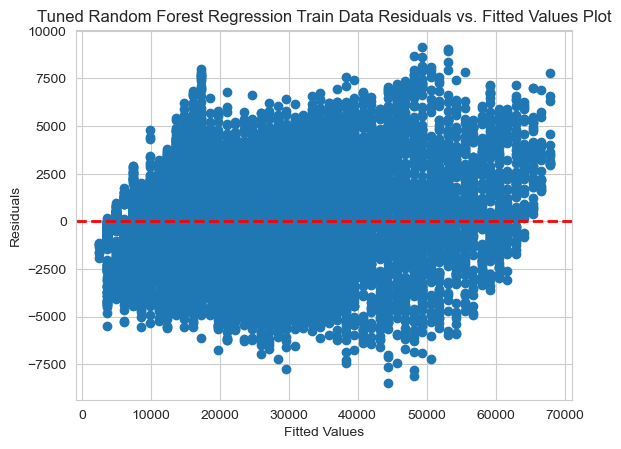

In [310]:
## Residual plot-train Data
residuals = y_train - best_rf_model_pred_train

plt.scatter(y_train, residuals)
plt.axhline(y=0, color='r', linestyle='--', linewidth=2)
plt.xlabel('Fitted Values')
plt.ylabel('Residuals')
plt.title('Tuned Random Forest Regression Train Data Residuals vs. Fitted Values Plot')
plt.show()

In [311]:
print('\nTest Data Performance\n')
print('RMSE=',np.sqrt(mse(y_test,best_rf_model_pred_test)))
print('MAE=',mae(y_test,best_rf_model_pred_test))
print('MAPE=',mape(y_test,best_rf_model_pred_test))


Test Data Performance

RMSE= 3061.932740939627
MAE= 2462.1841975237116
MAPE= 0.11969844629994551


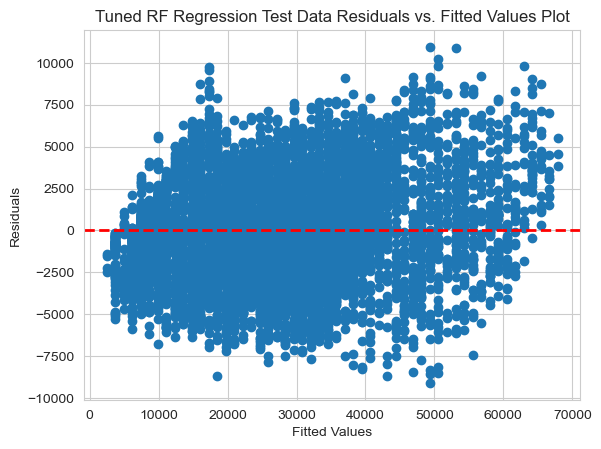

In [312]:
## Residual plot-Test Data
residuals = y_test - best_rf_model_pred_test

plt.scatter(y_test, residuals)
plt.axhline(y=0, color='r', linestyle='--', linewidth=2)
plt.xlabel('Fitted Values')
plt.ylabel('Residuals')
plt.title('Tuned RF Regression Test Data Residuals vs. Fitted Values Plot')
plt.show()

In [313]:
best_rf_model_RMSE_test=round(np.sqrt(mse(y_test,best_rf_model_pred_test)),2)
best_rf_model_MAE_test=round(mae(y_test,best_rf_model_pred_test),2)
best_rf_model_MAPE_test=round(mape(y_test,best_rf_model_pred_test),2)
best_rf_model_rsq_test=round(best_rf_model.score(X_test,y_test),2)

In [314]:
results_df_best_rf_model=pd.DataFrame({'RMSE':best_rf_model_RMSE_test, 'MAE': best_rf_model_MAE_test, 'MAPE': best_rf_model_MAPE_test, 'R^2': best_rf_model_rsq_test},index=['TunedRFRegression'])
results_df_best_rf_model

,RMSE,MAE,MAPE,R^2
TunedRFRegression,3061.93,2462.18,0.12,0.95


In [315]:
results_df=pd.concat([results_df,results_df_best_rf_model],ignore_index=False)
results_df

,RMSE,MAE,MAPE,R^2
LinearRegression,3353.28,2705.05,0.15,0.94
RidgeRegression,3353.29,2705.04,0.15,0.94
TunedRidgeRegression,3353.32,2705.00,0.15,0.94
LassoRegression,3353.28,2705.05,0.15,0.94
TunedLassoRegression,3353.41,2705.27,0.15,0.94
LDA,3331.49,2572.85,0.12,0.17
ElasticNetRegression,5786.39,4631.28,0.27,0.84
TunedENRegression,3353.41,2705.27,0.15,0.94
RandomForestRegression,3111.31,2499.73,0.12,0.95
TunedRFRegression,3061.93,2462.18,0.12,0.95


### SVM

In [316]:
from sklearn.svm import SVR

In [317]:
svm_model=SVR()
svm_model.fit(X_train,y_train)

SVR()

In [320]:
svm_model_pred_train=svm_model.predict(X_train)
svm_model_pred_test=svm_model.predict(X_test)

In [323]:
print('\nTrain Data Performance\n')
print('RMSE=',np.sqrt(mse(y_train,svm_model_pred_train)))
print('MAE=',mae(y_train,svm_model_pred_train))
print('MAPE=',mape(y_train,svm_model_pred_train))
print('R sq= ', svm_model.score(X_train,y_train))


Train Data Performance

RMSE= 14027.183961093895
MAE= 11593.08626677947
MAPE= 0.7867255971215882
R sq=  0.044015927014710465


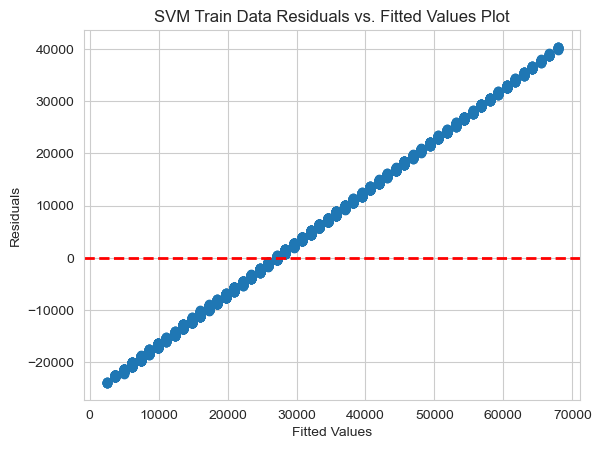

In [324]:
## Residual plot-train Data
residuals = y_train - svm_model_pred_train

plt.scatter(y_train, residuals)
plt.axhline(y=0, color='r', linestyle='--', linewidth=2)
plt.xlabel('Fitted Values')
plt.ylabel('Residuals')
plt.title('SVM Train Data Residuals vs. Fitted Values Plot')
plt.show()

In [325]:
print('\nTest Data Performance\n')
print('RMSE=',np.sqrt(mse(y_test,svm_model_pred_test)))
print('MAE=',mae(y_test,svm_model_pred_test))
print('MAPE=',mape(y_test,svm_model_pred_test))


Test Data Performance

RMSE= 13981.452767223489
MAE= 11491.701624159667
MAPE= 0.7662298772694808


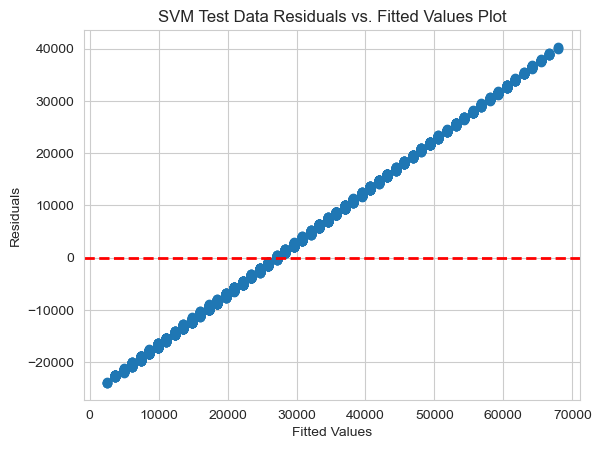

In [326]:
## Residual plot-Test Data
residuals = y_test - svm_model_pred_test

plt.scatter(y_test, residuals)
plt.axhline(y=0, color='r', linestyle='--', linewidth=2)
plt.xlabel('Fitted Values')
plt.ylabel('Residuals')
plt.title('SVM Test Data Residuals vs. Fitted Values Plot')
plt.show()

In [327]:
svm_model_RMSE_test=round(np.sqrt(mse(y_test,svm_model_pred_test)),2)
svm_model_MAE_test=round(mae(y_test,svm_model_pred_test),2)
svm_model_MAPE_test=round(mape(y_test,svm_model_pred_test),2)
svm_model_rsq_test=round(svm_model.score(X_test,y_test),2)

In [328]:
results_df_svm_model=pd.DataFrame({'RMSE':svm_model_RMSE_test, 'MAE': svm_model_MAE_test, 'MAPE': svm_model_MAPE_test, 'R^2': svm_model_rsq_test},index=['SVRegression'])
results_df_svm_model

,RMSE,MAE,MAPE,R^2
SVRegression,13981.45,11491.7,0.77,0.04


In [329]:
results_df=pd.concat([results_df,results_df_svm_model],ignore_index=False)
results_df

,RMSE,MAE,MAPE,R^2
LinearRegression,3353.28,2705.05,0.15,0.94
RidgeRegression,3353.29,2705.04,0.15,0.94
TunedRidgeRegression,3353.32,2705.00,0.15,0.94
LassoRegression,3353.28,2705.05,0.15,0.94
TunedLassoRegression,3353.41,2705.27,0.15,0.94
LDA,3331.49,2572.85,0.12,0.17
ElasticNetRegression,5786.39,4631.28,0.27,0.84
TunedENRegression,3353.41,2705.27,0.15,0.94
RandomForestRegression,3111.31,2499.73,0.12,0.95
TunedRFRegression,3061.93,2462.18,0.12,0.95


###  Ada Boost

In [330]:
from sklearn.ensemble import AdaBoostRegressor

In [331]:
ab_model=AdaBoostRegressor(random_state=100)
ab_model.fit(X_train,y_train)

AdaBoostRegressor(random_state=100)

In [332]:
ab_model_pred_train=ab_model.predict(X_train)
ab_model_pred_test=ab_model.predict(X_test)

In [333]:
print('\nTrain Data Performance\n')
print('RMSE=',np.sqrt(mse(y_train,ab_model_pred_train)))
print('MAE=',mae(y_train,ab_model_pred_train))
print('MAPE=',mape(y_train,ab_model_pred_train))
print('R sq= ', ab_model.score(X_train,y_train))


Train Data Performance

RMSE= 3284.2458234506257
MAE= 2717.8876767762085
MAPE= 0.16002342357503624
R sq=  0.9475940034197348


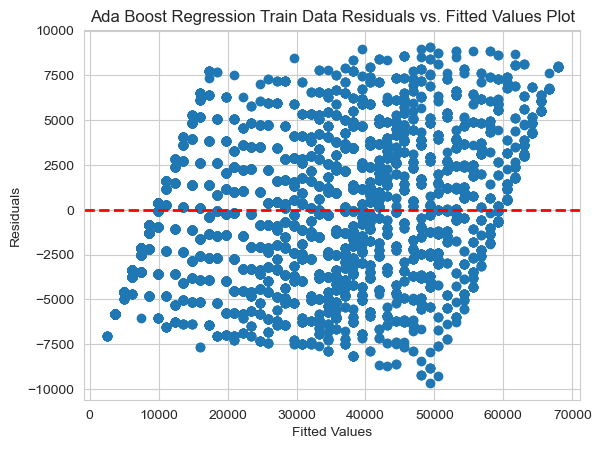

In [334]:
## Residual plot-train Data
residuals = y_train - ab_model_pred_train

plt.scatter(y_train, residuals)
plt.axhline(y=0, color='r', linestyle='--', linewidth=2)
plt.xlabel('Fitted Values')
plt.ylabel('Residuals')
plt.title('Ada Boost Regression Train Data Residuals vs. Fitted Values Plot')
plt.show()

In [335]:
print('\nTest Data Performance\n')
print('RMSE=',np.sqrt(mse(y_test,ab_model_pred_test)))
print('MAE=',mae(y_test,ab_model_pred_test))
print('MAPE=',mape(y_test,ab_model_pred_test))


Test Data Performance

RMSE= 3259.4255611993653
MAE= 2679.6413641188174
MAPE= 0.15401800278741318


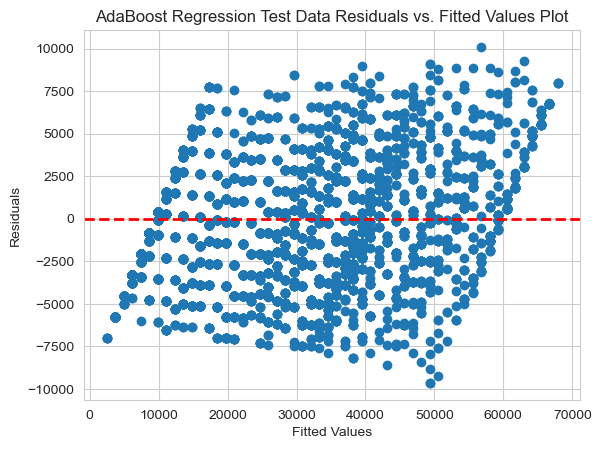

In [336]:
## Residual plot-Test Data
residuals = y_test - ab_model_pred_test

plt.scatter(y_test, residuals)
plt.axhline(y=0, color='r', linestyle='--', linewidth=2)
plt.xlabel('Fitted Values')
plt.ylabel('Residuals')
plt.title('AdaBoost Regression Test Data Residuals vs. Fitted Values Plot')
plt.show()

In [337]:
ab_model_RMSE_test=round(np.sqrt(mse(y_test,ab_model_pred_test)),2)
ab_model_MAE_test=round(mae(y_test,ab_model_pred_test),2)
ab_model_MAPE_test=round(mape(y_test,ab_model_pred_test),2)
ab_model_rsq_test=round(ab_model.score(X_test,y_test),2)

In [338]:
results_df_ab_model=pd.DataFrame({'RMSE':ab_model_RMSE_test, 'MAE': ab_model_MAE_test, 'MAPE': ab_model_MAPE_test, 'R^2': ab_model_rsq_test},index=['AdaBoostRegression'])
results_df_ab_model

,RMSE,MAE,MAPE,R^2
AdaBoostRegression,3259.43,2679.64,0.15,0.95


In [339]:
results_df=pd.concat([results_df,results_df_ab_model],ignore_index=False)
results_df

,RMSE,MAE,MAPE,R^2
LinearRegression,3353.28,2705.05,0.15,0.94
RidgeRegression,3353.29,2705.04,0.15,0.94
TunedRidgeRegression,3353.32,2705.00,0.15,0.94
LassoRegression,3353.28,2705.05,0.15,0.94
TunedLassoRegression,3353.41,2705.27,0.15,0.94
LDA,3331.49,2572.85,0.12,0.17
ElasticNetRegression,5786.39,4631.28,0.27,0.84
TunedENRegression,3353.41,2705.27,0.15,0.94
RandomForestRegression,3111.31,2499.73,0.12,0.95
TunedRFRegression,3061.93,2462.18,0.12,0.95


#### Tuned Adaboost Regression

In [340]:
from sklearn.tree import DecisionTreeRegressor

In [341]:
ab_params={
    'n_estimators' : [50,100,200],
    'learning_rate' : [0.01,0.1,0.5]
}

In [342]:
ab_grid_search = GridSearchCV(AdaBoostRegressor(), param_grid=ab_params, cv=5, scoring='neg_mean_squared_error')
ab_grid_search.fit(X_train, y_train)

GridSearchCV(cv=5, estimator=AdaBoostRegressor(),
             param_grid={'learning_rate': [0.01, 0.1, 0.5],
                         'n_estimators': [50, 100, 200]},
             scoring='neg_mean_squared_error')

In [343]:
best_ab_params=ab_grid_search.best_params_
best_ab_params

{'learning_rate': 0.1, 'n_estimators': 100}

In [344]:
best_ab_model=AdaBoostRegressor(learning_rate=0.1,n_estimators=100,random_state=100)
best_ab_model.fit(X_train,y_train)

AdaBoostRegressor(learning_rate=0.1, n_estimators=100, random_state=100)

In [345]:
best_ab_model_pred_train=best_ab_model.predict(X_train)
best_ab_model_pred_test=best_ab_model.predict(X_test)

In [346]:
print('\nTrain Data Performance\n')
print('RMSE=',np.sqrt(mse(y_train,best_ab_model_pred_train)))
print('MAE=',mae(y_train,best_ab_model_pred_train))
print('MAPE=',mape(y_train,best_ab_model_pred_train))
print('R sq= ', best_ab_model.score(X_train,y_train))


Train Data Performance

RMSE= 3233.597371237191
MAE= 2630.264049632446
MAPE= 0.14432926590347653
R sq=  0.9491979125431398


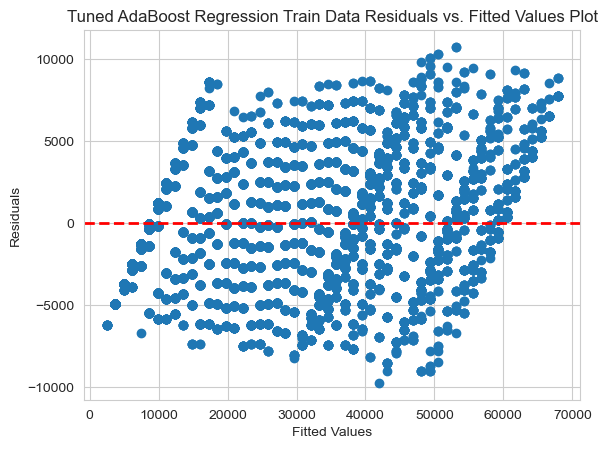

In [347]:
## Residual plot-train Data
residuals = y_train - best_ab_model_pred_train

plt.scatter(y_train, residuals)
plt.axhline(y=0, color='r', linestyle='--', linewidth=2)
plt.xlabel('Fitted Values')
plt.ylabel('Residuals')
plt.title('Tuned AdaBoost Regression Train Data Residuals vs. Fitted Values Plot')
plt.show()

In [348]:
print('\nTest Data Performance\n')
print('RMSE=',np.sqrt(mse(y_test,best_ab_model_pred_test)))
print('MAE=',mae(y_test,best_ab_model_pred_test))
print('MAPE=',mape(y_test,best_ab_model_pred_test))


Test Data Performance

RMSE= 3219.2123284337385
MAE= 2600.6473668756526
MAPE= 0.13889323189418606


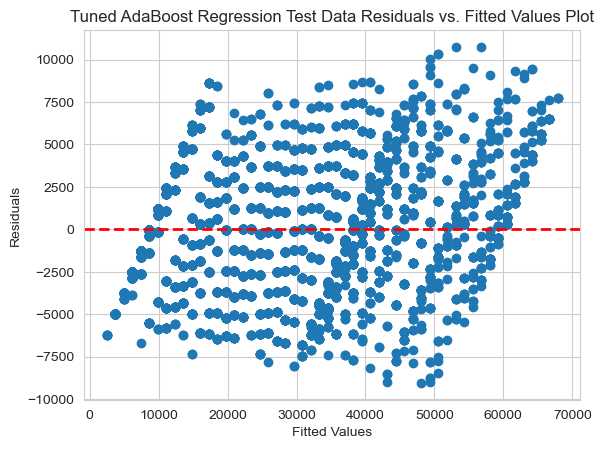

In [349]:
## Residual plot-Test Data
residuals = y_test - best_ab_model_pred_test

plt.scatter(y_test, residuals)
plt.axhline(y=0, color='r', linestyle='--', linewidth=2)
plt.xlabel('Fitted Values')
plt.ylabel('Residuals')
plt.title('Tuned AdaBoost Regression Test Data Residuals vs. Fitted Values Plot')
plt.show()

In [350]:
best_ab_model_RMSE_test=round(np.sqrt(mse(y_test,best_ab_model_pred_test)),2)
best_ab_model_MAE_test=round(mae(y_test,best_ab_model_pred_test),2)
best_ab_model_MAPE_test=round(mape(y_test,best_ab_model_pred_test),2)
best_ab_model_rsq_test=round(best_ab_model.score(X_test,y_test),2)

In [351]:
results_df_best_ab_model=pd.DataFrame({'RMSE':best_ab_model_RMSE_test, 'MAE': best_ab_model_MAE_test, 'MAPE': best_ab_model_MAPE_test, 'R^2': best_ab_model_rsq_test},index=['TunedABRegression'])
results_df_best_ab_model

,RMSE,MAE,MAPE,R^2
TunedABRegression,3219.21,2600.65,0.14,0.95


In [352]:
results_df=pd.concat([results_df,results_df_best_ab_model],ignore_index=False)
results_df

,RMSE,MAE,MAPE,R^2
LinearRegression,3353.28,2705.05,0.15,0.94
RidgeRegression,3353.29,2705.04,0.15,0.94
TunedRidgeRegression,3353.32,2705.00,0.15,0.94
LassoRegression,3353.28,2705.05,0.15,0.94
TunedLassoRegression,3353.41,2705.27,0.15,0.94
LDA,3331.49,2572.85,0.12,0.17
ElasticNetRegression,5786.39,4631.28,0.27,0.84
TunedENRegression,3353.41,2705.27,0.15,0.94
RandomForestRegression,3111.31,2499.73,0.12,0.95
TunedRFRegression,3061.93,2462.18,0.12,0.95


### Gradient Boost

In [353]:
from sklearn.ensemble import GradientBoostingRegressor

In [354]:
gb_model=GradientBoostingRegressor(random_state=100)
gb_model.fit(X_train,y_train)

GradientBoostingRegressor(random_state=100)

In [355]:
gb_model_pred_train=gb_model.predict(X_train)
gb_model_pred_test=gb_model.predict(X_test)

In [356]:
print('\nTrain Data Performance\n')
print('RMSE=',np.sqrt(mse(y_train,gb_model_pred_train)))
print('MAE=',mae(y_train,gb_model_pred_train))
print('MAPE=',mape(y_train,gb_model_pred_train))
print('R sq= ', gb_model.score(X_train,y_train))


Train Data Performance

RMSE= 2992.4790508223687
MAE= 2416.0437329444694
MAPE= 0.12073977274365479
R sq=  0.9564917205698518


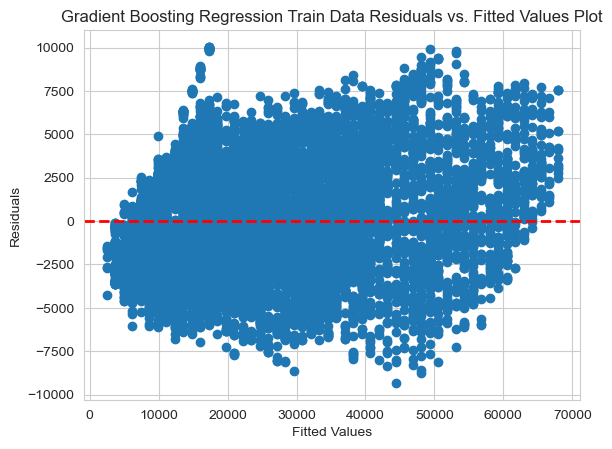

In [357]:
## Residual plot-train Data
residuals = y_train - gb_model_pred_train

plt.scatter(y_train, residuals)
plt.axhline(y=0, color='r', linestyle='--', linewidth=2)
plt.xlabel('Fitted Values')
plt.ylabel('Residuals')
plt.title('Gradient Boosting Regression Train Data Residuals vs. Fitted Values Plot')
plt.show()

In [358]:
print('\nTest Data Performance\n')
print('RMSE=',np.sqrt(mse(y_test,gb_model_pred_test)))
print('MAE=',mae(y_test,gb_model_pred_test))
print('MAPE=',mape(y_test,gb_model_pred_test))


Test Data Performance

RMSE= 3015.236801553485
MAE= 2434.9674926662988
MAPE= 0.12075691917326768


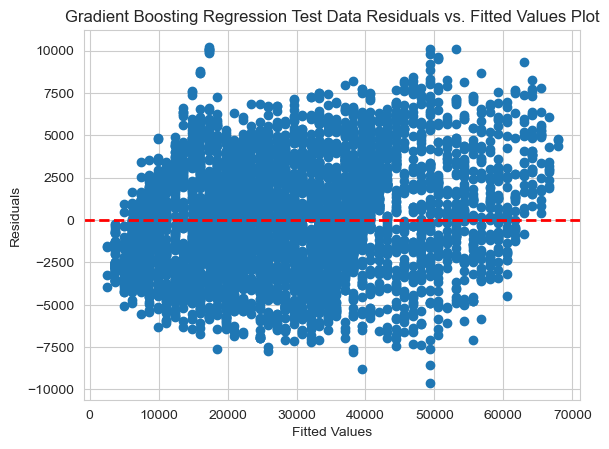

In [359]:
## Residual plot-Test Data
residuals = y_test - gb_model_pred_test

plt.scatter(y_test, residuals)
plt.axhline(y=0, color='r', linestyle='--', linewidth=2)
plt.xlabel('Fitted Values')
plt.ylabel('Residuals')
plt.title('Gradient Boosting Regression Test Data Residuals vs. Fitted Values Plot')
plt.show()

In [360]:
gb_model_RMSE_test=round(np.sqrt(mse(y_test,gb_model_pred_test)),2)
gb_model_MAE_test=round(mae(y_test,gb_model_pred_test),2)
gb_model_MAPE_test=round(mape(y_test,gb_model_pred_test),2)
gb_model_rsq_test=round(gb_model.score(X_test,y_test),2)

In [361]:
results_df_gb_model=pd.DataFrame({'RMSE':gb_model_RMSE_test, 'MAE': gb_model_MAE_test, 'MAPE': gb_model_MAPE_test, 'R^2': gb_model_rsq_test},index=['GradientBoostingRegression'])
results_df_gb_model

,RMSE,MAE,MAPE,R^2
GradientBoostingRegression,3015.24,2434.97,0.12,0.96


In [362]:
results_df=pd.concat([results_df,results_df_gb_model],ignore_index=False)
results_df

,RMSE,MAE,MAPE,R^2
LinearRegression,3353.28,2705.05,0.15,0.94
RidgeRegression,3353.29,2705.04,0.15,0.94
TunedRidgeRegression,3353.32,2705.00,0.15,0.94
LassoRegression,3353.28,2705.05,0.15,0.94
TunedLassoRegression,3353.41,2705.27,0.15,0.94
LDA,3331.49,2572.85,0.12,0.17
ElasticNetRegression,5786.39,4631.28,0.27,0.84
TunedENRegression,3353.41,2705.27,0.15,0.94
RandomForestRegression,3111.31,2499.73,0.12,0.95
TunedRFRegression,3061.93,2462.18,0.12,0.95


#### Tuned Gradient Boosting Regression

In [363]:
from sklearn.model_selection import RandomizedSearchCV

In [364]:
gb_params = {
    'n_estimators': [50, 100, 200],
    'learning_rate': [0.01, 0.1, 0.5],
    'max_depth': [3, 5, 7],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

In [365]:
gb_grid_search = RandomizedSearchCV(GradientBoostingRegressor(random_state=100), param_distributions=gb_params, cv=3,n_iter=10, scoring='neg_mean_squared_error',random_state=100)
gb_grid_search.fit(X_train, y_train)

RandomizedSearchCV(cv=3, estimator=GradientBoostingRegressor(random_state=100),
                   param_distributions={'learning_rate': [0.01, 0.1, 0.5],
                                        'max_depth': [3, 5, 7],
                                        'min_samples_leaf': [1, 2, 4],
                                        'min_samples_split': [2, 5, 10],
                                        'n_estimators': [50, 100, 200]},
                   random_state=100, scoring='neg_mean_squared_error')

In [366]:
best_gb_params=gb_grid_search.best_params_
best_gb_params

{'n_estimators': 50,
 'min_samples_split': 5,
 'min_samples_leaf': 1,
 'max_depth': 5,
 'learning_rate': 0.1}

In [367]:
best_gb_model=GradientBoostingRegressor(n_estimators= 50,min_samples_split= 5,min_samples_leaf= 1,max_depth= 5,learning_rate= 0.1,random_state=100)
best_gb_model.fit(X_train,y_train)

GradientBoostingRegressor(max_depth=5, min_samples_split=5, n_estimators=50,
                          random_state=100)

In [368]:
best_gb_model_pred_train=best_gb_model.predict(X_train)
best_gb_model_pred_test=best_gb_model.predict(X_test)

In [369]:
print('\nTrain Data Performance\n')
print('RMSE=',np.sqrt(mse(y_train,best_gb_model_pred_train)))
print('MAE=',mae(y_train,best_gb_model_pred_train))
print('MAPE=',mape(y_train,best_gb_model_pred_train))
print('R sq= ', best_gb_model.score(X_train,y_train))


Train Data Performance

RMSE= 2935.1926016321668
MAE= 2369.401886401499
MAPE= 0.1186822633460277
R sq=  0.9581415753320413


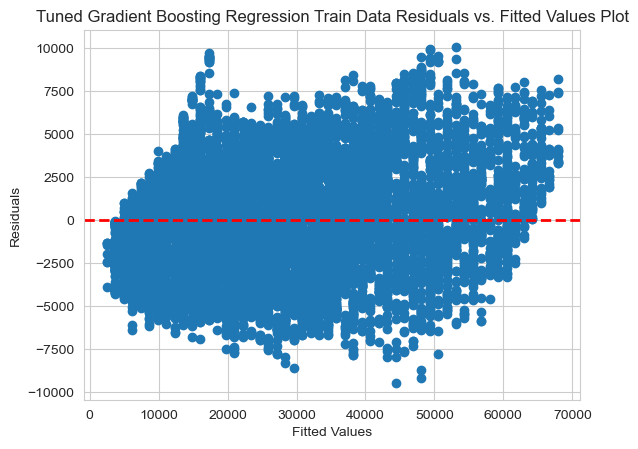

In [370]:
## Residual plot-train Data
residuals = y_train - best_gb_model_pred_train

plt.scatter(y_train, residuals)
plt.axhline(y=0, color='r', linestyle='--', linewidth=2)
plt.xlabel('Fitted Values')
plt.ylabel('Residuals')
plt.title('Tuned Gradient Boosting Regression Train Data Residuals vs. Fitted Values Plot')
plt.show()

In [371]:
print('\nTest Data Performance\n')
print('RMSE=',np.sqrt(mse(y_test,best_gb_model_pred_test)))
print('MAE=',mae(y_test,best_gb_model_pred_test))
print('MAPE=',mape(y_test,best_gb_model_pred_test))


Test Data Performance

RMSE= 3017.4706913469095
MAE= 2434.1839684998686
MAPE= 0.12101354588549622


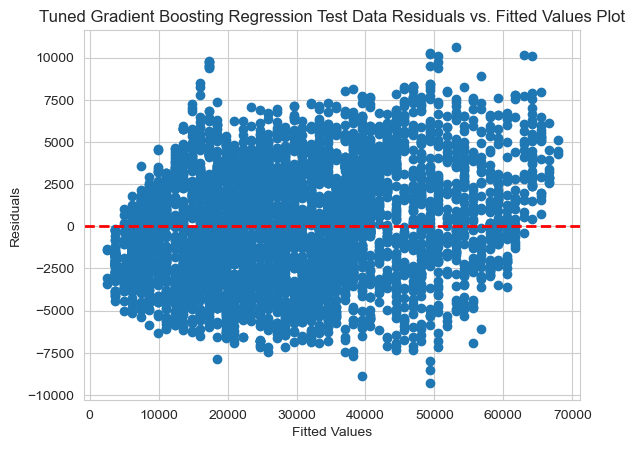

In [372]:
## Residual plot-Test Data
residuals = y_test - best_gb_model_pred_test

plt.scatter(y_test, residuals)
plt.axhline(y=0, color='r', linestyle='--', linewidth=2)
plt.xlabel('Fitted Values')
plt.ylabel('Residuals')
plt.title('Tuned Gradient Boosting Regression Test Data Residuals vs. Fitted Values Plot')
plt.show()

In [373]:
best_gb_model_RMSE_test=round(np.sqrt(mse(y_test,best_gb_model_pred_test)),2)
best_gb_model_MAE_test=round(mae(y_test,best_gb_model_pred_test),2)
best_gb_model_MAPE_test=round(mape(y_test,best_gb_model_pred_test),2)
best_gb_model_rsq_test=round(best_gb_model.score(X_test,y_test),2)

In [374]:
results_df_best_gb_model=pd.DataFrame({'RMSE':best_gb_model_RMSE_test, 'MAE': best_gb_model_MAE_test, 'MAPE': best_gb_model_MAPE_test, 'R^2': best_gb_model_rsq_test},index=['TunedGBRegression'])
results_df_best_gb_model

,RMSE,MAE,MAPE,R^2
TunedGBRegression,3017.47,2434.18,0.12,0.96


In [375]:
results_df=pd.concat([results_df,results_df_best_gb_model],ignore_index=False)
results_df

,RMSE,MAE,MAPE,R^2
LinearRegression,3353.28,2705.05,0.15,0.94
RidgeRegression,3353.29,2705.04,0.15,0.94
TunedRidgeRegression,3353.32,2705.00,0.15,0.94
LassoRegression,3353.28,2705.05,0.15,0.94
TunedLassoRegression,3353.41,2705.27,0.15,0.94
LDA,3331.49,2572.85,0.12,0.17
ElasticNetRegression,5786.39,4631.28,0.27,0.84
TunedENRegression,3353.41,2705.27,0.15,0.94
RandomForestRegression,3111.31,2499.73,0.12,0.95
TunedRFRegression,3061.93,2462.18,0.12,0.95


In [376]:
imp=best_gb_model.feature_importances_

In [377]:
features=X_train.columns

In [378]:
imp_df=pd.DataFrame(data=imp,index=features)

In [379]:
imp_df

,0
years_of_insurance_with_us,0.000434
regular_checkup_last_year,0.001880
cholesterol_level,0.000028
visited_doctor_last_1_year,0.000065
daily_avg_steps,0.000481
age,0.000340
avg_glucose_level,0.000405
bmi,0.000303
weight,0.993077
weight_change_in_last_one_year,0.000558


In [380]:
imp_df.to_excel('Importances.xlsx',index=True)

### XGB

In [381]:
import xgboost as xgb

In [382]:
xgbrf_model=xgb.XGBRFRegressor()
xgbrf_model.fit(X_train,y_train)

XGBRFRegressor(base_score=None, booster=None, callbacks=None,
               colsample_bylevel=None, colsample_bytree=None, device=None,
               early_stopping_rounds=None, enable_categorical=False,
               eval_metric=None, feature_types=None, gamma=None,
               grow_policy=None, importance_type=None,
               interaction_constraints=None, max_bin=None,
               max_cat_threshold=None, max_cat_to_onehot=None,
               max_delta_step=None, max_depth=None, max_leaves=None,
               min_child_weight=None, missing=nan, monotone_constraints=None,
               multi_strategy=None, n_estimators=None, n_jobs=None,
               num_parallel_tree=None, objective='reg:squarederror',
               random_state=None, reg_alpha=None, ...)

In [383]:
xgbrf_model_pred_train=xgbrf_model.predict(X_train)
xgbrf_model_pred_test=xgbrf_model.predict(X_test)

In [384]:
print('\nTrain Data Performance\n')
print('RMSE=',np.sqrt(mse(y_train,xgbrf_model_pred_train)))
print('MAE=',mae(y_train,xgbrf_model_pred_train))
print('MAPE=',mape(y_train,xgbrf_model_pred_train))
print('R sq= ', xgbrf_model.score(X_train,y_train))


Train Data Performance

RMSE= 3019.6603363890517
MAE= 2429.632585921463
MAPE= 0.12044140866315073
R sq=  0.9556977421369393


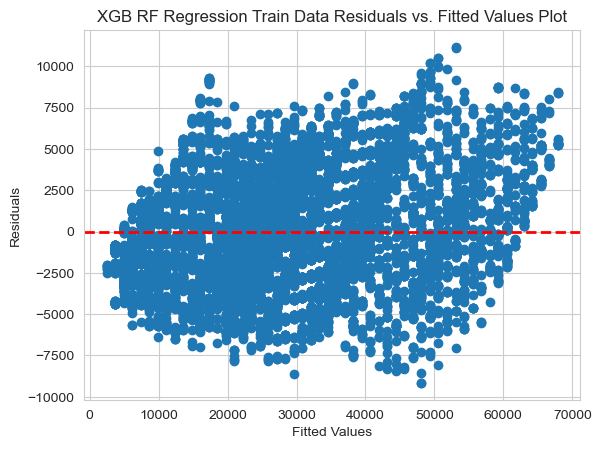

In [385]:
## Residual plot-train Data
residuals = y_train - xgbrf_model_pred_train

plt.scatter(y_train, residuals)
plt.axhline(y=0, color='r', linestyle='--', linewidth=2)
plt.xlabel('Fitted Values')
plt.ylabel('Residuals')
plt.title('XGB RF Regression Train Data Residuals vs. Fitted Values Plot')
plt.show()

In [386]:
print('\nTest Data Performance\n')
print('RMSE=',np.sqrt(mse(y_test,xgbrf_model_pred_test)))
print('MAE=',mae(y_test,xgbrf_model_pred_test))
print('MAPE=',mape(y_test,xgbrf_model_pred_test))


Test Data Performance

RMSE= 3045.5530051301544
MAE= 2452.2067488427133
MAPE= 0.12069590499054655


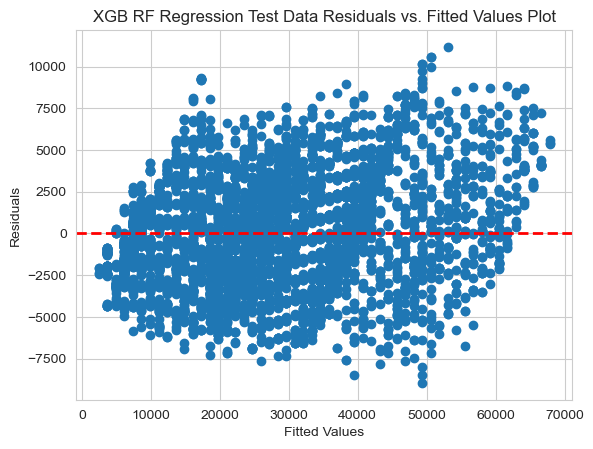

In [387]:
## Residual plot-Test Data
residuals = y_test - xgbrf_model_pred_test

plt.scatter(y_test, residuals)
plt.axhline(y=0, color='r', linestyle='--', linewidth=2)
plt.xlabel('Fitted Values')
plt.ylabel('Residuals')
plt.title('XGB RF Regression Test Data Residuals vs. Fitted Values Plot')
plt.show()

In [388]:
xgbrf_model_RMSE_test=round(np.sqrt(mse(y_test,xgbrf_model_pred_test)),2)
xgbrf_model_MAE_test=round(mae(y_test,xgbrf_model_pred_test),2)
xgbrf_model_MAPE_test=round(mape(y_test,xgbrf_model_pred_test),2)
xgbrf_model_rsq_test=round(xgbrf_model.score(X_test,y_test),2)

In [389]:
results_df_xgbrf_model=pd.DataFrame({'RMSE':xgbrf_model_RMSE_test, 'MAE': xgbrf_model_MAE_test, 'MAPE': xgbrf_model_MAPE_test, 'R^2': xgbrf_model_rsq_test},index=['XGBRFRegression'])
results_df_xgbrf_model

,RMSE,MAE,MAPE,R^2
XGBRFRegression,3045.55,2452.21,0.12,0.95


In [390]:
results_df=pd.concat([results_df,results_df_xgbrf_model],ignore_index=False)
results_df

,RMSE,MAE,MAPE,R^2
LinearRegression,3353.28,2705.05,0.15,0.94
RidgeRegression,3353.29,2705.04,0.15,0.94
TunedRidgeRegression,3353.32,2705.00,0.15,0.94
LassoRegression,3353.28,2705.05,0.15,0.94
TunedLassoRegression,3353.41,2705.27,0.15,0.94
LDA,3331.49,2572.85,0.12,0.17
ElasticNetRegression,5786.39,4631.28,0.27,0.84
TunedENRegression,3353.41,2705.27,0.15,0.94
RandomForestRegression,3111.31,2499.73,0.12,0.95
TunedRFRegression,3061.93,2462.18,0.12,0.95


#### Tuned XGBRF Regression

In [391]:
from scipy.stats import randint

In [392]:
xgbrf_params = {
    'n_estimators': [50,100,200],
    'learning_rate': [0.001, 0.01, 0.1, 0.2, 0.3],
    'max_depth': [3,6,9],
    'subsample': np.linspace(0.5, 1.0, 5),
    'colsample_bytree': np.linspace(0.5, 1.0, 5),
    'colsample_bynode': np.linspace(0.5, 1.0, 5),
    'min_child_weight': [1,7,10],
    'gamma': [0, 0.1, 0.2, 0.3, 0.4],
}

In [393]:
xgbrf_grid_search = RandomizedSearchCV(xgb.XGBRFRegressor(random_state=100), param_distributions=xgbrf_params, cv=5,n_iter=20, scoring='neg_mean_squared_error',random_state=123)
xgbrf_grid_search.fit(X_train, y_train)

RandomizedSearchCV(cv=5,
                   estimator=XGBRFRegressor(base_score=None, booster=None,
                                            callbacks=None,
                                            colsample_bylevel=None,
                                            colsample_bytree=None, device=None,
                                            early_stopping_rounds=None,
                                            enable_categorical=False,
                                            eval_metric=None,
                                            feature_types=None, gamma=None,
                                            grow_policy=None,
                                            importance_type=None,
                                            interaction_constraints=None,
                                            max_bin=None,
                                            max_cat_threshold=Non...
                   param_distributions={'colsample_bynode': array([0.5  , 0.625, 0.75 , 0.875, 1.   ]),
                                        'colsample_bytree': array([0.5  , 0.625, 0.75 , 0.875, 1.   ]),
                                        'gamma': [0, 0.1, 0.2, 0.3, 0.4],
                                        'learning_rate': [0.001, 0.01, 0.1, 0.2,
                                                          0.3],
                                        'max_depth': [3, 6, 9],
                                        'min_child_weight': [1, 7, 10],
                                        'n_estimators': [50, 100, 200],
                                        'subsample': array([0.5  , 0.625, 0.75 , 0.875, 1.   ])},
                   random_state=123, scoring='neg_mean_squared_error')

In [394]:
best_xgbrf_params=xgbrf_grid_search.best_params_
best_xgbrf_params

{'subsample': 0.75,
 'n_estimators': 50,
 'min_child_weight': 10,
 'max_depth': 9,
 'learning_rate': 0.3,
 'gamma': 0.2,
 'colsample_bytree': 1.0,
 'colsample_bynode': 1.0}

In [395]:
best_xgbrf_model=xgb.XGBRFRegressor(  subsample = 0.75,
  n_estimators = 50,
  min_child_weight = 10,
  max_depth = 9,
  learning_rate = 0.3,
  gamma = 0.2,
  colsample_bytree = 1,
  colsample_bynode = 1, random_state=100)
best_xgbrf_model.fit(X_train,y_train)

XGBRFRegressor(base_score=None, booster=None, callbacks=None,
               colsample_bylevel=None, colsample_bynode=1, colsample_bytree=1,
               device=None, early_stopping_rounds=None,
               enable_categorical=False, eval_metric=None, feature_types=None,
               gamma=0.2, grow_policy=None, importance_type=None,
               interaction_constraints=None, learning_rate=0.3, max_bin=None,
               max_cat_threshold=None, max_cat_to_onehot=None,
               max_delta_step=None, max_depth=9, max_leaves=None,
               min_child_weight=10, missing=nan, monotone_constraints=None,
               multi_strategy=None, n_estimators=50, n_jobs=None,
               num_parallel_tree=None, objective='reg:squarederror', ...)

In [396]:
best_xgbrf_model_pred_train=best_xgbrf_model.predict(X_train)
best_xgbrf_model_pred_test=best_xgbrf_model.predict(X_test)

In [397]:
print('\nTrain Data Performance\n')
print('RMSE=',np.sqrt(mse(y_train,best_xgbrf_model_pred_train)))
print('MAE=',mae(y_train,best_xgbrf_model_pred_train))
print('MAPE=',mape(y_train,best_xgbrf_model_pred_train))
print('R sq= ', best_xgbrf_model.score(X_train,y_train))


Train Data Performance

RMSE= 10246.342264626044
MAE= 8453.680262153604
MAPE= 0.5766438987362061
R sq=  0.48990931924569914


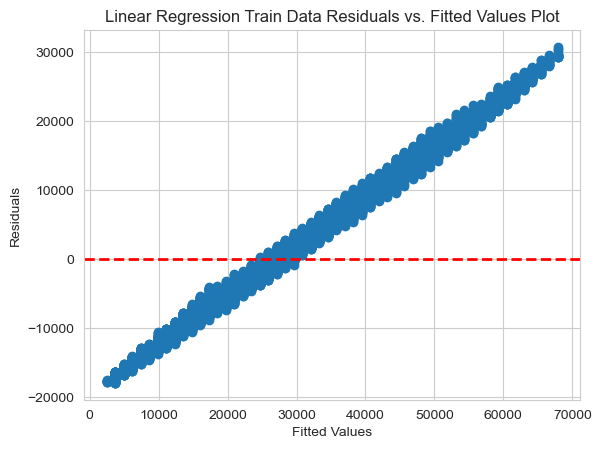

In [398]:
## Residual plot-train Data
residuals = y_train - best_xgbrf_model_pred_train

plt.scatter(y_train, residuals)
plt.axhline(y=0, color='r', linestyle='--', linewidth=2)
plt.xlabel('Fitted Values')
plt.ylabel('Residuals')
plt.title('Linear Regression Train Data Residuals vs. Fitted Values Plot')
plt.show()

In [399]:
print('\nTest Data Performance\n')
print('RMSE=',np.sqrt(mse(y_test,best_xgbrf_model_pred_test)))
print('MAE=',mae(y_test,best_xgbrf_model_pred_test))
print('MAPE=',mape(y_test,best_xgbrf_model_pred_test))


Test Data Performance

RMSE= 10242.479816039448
MAE= 8393.3195974659
MAPE= 0.5625138149735173


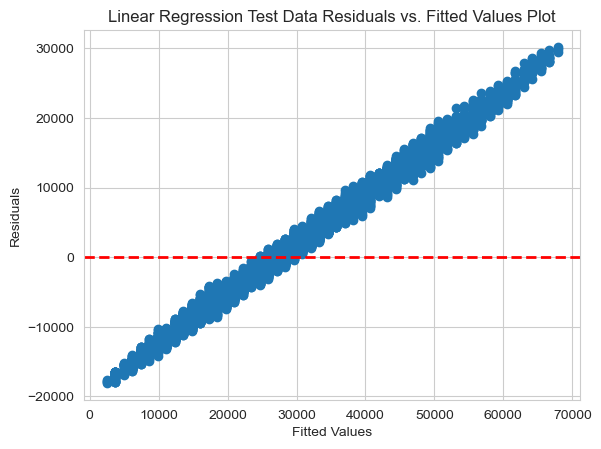

In [400]:
## Residual plot-Test Data
residuals = y_test - best_xgbrf_model_pred_test

plt.scatter(y_test, residuals)
plt.axhline(y=0, color='r', linestyle='--', linewidth=2)
plt.xlabel('Fitted Values')
plt.ylabel('Residuals')
plt.title('Linear Regression Test Data Residuals vs. Fitted Values Plot')
plt.show()

In [401]:
best_xgbrf_model_RMSE_test=round(np.sqrt(mse(y_test,best_xgbrf_model_pred_test)),2)
best_xgbrf_model_MAE_test=round(mae(y_test,best_xgbrf_model_pred_test),2)
best_xgbrf_model_MAPE_test=round(mape(y_test,best_xgbrf_model_pred_test),2)
best_xgbrf_model_rsq_test=round(best_xgbrf_model.score(X_test,y_test),2)

In [402]:
results_df_best_xgbrf_model=pd.DataFrame({'RMSE':best_xgbrf_model_RMSE_test, 'MAE': best_xgbrf_model_MAE_test, 'MAPE': best_xgbrf_model_MAPE_test, 'R^2': best_xgbrf_model_rsq_test},index=['TunedxgbrfRegression'])
results_df_best_xgbrf_model

,RMSE,MAE,MAPE,R^2
TunedxgbrfRegression,10242.48,8393.32,0.56,0.49


In [403]:
results_df=pd.concat([results_df,results_df_best_xgbrf_model],ignore_index=False)
results_df

,RMSE,MAE,MAPE,R^2
LinearRegression,3353.28,2705.05,0.15,0.94
RidgeRegression,3353.29,2705.04,0.15,0.94
TunedRidgeRegression,3353.32,2705.00,0.15,0.94
LassoRegression,3353.28,2705.05,0.15,0.94
TunedLassoRegression,3353.41,2705.27,0.15,0.94
LDA,3331.49,2572.85,0.12,0.17
ElasticNetRegression,5786.39,4631.28,0.27,0.84
TunedENRegression,3353.41,2705.27,0.15,0.94
RandomForestRegression,3111.31,2499.73,0.12,0.95
TunedRFRegression,3061.93,2462.18,0.12,0.95


### kNN Regression

In [404]:
from sklearn.neighbors import KNeighborsRegressor

In [405]:
knn_model=KNeighborsRegressor()
knn_model.fit(X_train,y_train)

KNeighborsRegressor()

In [406]:
knn_model_pred_train=knn_model.predict(X_train)
knn_model_pred_test=knn_model.predict(X_test)

In [409]:
print('\nTrain Data Performance\n')
print('RMSE=',np.sqrt(mse(y_train,knn_model_pred_train)))
print('MAE=',mae(y_train,knn_model_pred_train))
print('MAPE=',mape(y_train,knn_model_pred_train))
print('R sq= ', knn_model.score(X_train,y_train))


Train Data Performance

RMSE= 5173.402231452844
MAE= 4072.354185755935
MAPE= 0.22023320520075185
R sq=  0.8699644305936358


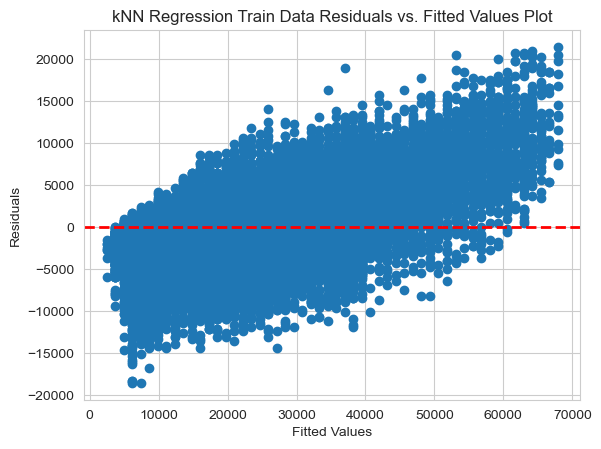

In [410]:
## Residual plot-train Data
residuals = y_train - knn_model_pred_train

plt.scatter(y_train, residuals)
plt.axhline(y=0, color='r', linestyle='--', linewidth=2)
plt.xlabel('Fitted Values')
plt.ylabel('Residuals')
plt.title('kNN Regression Train Data Residuals vs. Fitted Values Plot')
plt.show()

In [411]:
print('\nTest Data Performance\n')
print('RMSE=',np.sqrt(mse(y_test,knn_model_pred_test)))
print('MAE=',mae(y_test,knn_model_pred_test))
print('MAPE=',mape(y_test,knn_model_pred_test))


Test Data Performance

RMSE= 6274.122617837681
MAE= 4945.902151881161
MAPE= 0.2706243197352265


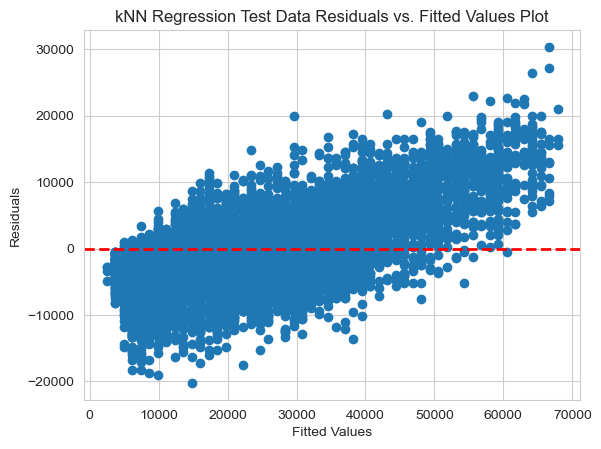

In [412]:
## Residual plot-Test Data
residuals = y_test - knn_model_pred_test

plt.scatter(y_test, residuals)
plt.axhline(y=0, color='r', linestyle='--', linewidth=2)
plt.xlabel('Fitted Values')
plt.ylabel('Residuals')
plt.title('kNN Regression Test Data Residuals vs. Fitted Values Plot')
plt.show()

In [413]:
knn_model_RMSE_test=round(np.sqrt(mse(y_test,knn_model_pred_test)),2)
knn_model_MAE_test=round(mae(y_test,knn_model_pred_test),2)
knn_model_MAPE_test=round(mape(y_test,knn_model_pred_test),2)
knn_model_rsq_test=round(knn_model.score(X_test,y_test),2)

In [414]:
results_df_knn_model=pd.DataFrame({'RMSE':knn_model_RMSE_test, 'MAE': knn_model_MAE_test, 'MAPE': knn_model_MAPE_test, 'R^2': knn_model_rsq_test},index=['kNNRegression'])
results_df_knn_model

,RMSE,MAE,MAPE,R^2
kNNRegression,6274.12,4945.9,0.27,0.81


In [415]:
results_df=pd.concat([results_df,results_df_knn_model],ignore_index=False)
results_df

,RMSE,MAE,MAPE,R^2
LinearRegression,3353.28,2705.05,0.15,0.94
RidgeRegression,3353.29,2705.04,0.15,0.94
TunedRidgeRegression,3353.32,2705.00,0.15,0.94
LassoRegression,3353.28,2705.05,0.15,0.94
TunedLassoRegression,3353.41,2705.27,0.15,0.94
LDA,3331.49,2572.85,0.12,0.17
ElasticNetRegression,5786.39,4631.28,0.27,0.84
TunedENRegression,3353.41,2705.27,0.15,0.94
RandomForestRegression,3111.31,2499.73,0.12,0.95
TunedRFRegression,3061.93,2462.18,0.12,0.95


In [416]:
results_df.to_excel('Results2.xlsx',index=True)